# Anomaly detection - Exercise

Sami BOUKEZZOULA

## Context

Aircraft systems are recording values of parameters such as speed, temperature, pressure, electrical current values... The studied dataset (in the file 'dataset.csv') contains 11 parameters recorded: p1, p2, p3, …, p11. More precisely, the dataset is composed of different windows, which are sections of measures of these parameters (up to 100 points by window). Each window is labeled by the parameter 'day_cycle_window' : for instance, the window, whose parameter 'day_cycle_window' is 4_2_1, represents the window 1 of the cycle 2 of the day 4.

*It is asked to "build an algorithm to detect windows that are abnormal".*

## Problem formulation

Analysis of the data provided shows that it is multivariate and temporal, with each “window” comprising up to 100 measurement points of the parameters recorded on each cycle and day. The aim is to detect **abnormal windows**, which means identifying **sets of measurements that differ stastically from the others**.

Indeed, without any more piece of information (among others what are the characteristics of "normal windows"), we can only compare their statiscal characteristics. Thus, in the following notebook, we will name *"anomalous windows"* or *"abnormal windows"* all the windows that have statiscal characteristics (mean, standard deviation, etc.) significantly different from the others (**under the hypothesis that there should be anomalies quite infrequently**).

As mentionned above, there are neither known examples of "normal windows" nor "abnormal windows". Therefore, it limits the use of supervised techniques, that requires a sample of labeled windows to perform supervised classification methods. This is the reason why only **unsupervised techniques** (such as MCD, Isolation Forest, One Class SVM or LOF) will be explored in this notebook. Additionnaly, **we will not be able to ensure wether the windows detected by these algorithms as different are "real anomalies" or not** : it must require a review from an expert that will be able to analize these windows. The same issue will happen when it comes to compute some performance metrics of these methods.

Finally, anomalies may be subtle to detect since there could be complex relationships between parameters (for example, certain temperature values may be normal if pressure is within a certain range, but abnormal otherwise). It is also not possible to take into account some natural variability : since actual flight conditions (temperature, speed, pressure) vary over time, it is difficult to detect anomalies simply by comparing raw values (or even their statistical characteristics).

As a conclusion, **we propose to use in this notebook unsupervised methods on statistical features characterizing the windows to detect "statistical anomalous windows"**

## Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

from sklearn.covariance import EllipticEnvelope
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM

## Reading data

In [2]:
### Reading the dataset
df = pd.read_csv("dataset.csv")

## Naive approach : characterize each window by the means of each parameters

A first approach consists in considering that each window can be represented by the means of each parameter. Thus we preprocess the data in order to work on a dataframe containing only these pieces of information.

### Data preprocessing

In [3]:
# Creating the dataframe 'df_means' containing the means of each parameters within each window

# Splitting 'day_cycle_window' into separate columns for day, cycle, and window
df[['day', 'cycle', 'window']] = df['day_cycle_window'].str.split('_', expand=True)

# Converting the new columns to integers for proper sorting and grouping
df[['day', 'cycle', 'window']] = df[['day', 'cycle', 'window']].astype(int)

# Calculating the mean of all parameters grouped by 'day_cycle_window'
df_means = df.groupby('day_cycle_window').mean().reset_index()

# Sorting the rows by day, cycle, and window to ensure proper sequential order
df_means = df_means.sort_values(by=['day', 'cycle', 'window']).reset_index(drop=True)

# Dropping 'day', 'cycle', and 'window' columns from the means dataframe (no longer needed for analysis)
df_means = df_means.drop(columns=['day', 'cycle', 'window'])

# Displaying the first few rows of the resulting dataframe
df_means.head


<bound method NDFrame.head of      day_cycle_window        p1        p2        p3        p4        p5  \
0               1_1_1 -1.926141 -2.456284 -2.487394 -2.481230 -2.388674   
1               1_1_2 -1.714067 -2.217161 -2.530537 -2.515985 -2.544961   
2               1_1_3 -1.534357 -1.779994 -1.938747 -1.835152 -2.053982   
3               1_1_4 -1.415197 -1.453962 -1.888438 -2.249327 -2.206560   
4               1_1_5 -0.732715 -0.634379 -0.963247 -1.871178 -2.048933   
...               ...       ...       ...       ...       ...       ...   
1632          4_4_156 -0.956537 -1.347865 -1.277796 -1.489708 -1.259816   
1633          4_4_157 -0.984032 -1.350121 -1.296572 -1.473924 -1.277888   
1634          4_4_158 -1.006301 -1.363260 -1.319295 -1.484471 -1.289714   
1635          4_4_159 -1.013992 -1.368401 -1.323755 -1.506278 -1.304717   
1636          4_4_160 -0.485387 -0.623397 -0.630989 -0.841035 -0.861749   

            p6        p7        p8        p9       p10       p11  
0 

In [4]:
# Global variables
colors = ['#FF0000','#FF8000','#FFFF00','#80FF00','#00FF80','#00FFFF','#0000FF','#7F00FF','#FF00FF','#FF007F','#000000']
parameters = ['p1','p2','p3','p4','p5','p6','p7','p8','p9','p10','p11']

In [4]:
def plot_time_series(df,param):
    """
    Plot the time series of the specified parameter.
    
    Parameters:
    df : DataFrame
        The dataframe containing the data, where 'day_cycle_window' specifies the windows,
        and each parameter column (e.g., 'p1', 'p2', ..., 'p11') contains the values to be plotted.
    param : str
        The parameter to plot (e.g., 'p1', 'p2', ..., 'p11').
    """
    fig, ax = plt.subplots()
    ax.scatter(df['day_cycle_window'],df[param],marker='.',c=colors[int(param[1:])-1])
    ax.set_xlabel('day_cycle_window')
    ax.set_ylabel(f"Average value of {param} by window")
    ax.set_xticks(df['day_cycle_window'][::100])
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [ ]:
# Visualize the time series of the means by window for each parameter
for k in range(1,12):
    plot_time_series(df_means,f'p{k}')

### 1st method : using the Minimum Covariance Determinant (MCD) method to determine an elliptic enveloppe

The **Minimum Covariance Determinant (MCD)** method is a **robust statistical approach** to detect anomalies by focusing on the core distribution of a dataset. It identifies a subset of the data that minimizes the determinant of its covariance matrix, effectively isolating the "central" points while excluding outliers.

Once the optimal subset is determined, the method computes the mean and covariance matrix of this subset. Using these statistics, the ***Mahalanobis distance*** of each point in the dataset is calculated, **measuring how far a point deviates from the center of the distribution**. Points with distances exceeding a predefined threshold are flagged as **anomalies**.

MCD is particularly effective in the presence of outliers, as it is resistant to their influence when estimating the central distribution.

#### Hyperparameter tuning

The Elliptic Envelope algorithm requires the tuning of the **contamination parameter**, which determines the expected proportion of anomalies in the dataset.

*Why These Contamination Values?*

The values [0.01, 0.05, 0.1] are chosen based on reasonable assumptions about the proportion of anomalies in typical datasets:
- 0.01 (1%): Suitable if anomalies are expected to be very rare, as in high-dimensional or controlled systems.
- 0.05 (5%): Commonly used as a general assumption for moderately rare anomalies.
- 0.1 (10%): Accounts for scenarios where anomalies may be relatively frequent or the system has more variability.

By testing these values, the approach covers a range of likely anomaly proportions without prior knowledge of the exact contamination level, enabling a data-driven choice of hyperparameters.

In [7]:
contamination = [0.01, 0.05, 0.1]

for c in contamination:
    # Initializing model with current values of tested hyperparameters
    model = EllipticEnvelope(contamination=c,random_state=42)

    # Model fitting and anomaly prediction (predictions is an array filled with +1 (= normal window) and -1 (= abnormal window))
    predictions = model.fit_predict(df_means[parameters])

    # Displaying results
    print(f"Contamination={c}")
    print(f"Number of detected anomalies : {np.sum(predictions == -1)} / {df_means.shape[0]}\n")

Contamination=0.01
Number of detected anomalies : 17 / 1637

Contamination=0.05
Number of detected anomalies : 82 / 1637

Contamination=0.1
Number of detected anomalies : 164 / 1637



Without any clue on the number of expected anomalies, we will use a contamination of 0.05. Nevertheless, this value can be tuned by the expert !

#### Apply the algorithm and display the results

The function **plotAnomalyScore** visualizes the anomaly detection results of a given model by plotting anomaly scores and marking detected anomalies for specific features. It creates scatter plots for each feature, showing the anomaly score as a color gradient and highlighting abnormal windows with distinct markers. Additionally, it returns a DataFrame identifying the abnormal windows.

In [5]:
def plotAnomalyScore(df, clf_name, clf, param):
    """
        df: Pandas DataFrame containing all the points to plot (for features p1 to p11)
        clf_name: String value - name of the outlier detection model
        clf: Scikit Learn model instance - the trained outlier detection model
        param: List of strings - features for which to plot anomaly scores
        
        return: Pandas Series indicating anomalies (1 for normal, -1 for anomaly) for each window
    """
    if clf_name == 'Local Outlier Factor':
        # Use negative outlier factor for LOF to compute anomaly scores
        score = clf.negative_outlier_factor_
        is_anomaly = clf.fit_predict(df[param])  # Predict anomaly status (-1: anomaly, 1: inlier)
    else:
        # For other models, use decision_function to compute anomaly scores
        score = clf.decision_function(df[param])
        is_anomaly = clf.predict(df[param])  # Predict anomaly status (-1: anomaly, 1: inlier)
        
    # Extract 'day_cycle_window' values for detected anomalies
    x_anomaly = df['day_cycle_window'][is_anomaly == -1]
    
    # Iterate through each parameter to create scatter plots
    for p in param:
        y_anomaly = df[p][is_anomaly == -1]  # Feature values corresponding to anomalies
        fig, ax = plt.subplots(figsize=(30, 10))
        
        # Plot all points with color representing anomaly score
        sc = ax.scatter(df['day_cycle_window'], df[p], marker='.', c=-score, cmap='rainbow')
        
        # Highlight detected anomalies with blue square markers
        ax.scatter(x_anomaly, y_anomaly, marker='s', facecolors='none', edgecolor='blue', s=75, label='Abnormal window')
        
        # Add a colorbar for the anomaly score
        plt.colorbar(sc, label='anomaly score')
        
        # Add axis labels and ticks
        ax.set_xlabel('Time')
        ax.set_ylabel(p)
        ax.set_xticks(df['day_cycle_window'][::100])
        plt.xticks(rotation=45)
        
        # Add legend and title
        plt.legend()
        plt.title(f'{clf_name} - {p}')
        
        # Display the plot
        plt.show(block=True)
        
    # Return a Series indicating anomaly status for each window
    return is_anomaly

The following script demonstrates how to detect and visualize anomalies in a dataset using the Elliptic Envelope model. It trains the model, visualizes the anomaly scores, and identifies the abnormal windows for further analysis (in the dataframe *abnormal_windows_elliptic*). The steps are the following :

- *Model Initialization*: The Elliptic Envelope model is created with a contamination parameter of 0.05 (5% of the dataset is assumed to be anomalies) and a fixed random state for reproducibility.

- *Model Training*: The model is trained on the parameters (features like p1, p2, etc.) from the dataset df_means.

- *Visualization*: The plotAnomalyScore function is called to visualize the anomaly scores for each parameter. It plots each feature with a color gradient representing the anomaly score, and anomalies are marked with distinct markers.

- *Detection of Abnormal Windows*: The function plotAnomalyScore returns a series (is_anomaly_elliptic) indicating anomalies (-1) or inliers (1) for each window. Abnormal windows are extracted from the column 'day_cycle_window' in the DataFrame where the anomaly status is -1.

- *Results*: The script prints the count of detected abnormal windows and lists their identifiers (day_cycle_window values).

In [ ]:
# Initialize the Elliptic Envelope model
clf_name = 'Elliptic Envelope'
clf = EllipticEnvelope(contamination=0.05, random_state=42)  # 5% contamination assumed

# Train the model on selected features
clf.fit(df_means[parameters])

# Visualize anomaly scores and retrieve anomaly status
is_anomaly_elliptic = plotAnomalyScore(df_means, clf_name, clf, parameters)

# Extract and count the abnormal windows
abnormal_windows_elliptic = df_means['day_cycle_window'][is_anomaly_elliptic == -1]
print(f"Detected abnormal windows: {abnormal_windows_elliptic.count()} / {df_means.shape[0]-1}\n")

# Display the list of abnormal windows
print(abnormal_windows_elliptic.to_numpy())

 #### Synthesis of the advantages and drawbacks of this method

**Advantages**

- **Robust to outliers**: It is effective at detecting points far from a Gaussian distribution.
- **Distribution-based**: It models data as coming from a multivariate normal distribution, which is useful if this assumption holds.
- **Probabilistic**: It provides anomaly scores, allowing for an interpretation of the severity of anomalies.

**Drawbacks**

- **Normal distribution assumption**: It may not perform well if the data doesn't follow a Gaussian distribution.
- **Sensitive to contamination**: High contamination rates can reduce its accuracy.
- **Computational complexity**: It can be slow on large datasets, especially with high-dimensional data.

#### 
-----------------------------------------------------------------------------------------------------

### 2nd method : using the Isolation Forest method

**Isolation Forest** is an *unsupervised anomaly detection algorithm* that **isolates anomalies** based on the idea that they are rare and distinct. It works by randomly partitioning the data into **trees**, measuring how quickly each point is isolated. Anomalies, being easier to separate, have shorter path lengths. The algorithm assigns an anomaly score: points with higher scores are flagged as anomalies. It's efficient, scalable, and effective for high-dimensional datasets.

#### Hyperparameters tuning

The Isolation Forest algorithm requires the tuning of some hyperparameters. The hyperparameters tested include:

- *n_estimators*: Number of trees in the forest.
- *max_samples*: Fraction of the dataset used to train each tree.
- *contamination*: Proportion of anomalies expected in the dataset.
- *max_features*: Number of features used when building trees.

For each combination of these hyperparameters, the model is trained, and predictions are made to detect anomalies. The results, including the number of anomalies detected, are printed for comparison.

In [ ]:
# Hyperparameters tuning (values can be changed !)
n_estimators = [5,10,100]
max_samples = [0.5, 0.75, 1.0]
contamination = [0.01, 0.05, 0.1]
max_features = [5, 8, 11]

# Iterating on hyperparameters values
for n in n_estimators:
    for sample in max_samples:
        for contam in contamination:
            for features in max_features:
                # Initializing model with current values of tested hyperparameters
                model = IsolationForest(n_estimators=n, max_samples=sample,
                                        contamination=contam, max_features=features,random_state=42)
                # Model fitting
                model.fit(df_means[parameters])
                
                # Anomaly detection
                predictions = model.predict(df_means[parameters])
                
                # Displaying results
                print(f"n_estimators={n}, max_samples={sample}, contamination={contam}, max_features={features}")
                print(f"Detected anomalies: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

n_estimators=5, max_samples=0.5, contamination=0.01, max_features=5
Detected anomalies: 17 / 1636

n_estimators=5, max_samples=0.5, contamination=0.01, max_features=8
Detected anomalies: 17 / 1636

n_estimators=5, max_samples=0.5, contamination=0.01, max_features=11
Detected anomalies: 17 / 1636

n_estimators=5, max_samples=0.5, contamination=0.05, max_features=5
Detected anomalies: 82 / 1636

n_estimators=5, max_samples=0.5, contamination=0.05, max_features=8
Detected anomalies: 82 / 1636

n_estimators=5, max_samples=0.5, contamination=0.05, max_features=11
Detected anomalies: 82 / 1636

n_estimators=5, max_samples=0.5, contamination=0.1, max_features=5
Detected anomalies: 164 / 1636

n_estimators=5, max_samples=0.5, contamination=0.1, max_features=8
Detected anomalies: 164 / 1636

n_estimators=5, max_samples=0.5, contamination=0.1, max_features=11
Detected anomalies: 164 / 1636

n_estimators=5, max_samples=0.75, contamination=0.01, max_features=5
Detected anomalies: 17 / 1636

n_esti

We observe that **only contamination seems to change the number of detected anomalies**. Thus, we have decided to use the same contamination rate as in the MCD method. Moreover, we use 100 estimators and keep default values for the maximum sample rate (ie 100%) and the maximum number of features to consider (ie 11) since it does not modify the number of detected anomalies.

#### Apply the algorithm and display the results

The same workflow as the one applied for the MCD algorithm is adopted for all the other tested methods.

In [ ]:
# Setting the model name for reference in plotting and output
clf_name = 'Isolation Forest'

# Initializing the Isolation Forest model with 100 estimators and a contamination rate of 5%
# `random_state=42` ensures reproducibility of results
clf = IsolationForest(n_estimators=100, contamination=0.05, random_state=42)

# Fitting the model on the dataset features (parameters p1 to p11)
clf.fit(df_means[parameters])

# Using the plotAnomalyScore function to visualize the anomaly scores and detect anomalies
is_anomaly_isoforest = plotAnomalyScore(df_means, clf_name, clf, parameters)

# Extracting the list of abnormal windows detected by the model
abnormal_windows_isoforest = df_means['day_cycle_window'][is_anomaly_isoforest == -1]

# Printing the total number of detected anomalies and their proportion relative to the total number of windows
print(f"Detected abnormal windows: {abnormal_windows_isoforest.count()} / {df_means.shape[0]-1}\n")

# Converting the list of abnormal windows to a NumPy array and printing it
print(abnormal_windows_isoforest.to_numpy())

#### Synthesis of the advantages and drawbacks of this method

**Advantages**:
- **Efficiency**: Performs well with large datasets due to its linear time complexity.  
- **Model-free approach**: Does not rely on any assumptions about the data distribution.  
- **Feature scalability**: Works efficiently with high-dimensional data.  
- **Versatility**: Suitable for both numerical and categorical data.  
- **Robust to outliers**: Specifically designed to isolate anomalies, making it effective even in datasets with a high number of normal samples.  

**Drambacks**:
- **Sensitivity to parameters**: Performance depends on proper tuning of hyperparameters (e.g., contamination, number of trees).  
- **Limited interpretability**: The anomaly scores do not provide clear insights into why a data point is anomalous.  
- **Not deterministic**: Results may vary slightly due to randomness in the tree-building process, unless a fixed random state is set.  
- **Less effective for small datasets**: May struggle to isolate anomalies when there is insufficient data.  


#### 
-----------------------------------------------------------------------------------------------------

### 3rd method : using the Local Outlier Factor (LOF) method

The **Local Outlier Factor (LOF)** method identifies anomalies by comparing the local density of a data point to that of its neighbors.  
- It calculates the *local reachability density* of a point and compares it to its neighbors.  
- Points with significantly lower densities than their neighbors are flagged as outliers.  

#### Hyperparameters tuning

The LOF algorithm requires the tuning of some hyperparameters. The hyperparameters tested include:

- *n_neighbors*: Number of neighbors considered to compute the local density.
- *contamination*: Proportion of anomalies expected in the dataset.

For each combination of these hyperparameters, the model is trained, and predictions are made to detect anomalies. The results, including the number of anomalies detected, are printed for comparison.

In [ ]:
# Hyperparameters tuning
contamination = [0.01, 0.05, 0.1]
n_neighbors = [5,10,15,30,50,100]

# Iterating on hyperparameters values
for n in n_neighbors:
    for c in contamination:
        # Initializing model with current tested hyperparameters values
        model = LocalOutlierFactor(n_neighbors=n, contamination=c, novelty=False)

        # Model fitting and anomaly detection
        predictions = model.fit_predict(df_means[parameters])

        # Displaying results
        print(f"n_neighbors={n}, contamination={c}")
        print(f"Anomalies détectées: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

n_neighbors=5, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=5, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=5, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=10, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=10, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=10, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=15, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=15, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=15, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=30, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=30, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=30, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=50, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=50, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=50, contamination=0.1
Anomalies détectées: 164 / 1636

We observe that **only contamination seems to change the number of detected anomalies**. Thus, we have decided to use the same contamination rate as in the MCD and Isolation Forest method. Moreover, we use 50 neighbors (approximately 3% of the data) to compute local density. Of course, this number can be tuned by the expert if he finds that it is not relevant.

#### Apply the algorithm and display the results

In [ ]:
# Define the model name for clarity in plotting and output
clf_name = 'Local Outlier Factor'

# Initialize the Local Outlier Factor model
# n_neighbors: Number of neighbors used to calculate local density
# contamination: Proportion of anomalies expected in the dataset
# novelty=False: Indicates LOF is being used for fit-predict (not for unseen data)
clf = LocalOutlierFactor(n_neighbors=50, contamination=0.05, novelty=False)

# Fit the LOF model to the data
# Note: LOF computes anomaly scores during the fit process
clf.fit(df_means[parameters])

# Use a custom function to calculate and plot anomaly scores for each parameter
is_anomaly_lof = plotAnomalyScore(df_means, clf_name, clf, parameters)

# Extract windows labeled as anomalies (-1) based on LOF predictions
abnormal_windows_lof = df_means['day_cycle_window'][is_anomaly_lof == -1]

# Print the total number of detected anomalies and their identifiers
print(f"Detected abnormal windows: {abnormal_windows_lof.count()} / {df_means.shape[0]-1}\n")
print(abnormal_windows_lof.to_numpy())


#### Synthesis of the advantages and drawbacks of this method

**Advantages**:
- **Adaptability to local density variations**: LOF can identify anomalies in datasets with regions of varying densities.
- **Non-parametric**: It does not assume a predefined data distribution, making it suitable for a wide range of applications.
- **Versatility**: Works well in multi-dimensional datasets where patterns of anomalies are complex to determine.

**Drawbacks**:
- **High computational cost**: LOF requires calculating densities for all neighbors, which can be expensive for large datasets.
- **Hyperparameter sensitivity**: The choice of `contamination` can significantly influence the results. Moreover, the choice of `n_neighbors` must correspnd to a physical correlation lenght between data points : this has to be tuned by the expert.

#### 
-----------------------------------------------------------------------------------------------------

### 4th method : using the One Class Support Vector Machine (SVM) method

The One-Class Support Vector Machine (One-Class SVM) is a machine learning method used for anomaly detection. It works by learning a decision boundary that encompasses the majority of the data points (normal instances) in the feature space. Points lying outside this boundary are classified as anomalies.

**Key Characteristics**:
- **Kernel flexibility**: Supports various kernels (e.g., linear, RBF) to capture complex decision boundaries.
- **Suitable for high-dimensional data**: Effective in identifying anomalies in datasets with many features.
- **Sensitive to outliers**: Performance may degrade if the dataset contains many anomalies during training.

**Why using the RBF Kernel?**

The **Radial Basis Function (RBF)** kernel is a popular choice for One-Class SVM because it can handle non-linear relationships in the data. The key reasons to choose the RBF kernel are:

- **Non-linear decision boundary**: The RBF kernel transforms the data into a higher-dimensional space, making it possible to find complex, non-linear decision boundaries. This is important when the data is not linearly separable in its original space.
- **Flexibility**: The RBF kernel can adapt to various types of data distributions, capturing intricate patterns that a linear kernel might miss.
- **Better generalization**: In many real-world datasets, the assumption of linear separability is not valid. The RBF kernel helps to improve the model's ability to generalize and identify outliers by mapping data to a higher-dimensional space.

The method is particularly useful in situations where the normal data distribution is well-defined, and anomalies are rare or previously unseen. However, it requires careful tuning of hyperparameters (e.g., `nu` and kernel parameters) for optimal performance.

#### Hyperparameters tuning

The One-Class SVM algorithm requires the tuning of some hyperparameters. The hyperparameters tested include:

- *nu*: Same interpretation as `contamination` -> proportion of anomalies expected in the dataset.
- *gamma*: Influence of a single training point on the decision boundary. It controls the shape and complexity of the decision function used to classify data as normal or anomalous. A *small gamma value* means that the influence of a single data point is spread over a larger area. In simpler terms, the model is considering a broader region to define the decision boundary, which may lead to a **smoother and more generalized boundary**. However, this can sometimes result in an underfitting problem, where the model fails to capture intricate patterns in the data. A *large gamma value* means that each data point has a smaller influence, and the **decision boundary is more localized around each point**. This makes the model more sensitive to individual data points, potentially leading to overfitting, where the model captures noise and details that may not generalize well to unseen data.

For each combination of these hyperparameters, the model is trained, and predictions are made to detect anomalies. The results, including the number of anomalies detected, are printed for comparison.

In [51]:
# Hyperparameters tuning
nu = [0.01, 0.05, 0.1]
gamma = ['auto',0.01,0.05,0.1]

# Iterating on hyperparameters values
for n in nu:
    for g in gamma:
        # Initializing model with current values of hyperparameters
        model = OneClassSVM(nu=n, kernel="rbf", gamma=g)
        
        # Training model
        model.fit(df_means[parameters])

        # Anomaly prediction
        predictions = model.predict(df_means[parameters])

        # Displaying results
        print(f"nu={n}, gamma={g}")
        print(f"Detected anomalies: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

nu=0.01, gamma=auto
Detected anomalies: 38 / 1636

nu=0.01, gamma=0.01
Detected anomalies: 18 / 1636

nu=0.01, gamma=0.05
Detected anomalies: 22 / 1636

nu=0.01, gamma=0.1
Detected anomalies: 38 / 1636

nu=0.05, gamma=auto
Detected anomalies: 83 / 1636

nu=0.05, gamma=0.01
Detected anomalies: 83 / 1636

nu=0.05, gamma=0.05
Detected anomalies: 83 / 1636

nu=0.05, gamma=0.1
Detected anomalies: 81 / 1636

nu=0.1, gamma=auto
Detected anomalies: 162 / 1636

nu=0.1, gamma=0.01
Detected anomalies: 165 / 1636

nu=0.1, gamma=0.05
Detected anomalies: 164 / 1636

nu=0.1, gamma=0.1
Detected anomalies: 165 / 1636



This time, both hyperparameters have an influence on the number of detected anomalies. We have chosen to keep the same value for the 'contamination' - here `nu` - as in the previous methods. Ignoring what influence each windows have on each others, we have chosen to keep the value of `gamma` as 'auto'. Nevertheless, we strongly advise the expert to set it properly.

#### Apply the algorithm and display the results

In [ ]:
# Define the name of the model
clf_name = 'One Class SVM'

# Initialize the One-Class SVM model with RBF kernel, nu as the contamination factor, and gamma set to 'auto'
clf = OneClassSVM(nu=0.05, kernel="rbf", gamma='auto')

# Fit the model on the feature data (parameters) to detect anomalies
clf.fit(df_means[parameters])

# Call the plotAnomalyScore function to get the anomaly scores and plot the results
is_anomaly_oneclasssvm = plotAnomalyScore(df_means, clf_name, clf, parameters)

# Extract the windows that are detected as anomalous (with anomaly label -1)
abnormal_windows_oneclasssvm = df_means['day_cycle_window'][is_anomaly_oneclasssvm == -1]

# Print the number of detected anomalies and the total number of windows (excluding the first one)
print(f"Detected abnormal windows: {abnormal_windows_oneclasssvm.count()} / {df_means.shape[0] - 1}\n")

# Display the list of abnormal windows
print(abnormal_windows_oneclasssvm.to_numpy())


#### 
-----------------------------------------------------------------------------------------------------

### Comparing the methods

The following code compares the results of various anomaly detection methods applied to the dataset, including:

- **Elliptic Envelope**
- **Isolation Forest**
- **One-Class SVM**
- **Local Outlier Factor (LOF)**

The following steps are performed:

1. **Detection Results Storage**: The anomaly detection results for each method are stored in a dictionary (`detected_anomalies_by_method`), where each method is associated with its anomaly detection output (i.e., a boolean array indicating normal or anomalous windows).
  
2. **Creating DataFrame**: A `DataFrame` (`df_anomalies`) is created from the dictionary to store the results of each method in columns, which represent the anomaly detection status for each method.

3. **Heatmap Visualization**: A heatmap is generated to visualize the comparison of anomaly detection results across methods. The rows represent the `day_cycle_window`, while the columns represent the different anomaly detection methods. Anomalous windows are highlighted in red, and normal windows are highlighted in blue.

4. **Plot Configuration**: The x-axis labels correspond to the anomaly detection methods, while the y-axis displays the `day_cycle_window` values. Only selected ticks are shown for readability.

This heatmap allows us to quickly assess which methods detected anomalies for each window, providing a clear comparison across methods.
Now let's visualize which windows have been considered as anomalies

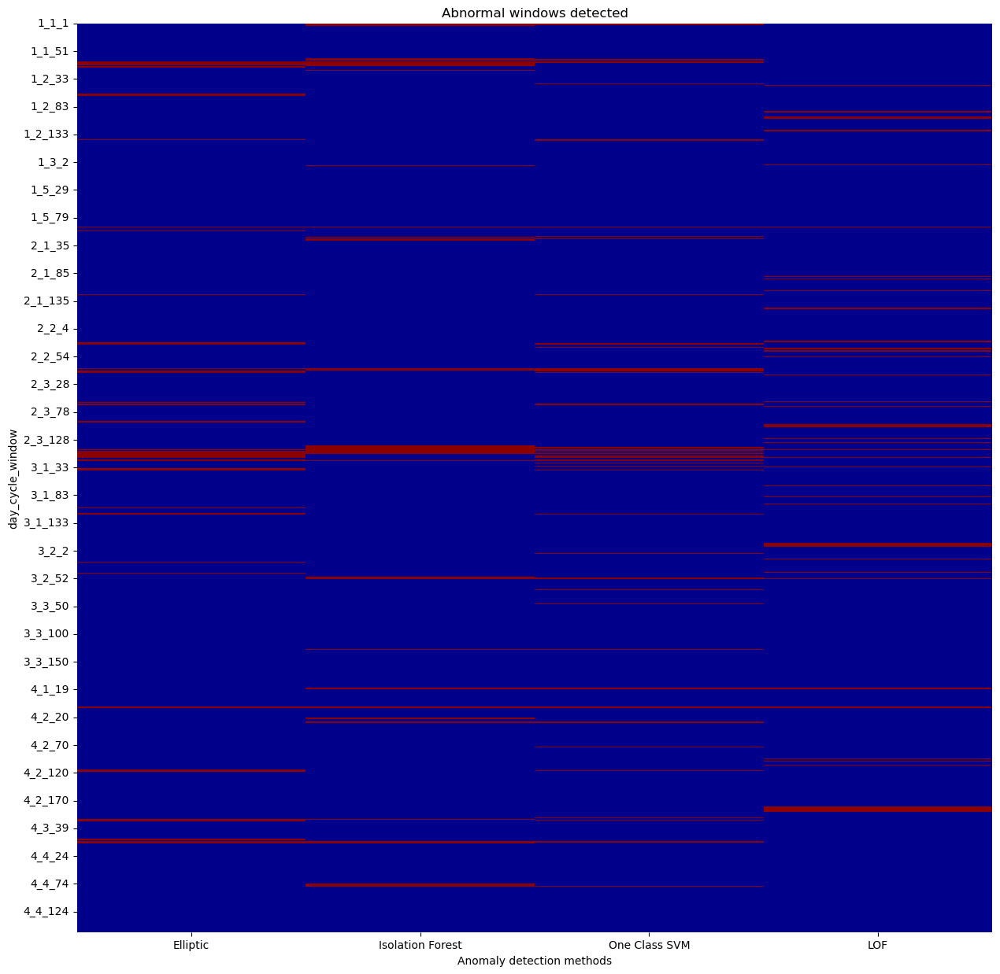

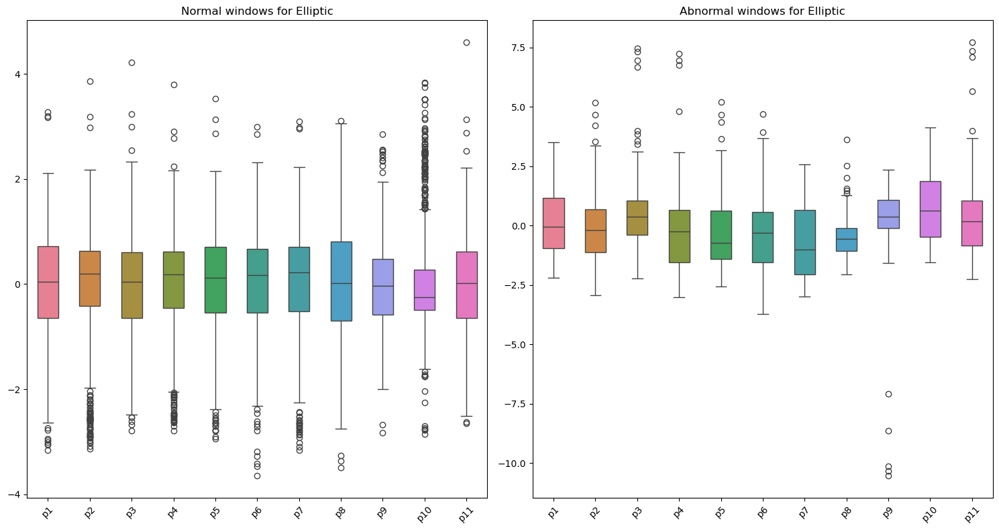

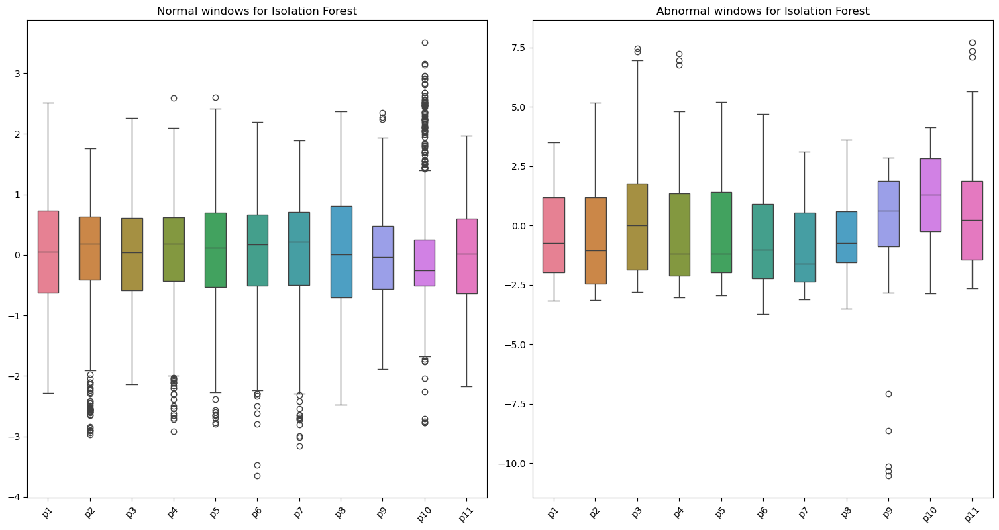

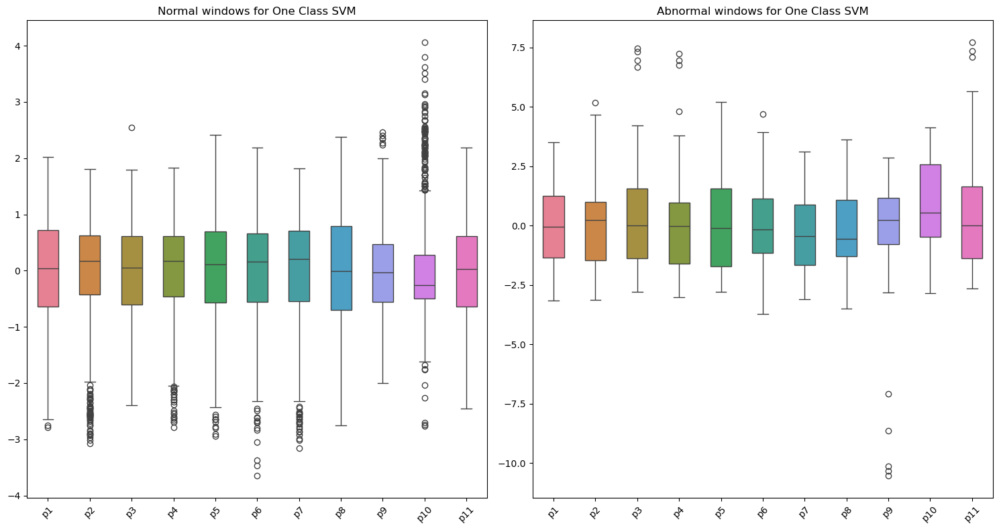

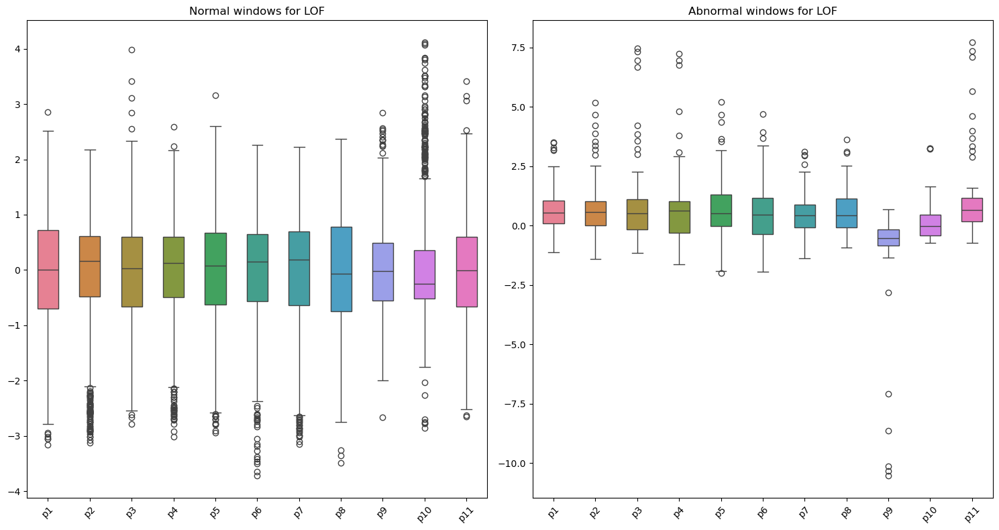

In [10]:
# Tested methods
detected_anomalies_by_method = {
    'Elliptic': is_anomaly_elliptic,
    'Isolation Forest': is_anomaly_isoforest,
    'One Class SVM': is_anomaly_oneclasssvm,
    'LOF': is_anomaly_lof
}

# Creating dataframe with the results
df_anomalies = pd.DataFrame(detected_anomalies_by_method)

# Displaying method comparaison with a heat map (red line = outlier detected)
plt.figure(figsize=(15, 15))
cmap = ListedColormap(['darkred', 'darkblue'])
sns.heatmap(df_anomalies, cmap=cmap, cbar=False)
plt.title("Abnormal windows detected")
step = 50
ticks_to_display = range(0, len(df_anomalies), step)
labels_to_display = df_means['day_cycle_window'][ticks_to_display]
plt.yticks(ticks=ticks_to_display, labels=labels_to_display, rotation=0)
plt.xlabel("Anomaly detection methods")
plt.ylabel("day_cycle_window")
plt.show()

# Loop through each tested method
for method in detected_anomalies_by_method.keys():
    # Get the anomaly detection results for the current method
    anomalies = df_anomalies[method]
    
    # Create masks for normal and abnormal windows
    normal_windows = df_means[anomalies == 1]  # Windows classified as normal
    abnormal_windows = df_means[anomalies == -1]  # Windows classified as anomalous
    
    # Plotting boxplots for each method
    plt.figure(figsize=(15, 8))
    
    # Plot boxplot for normal windows
    plt.subplot(1, 2, 1)  # 1 row, 2 columns, 1st plot
    sns.boxplot(data=normal_windows[parameters], width=0.5)
    plt.title(f'Normal windows for {method}')
    plt.xticks(rotation=45)
    
    # Plot boxplot for abnormal windows
    plt.subplot(1, 2, 2)  # 1 row, 2 columns, 2nd plot
    sns.boxplot(data=abnormal_windows[parameters], width=0.5)
    plt.title(f'Abnormal windows for {method}')
    plt.xticks(rotation=45)
    
    plt.tight_layout()
    plt.show()


In [21]:
# This code will give you the day_cycle_window values that are common to the anomalies detected by all four methods.
common_anomalies_mean = np.intersect1d(df_means['day_cycle_window'][is_anomaly_elliptic == -1],np.intersect1d(df_means['day_cycle_window'][is_anomaly_isoforest == -1],np.intersect1d(df_means['day_cycle_window'][is_anomaly_lof == -1],df_means['day_cycle_window'][is_anomaly_oneclasssvm == -1])))
print(f"{len(common_anomalies_mean)} windows are unanimly detected as anomalies by these methods. Here there are :\n{common_anomalies_mean}")

7 windows are unanimly detected as anomalies by these methods. Here there are :
['1_2_1' '2_1_1' '2_3_145' '3_1_1' '3_2_51' '4_2_1' '4_2_2']


#### Observations
1. **Elliptic Envelope**: With its assumption of a Gaussian distribution, if the data deviates significantly from that, it might struggle to identify many anomalies.

2. **Isolation Forest**: Its tree-based structure isolates points effectively, especially in some concentrated blocks, leading to detect windows that are easily statistically distinguishable from the majority of data.

3. **One-Class SVM**: The use of the RBF kernel may lead it to capture more nuanced deviations in the data, possibly explaining the broader anomaly detection compared to methods like Elliptic Envelope or Isolation Forest.

4. **Local Outlier Factor (LOF)**: It detects anomalies in dense clusters that are not consistently flagged by other methods. Its focus on local density means it identifies points that are unusual relative to their local neighborhood rather than the overall dataset. This can be a strenght when it comes to ignore natural variability for instance.

#### Comments on the results
- **Diversity in Detected Anomalies**: Each method shows differences in the anomalies it detects. 7 windows (according to the previous code) are marked as anomalies consistently across multiple methods, while others are detected by only one or two methods. This indicates variability in how each algorithm defines and identifies outliers, based on their underlying mechanisms. We have also chosen to display the statiscal characteristics of "normal" and "abnormal" windows for each method in order to help the expert to double check the relevance of the detected anomalies.
- **Disagreements**: Some anomalies are detected exclusively by one method. For instance, LOF tends to detect localized anomalies that may not be captured by Isolation Forest or One-Class SVM.
- **Dependence on Hyperparameters**: The behavior of these methods can be highly sensitive to hyperparameter tuning (e.g., contamination, number of neighbors, gamma). The observed differences may partially stem from the specific parameter settings chosen. Experiment with tuning hyperparameters for each method to evaluate how the anomaly detection changes, especially in regions of disagreement.


#### Why different Anomaly Detection Methods do not detect the same outliers ?

The fact that different anomaly detection methods do not identify the same outliers can be explained by several factors related to how each method works, its underlying assumptions, and the nature of the data. Here’s a breakdown of the key reasons:

- **Different Assumptions About Data Distribution**:
  - **Elliptic Envelope** assumes that the data follows a Gaussian distribution (normal distribution). It identifies outliers based on the Mahalanobis distance, which is sensitive to how the data is distributed around the mean.
  - **Isolation Forest** is based on the principle of isolating observations by randomly selecting features and splitting the data. This method is effective for high-dimensional datasets but may not perform well when the data has a strong correlation structure or if the anomalies are not easy to isolate.
  - **Local Outlier Factor (LOF)** detects anomalies by comparing the local density of points. This method is particularly effective when anomalies are surrounded by points that are much denser. It works well for local anomalies but may struggle in areas of low density.
  - **One-Class SVM** uses the concept of finding a boundary around normal data using a support vector machine (SVM). It is sensitive to the choice of the kernel and the **gamma** parameter, which determines how the model adapts to the data. Different values of `gamma` may lead to different results in terms of what is considered normal or abnormal.

- **Sensitivity to Hyperparameters**:
  Each method has its own set of hyperparameters that significantly impact its performance:
  - **Contamination** parameter in methods like **Isolation Forest** and **LOF** specifies the expected proportion of outliers in the dataset. A higher contamination rate may lead to more points being classified as outliers.
  - The **number of neighbors** parameter in **LOF** and **n_estimators** in **Isolation Forest** also plays a role in determining the size of the neighborhood considered for anomaly detection. Small values may lead to overfitting, while large values could miss subtle anomalies.
  - **Gamma** in **One-Class SVM** determines the width of the decision boundary. A low gamma value makes the boundary wide and may classify more points as normal, while a high gamma value may result in a more sensitive boundary, classifying more points as outliers.

- **Sensitivity to Local vs Global Structure**:
  - **LOF** focuses on the local density and can detect anomalies that are significantly different from their neighbors but may not detect anomalies that are global in nature. For instance, if the data has global outliers (points far from the overall data distribution), **LOF** may not detect them.
  - **Elliptic Envelope** and **Isolation Forest** focus more on global structures and could miss local anomalies that **LOF** may capture.

- **Dimensionality and Feature Relationships**:
  - **High-dimensionality** can impact the performance of anomaly detection methods. For example, **Isolation Forest** can work well in high-dimensional spaces by isolating points, but methods like **Elliptic Envelope** or **LOF** can struggle if the features are highly correlated or if the anomalies are not well isolated.
  - Some methods, like **One-Class SVM**, may be sensitive to the number of features and can perform poorly if the data is not properly preprocessed or if irrelevant features are included.

- **Nature of the Anomalies**:
  - The nature of the anomalies in the dataset (e.g., point anomalies, contextual anomalies, or collective anomalies) can affect which method detects them. For example, if the dataset contains isolated, point anomalies, methods like **Isolation Forest** and **Elliptic Envelope** may perform better, while **LOF** may detect anomalies that are unusual within a local context.

- **Outlier Definition**:
  - Different methods may have different definitions of what constitutes an outlier. For example, **Isolation Forest** may be more aggressive in detecting outliers due to its tree-based structure, while **Elliptic Envelope** may only flag points that are far from the center of the assumed Gaussian distribution.

- **Data Preprocessing**:
  - Data preprocessing steps such as scaling or normalizing the features can influence the outcome of some methods. For example, **One-Class SVM** with an RBF kernel is sensitive to the scale of the features, so if the features have vastly different ranges, it may fail to detect outliers properly unless the data is standardized.

In summary, **the detection of anomalies is highly dependent on the assumptions, hyperparameters, and sensitivity of the chosen method**, which can explain why different methods do not always identify the same outliers. Each method captures different aspects of the data and may excel in different scenarios, leading to different outcomes when applied to the same dataset.


## More realistic approach : characterize each window by different statiscal characteristics of each parameters

This section consists in considering that each window can be represented by different statiscal characteristics of each parameter : for instance mean, standrad deviation, minimum, maximum, median. Thus we preprocess the data in order to work on a dataframe containing only these pieces of information.

In [6]:
### Reading the dataset
df = pd.read_csv("dataset.csv")

# Split the 'day_cycle_window' column into 'day', 'cycle', and 'window' and convert them to integers
df[['day', 'cycle', 'window']] = df['day_cycle_window'].str.split('_', expand=True)
df[['day', 'cycle', 'window']] = df[['day', 'cycle', 'window']].astype(int)

# Select only numeric columns for statistics calculation
numeric_columns = df.select_dtypes(include=['number']).columns.difference(['day', 'cycle', 'window'])

# Compute the statistical characteristics for each 'day_cycle_window' group on numeric columns only
df_features = df.groupby('day_cycle_window')[numeric_columns].agg(['mean', 'std','median','min','max']).reset_index()

# Flatten the multi-level headers to get clearer column names
# Create a column name in the format 'param_mean','param_std'...
df_features.columns = [f"{col[0]}_{col[1]}" if col[1] else col[0] for col in df_features.columns]

# Filter columns to only those related to parameters (p1, p2, ..., p11)
param_columns = [col for col in df_features.columns if col.startswith('p')]

# Sort the parameter columns (p1, p2, ..., p11) in ascending order
# Extract the parameter number after 'p' and sort by this number
param_columns_sorted = sorted(param_columns, key=lambda x: int(x.split('_')[0][1:]))

# Reorder df_features with the sorted columns and add the non-parameter columns at the end
df_features = df_features[param_columns_sorted + [col for col in df_features.columns if col not in param_columns_sorted]]

# Split the 'day_cycle_window' column into 'day', 'cycle', and 'window' and convert them to integers
df_features[['day', 'cycle', 'window']] = df_features['day_cycle_window'].str.split('_', expand=True)
df_features[['day', 'cycle', 'window']] = df_features[['day', 'cycle', 'window']].astype(int)

# Sort the DataFrame by 'day', 'cycle', and 'window' and reset the index
df_features = df_features.sort_values(by=['day', 'cycle', 'window']).reset_index(drop=True)

# Drop the 'day', 'cycle', and 'window' columns
df_features = df_features.drop(columns=['day', 'cycle', 'window'])

# Display the first few rows to verify
df_features.head()

,p1_mean,p1_std,p1_median,p1_min,p1_max,p2_mean,p2_std,p2_median,p2_min,p2_max,...,p10_std,p10_median,p10_min,p10_max,p11_mean,p11_std,p11_median,p11_min,p11_max,day_cycle_window
0,-1.926141,0.591155,-1.849016,-3.107670,-0.805191,-2.456284,0.739638,-2.565392,-3.395387,-1.112276,...,0.673869,-1.748105,-2.283434,0.495528,-2.500060,0.724468,-2.857906,-3.183571,-1.244472,1_1_1
1,-1.714067,0.197499,-1.798110,-1.953996,-1.330915,-2.217161,0.109149,-2.198342,-2.471116,-2.029273,...,0.497962,-1.687537,-2.099826,-0.772787,-2.654753,0.262073,-2.575661,-3.132542,-2.302767,1_1_2
2,-1.534357,0.458886,-1.448777,-2.442716,-0.987386,-1.779994,0.463978,-1.754517,-2.501740,-1.150615,...,0.459387,-3.054871,-3.308274,-1.781047,-1.926807,0.474839,-2.080907,-2.526851,-1.222144,1_1_3
3,-1.415197,0.177273,-1.398369,-2.165870,-1.217565,-1.453962,0.215131,-1.369965,-2.130489,-1.282602,...,0.398511,-0.720180,-1.590155,-0.347429,-2.117340,0.107617,-2.083121,-2.371545,-1.989938,1_1_4
4,-0.732715,0.386954,-0.874543,-1.287800,0.064758,-0.634379,0.536726,-0.808077,-1.439102,0.426946,...,1.219066,-1.245751,-2.082270,3.565082,-1.796746,0.803952,-2.371545,-2.520195,-0.250517,1_1_5


In [7]:
def plot_time_series_feature(df,param,feature_to_plot):
    """
    Plot the time series of the parameter param (str : 'p1','p2',...,'p11')
    """
    fig, ax = plt.subplots()
    ax.scatter(df['day_cycle_window'],df[f'{param}_{feature_to_plot}'],marker='.',c=colors[int(param[1:])-1])
    ax.set_xlabel('day_cycle_window')
    ax.set_ylabel(f"{param}_{feature_to_plot} by window")
    ax.set_xticks(df['day_cycle_window'][::100])
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

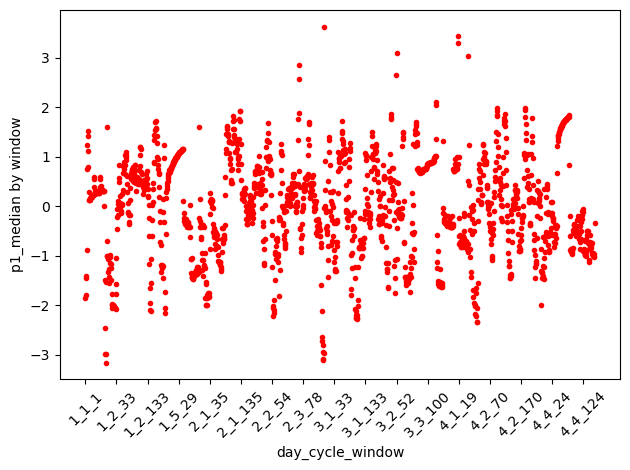

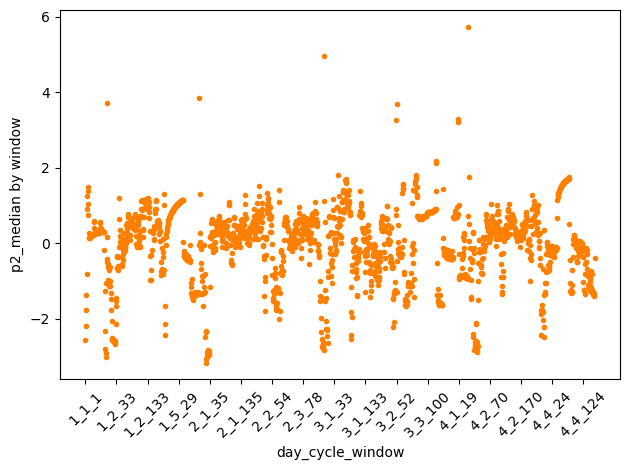

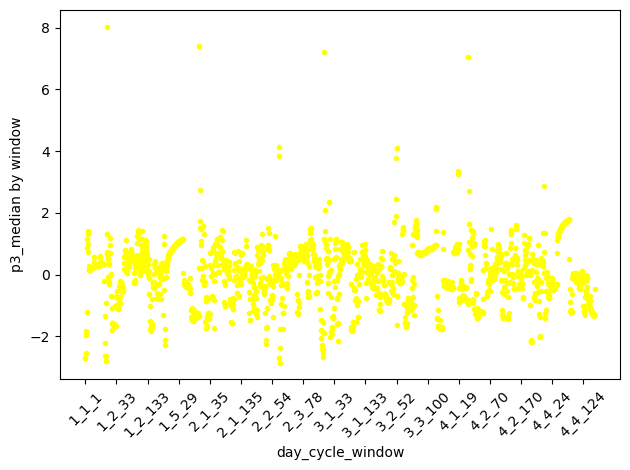

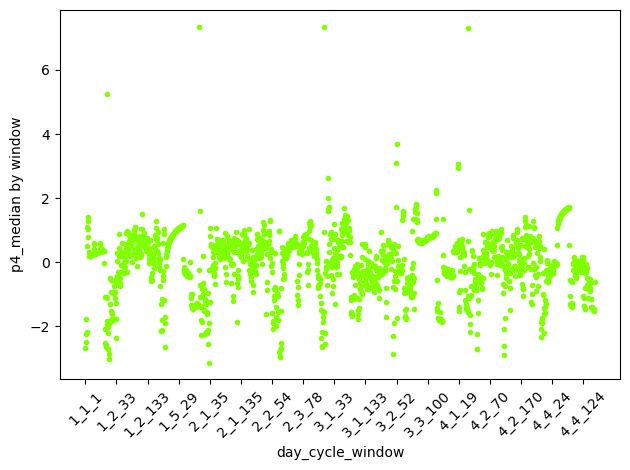

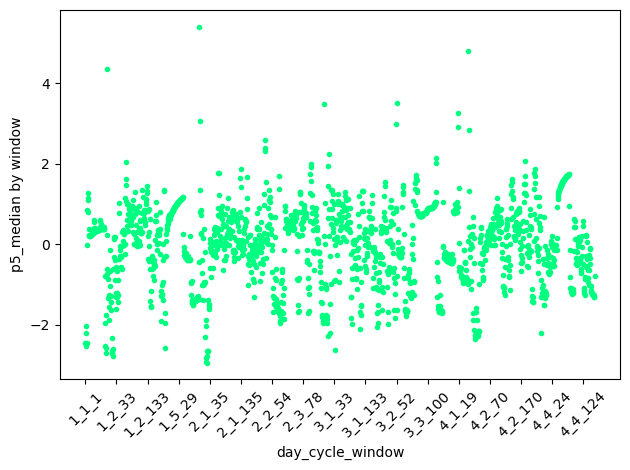

...

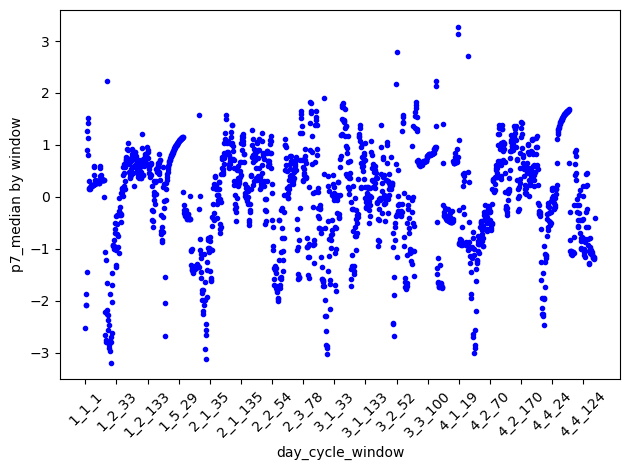

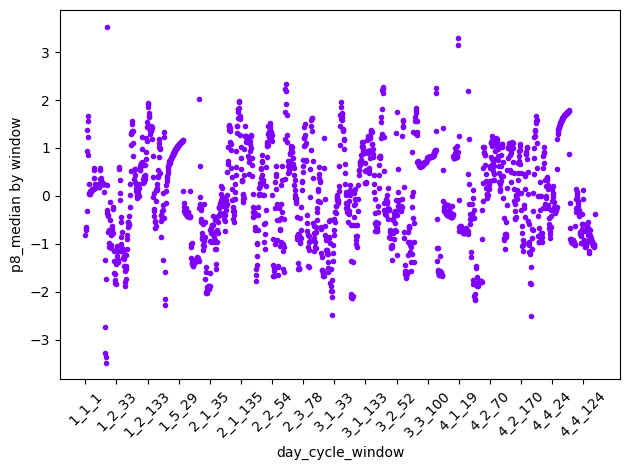

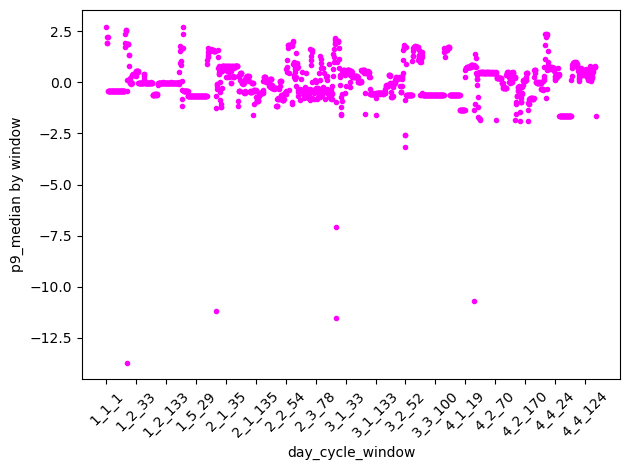

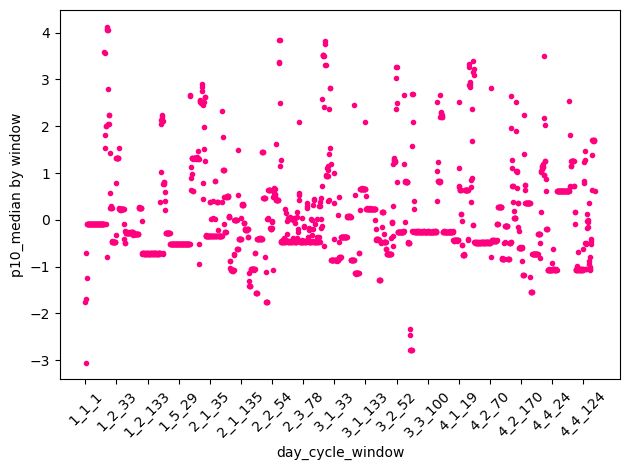

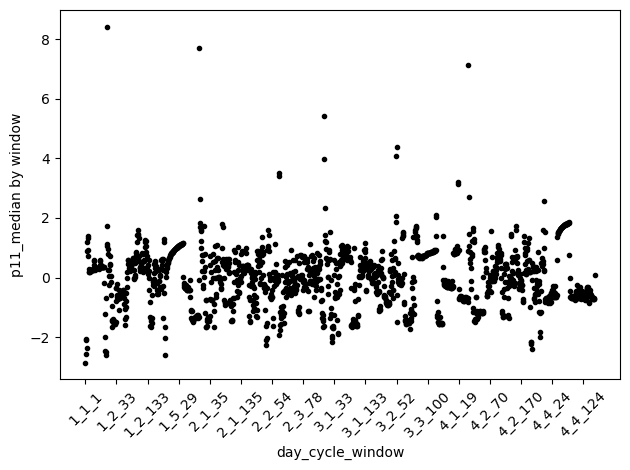

In [26]:
# Visualize the time series of the median (for instance) by window for each parameter
for k in range(1,12):
    plot_time_series_feature(df_features,f'p{k}','median') # can be modified

In this section, each window is characterized by 55 features (the mean, the standard deviation, the median, the minimum and the maximum for each parameter). Obviously, this may cause some **curse of dimensionality** when it comes to apply anomaly detection methods.

To avoid that, we propose a preprocessing workflow that consists in :
- Dropping the features do not vary a lot within the windows
- Removing highly correlated features
- Applying a **Principal Component Analysis (PCA)** and keeping enough features to explain a significant portion of the variance within the windows

STANDARDIZING THE DATA...


COMPUTING THE FEATURES VARIANCE OVER THE WINDOWS...



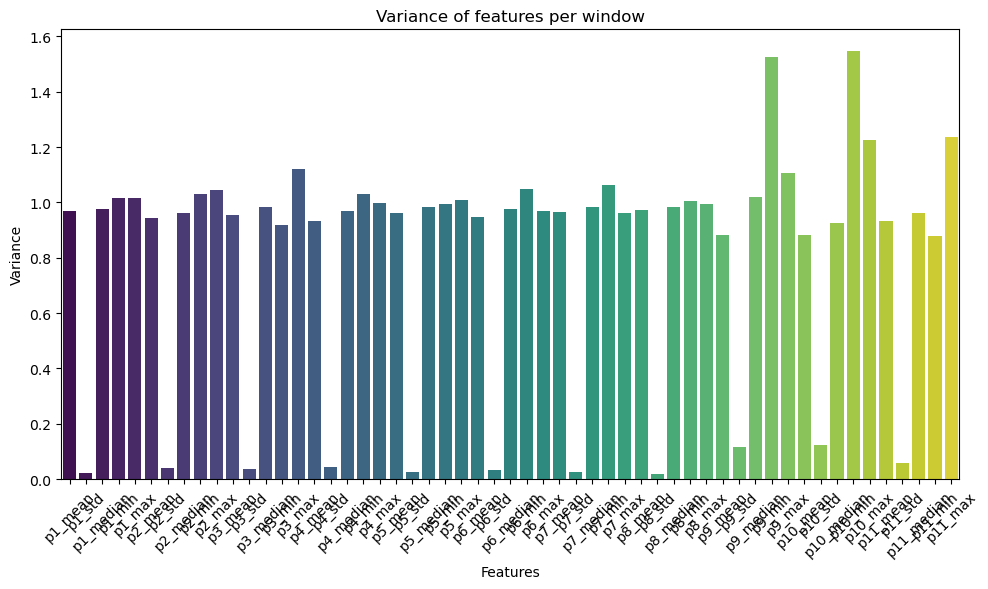

Variance threshold = 0.1
Dropped columns : ['p1_std' 'p2_std' 'p3_std' 'p4_std' 'p5_std' 'p6_std' 'p7_std' 'p8_std'
 'p11_std']


COMPUTING THE CORRELATION MATRIX..



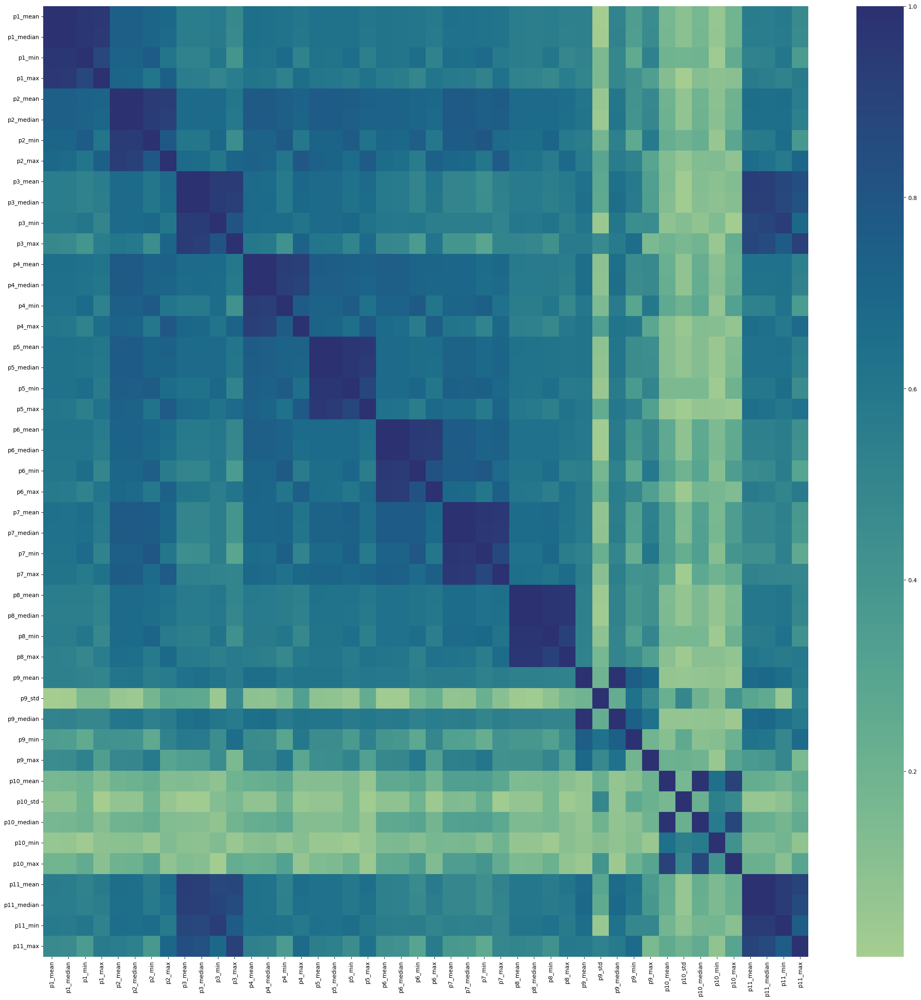

Correlation threshold = 0.1
Dropped columns : ['p1_median', 'p2_median', 'p3_median', 'p4_median', 'p5_median', 'p6_median', 'p7_median', 'p8_median', 'p11_median']


APPLYING PCA...



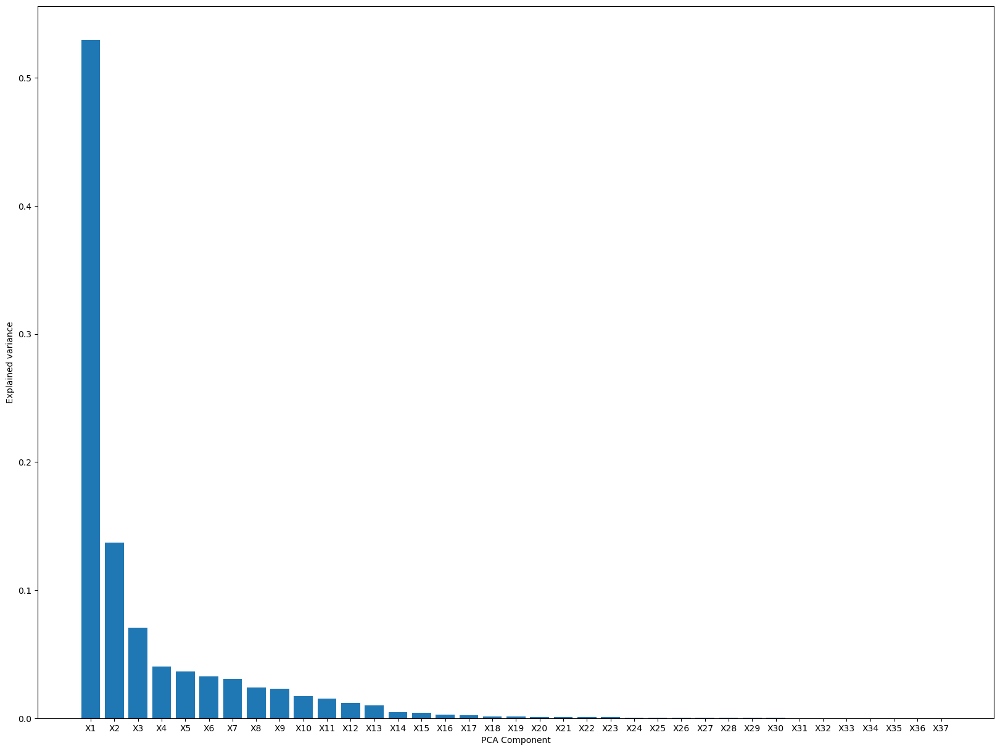

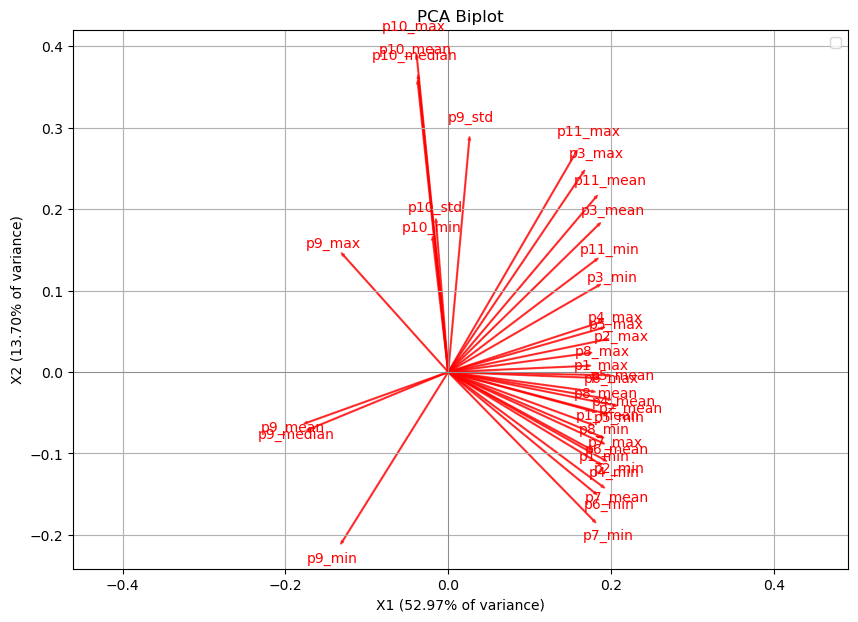

Components kept: ['X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X7', 'X8', 'X9', 'X10', 'X11'] 
	 Cumulated explained variance = 0.9561535094590143




,X1,X2,X3,X4,X5,X6,X7,X8,X9,X10,...,X29,X30,X31,X32,X33,X34,X35,X36,X37,day_cycle_window
0,-12.303596,-0.955507,-4.376034,2.222642,0.856844,0.067257,-1.351655,0.245755,0.072718,-0.363544,...,0.111948,0.162547,-0.044291,0.033375,0.101448,0.054192,0.007751,0.320581,-0.131021,1_1_1
1,-11.253901,-3.108320,-2.820723,0.941468,2.010830,0.685893,-1.106210,-0.065475,1.295811,-0.991123,...,0.006587,-0.027614,0.097246,-0.042946,0.051691,-0.059295,0.014763,-0.121403,0.005392,1_1_2
2,-9.091116,-3.432163,-4.854588,0.433840,0.915586,-0.345406,-2.395416,0.168079,0.924956,-0.466770,...,0.028081,0.084798,0.011837,0.061242,-0.010525,-0.011885,0.000457,0.104254,0.054741,1_1_3
3,-9.794412,-1.757115,-1.875780,0.760423,1.453632,0.483369,-0.820885,0.167829,1.231058,-0.909386,...,0.035608,0.110659,-0.033510,0.102687,-0.139193,0.014223,-0.003504,0.086506,0.043253,1_1_4
4,-5.712511,1.711599,-5.364697,2.853033,1.542269,1.133139,0.350816,0.129568,2.171056,0.013155,...,-0.234628,-0.120607,-0.534732,0.144021,-0.126010,0.029960,-0.026005,0.014903,-0.070953,1_1_5


In [9]:
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import StandardScaler


parameters_features = [col for col in df_features.columns if col.startswith('p')]

# Assume 'df' is your original DataFrame and 'parameters' is the list of parameter columns
X = df_features[parameters_features]  # Select parameter columns

# Standardize the data
print("STANDARDIZING THE DATA...\n\n========================================================\n")
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, columns=parameters_features)

# Calculate the variances of the features
print("COMPUTING THE FEATURES VARIANCE OVER THE WINDOWS...\n")
variances = X.var(axis=0)  # Calculate the variance for each feature
#print(variances)

# Plot variances by feature
plt.figure(figsize=(10, 6))
sns.barplot(x=variances.index, y=variances.values, palette='viridis')

# Customize the plot
plt.title("Variance of features per window")
plt.xlabel("Features")
plt.ylabel("Variance")
plt.xticks(rotation=45)
plt.tight_layout()

plt.show(block=True)

# Define the variance threshold
var_threshold = 0.1 # CAN BE TUNED

# Select columns where the variance is above the threshold
selected_columns = variances[variances > var_threshold].index
print(f"Variance threshold = {var_threshold}\nDropped columns : {np.asarray(variances[variances <= var_threshold].index)}")

print("\n========================================================\n")

# Filter the DataFrame to keep only the selected columns
X_scaled = X_scaled[selected_columns]

# Calculate the correlation matrix
print("COMPUTING THE CORRELATION MATRIX..\n")
corr_matrix = X_scaled.corr().abs()
plt.figure(figsize=(30,30))
sns.heatmap(corr_matrix, cmap="crest")
plt.show(block=True)

# Remove correlated features
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
cor_threshold = 0.99 # CAN BE TUNED
to_drop = [column for column in upper.columns if any(upper[column] > cor_threshold)]
X_reduced_corr = X_scaled.drop(columns=to_drop)
print(f"Correlation threshold = {var_threshold}\nDropped columns : {to_drop}")

print("\n========================================================\n")

# Apply PCA to obtain the first two principal components
print("APPLYING PCA...\n")
pca = PCA()
X_pca = pca.fit_transform(X_reduced_corr)

# Create a DataFrame for the principal components
parameters_pca_kept = [col for col in selected_columns if col not in to_drop]
pca_components = [f'X{i}' for i in range(1, len(parameters_pca_kept)+1)]
df_pca = pd.DataFrame(X_pca, columns=pca_components)
df_pca['day_cycle_window'] = df_means['day_cycle_window']

# Displaying results
plt.figure(figsize=(20,15))
plt.bar(np.arange(1, len(parameters_pca_kept)+1), pca.explained_variance_ratio_)
plt.xticks(np.arange(1, len(parameters_pca_kept)+1), pca_components)
plt.xlabel('PCA Component')
plt.ylabel('Explained variance')
plt.show()
#print("Explained variance by component:", pca.explained_variance_ratio_)
#print("Cumulated explained variance:", pca.explained_variance_ratio_.cumsum())

show_biplot = True # CAN BE CHANGED

if show_biplot == True:
    # Create the biplot
    plt.figure(figsize=(10, 7))

    # Add the points projected onto the principal components
    #plt.scatter(df_pca['X1'], df_pca['X2'], alpha=0.7, c='gray', edgecolor='k', label="Projections des données")

    # Add the unit circle
    circle = plt.Circle((0, 0), 1, color='b', fill=False, linestyle='--', linewidth=1)
    plt.gca().add_artist(circle)

    # Add the component vectors
    for i, (comp1, comp2) in enumerate(zip(pca.components_[0], pca.components_[1])):
        plt.arrow(0, 0, comp1, comp2, color='r', alpha=0.7)
        plt.text(comp1 * 1.1, comp2 * 1.1,
                parameters_pca_kept[i], color='r', ha='center', va='center')

    # Labels and legend
    plt.xlabel(f"X1 ({pca.explained_variance_ratio_[0]*100:.2f}% of variance)")
    plt.ylabel(f"X2 ({pca.explained_variance_ratio_[1]*100:.2f}% of variance)")
    plt.title("PCA Biplot")
    plt.axhline(0, color='grey', lw=0.5)
    plt.axvline(0, color='grey', lw=0.5)
    plt.legend()
    plt.grid(True)
    plt.axis('equal')
    plt.show(block=True)

# Component selection
pca_threshold = 0.95 # CAN BE TUNED
pca_components_kept = [f'X{i}' for i in range(1, np.argmax(pca.explained_variance_ratio_.cumsum() > pca_threshold)+2)]

print(f"Components kept: {pca_components_kept} \n\t Cumulated explained variance = {pca.explained_variance_ratio_.cumsum()[len(pca_components_kept)-1]}")
print("\n====================================================\n")
df_pca.head()

We define the function *pca_comparaison* to allow the expert to compare the scope of anomaly detection relying only on windows average for each parameters, and the one trying to take into account other interesting stastical features.

In [10]:
def pca_comparaison(clf_name, clf, df, param, df_pca, param_pca, clf_pca=None):
    """
    Compare anomaly detection results with and without PCA.

    Parameters:
        clf_name (str): Name of the outlier detection model.
        clf (object): Scikit-learn model instance - the trained outlier detection model.
        df (pd.DataFrame): Pandas DataFrame containing all the points to plot (for features X1 and X2).
        param (list): List of parameters (features) to use for anomaly detection without PCA.
        df_pca (pd.DataFrame): Pandas DataFrame containing PCA-transformed data.
        param_pca (list): List of parameters (features) to use for anomaly detection with PCA.
        clf_pca (object, optional): Scikit-learn model instance for PCA-transformed data. Defaults to None. 
                                    /!\ The model must be the same type as clf but its hyperparameters may
                                        vary, depending on their optimization /!\

    Returns:
        tuple: A tuple containing two arrays - is_anomaly and is_anomaly_pca, which indicate the detected anomalies
               without and with PCA, respectively.
    """
    # Detecting anomalies (without using PCA)
    print("DETECTING ANOMALIES WITHOUT PCA...\n")
    clf.fit(df[param])
    is_anomaly = plotAnomalyScore(df, clf_name, clf, param)
    abnormal_windows = df['day_cycle_window'][is_anomaly==-1]
    print(f"Detected abnormal windows: {abnormal_windows.count()} / {df.shape[0]-1}\n")
    print(abnormal_windows.to_numpy())
    
    print("\n=====================================\n")
    
    # Detecting anomalies (with PCA)
    print("DETECTING ANOMALIES WITH PCA...\n")
    if clf_pca == None: # If no classifier specifically assigned to the data 
        clf_pca = clf
    clf_pca.fit(df_pca[param_pca])
    is_anomaly_pca = plotAnomalyScore(df_pca, clf_name, clf_pca, param_pca)
    abnormal_windows_pca = df_pca['day_cycle_window'][is_anomaly_pca==-1]
    print(f"Detected abnormal windows: {abnormal_windows_pca.count()} / {df_pca.shape[0]-1}\n")
    print(abnormal_windows_pca.to_numpy())
    
    print("\n=====================================\n")
    
    print("COMPARING THE METHODS...\n")
    # Tested methods
    detected_anomalies_pca_comparaison = {
    clf_name: is_anomaly,
    f'{clf_name} - PCA': is_anomaly_pca
    }

    # Creating dataframe with the results
    df_anomalies = pd.DataFrame(detected_anomalies_pca_comparaison)

    # Displaying method comparaison with a heat map (red line = outlier detected)
    plt.figure(figsize=(15, 15))
    cmap = ListedColormap(['darkred', 'darkblue'])
    sns.heatmap(df_anomalies, cmap=cmap, cbar=False)
    plt.title("Abnormal windows detected")
    step = 50
    ticks_to_display = range(0, len(df_anomalies), step)
    labels_to_display = df['day_cycle_window'][ticks_to_display]
    plt.yticks(ticks=ticks_to_display, labels=labels_to_display, rotation=0)
    plt.xlabel("Anomaly detection methods")
    plt.ylabel("day_cycle_window")
    plt.show()
    
    return is_anomaly,is_anomaly_pca

For each tested algorithm, we perform a new hyperparameter optimization since they may be different from the "average approach". Then we apply the *pca_comparaison* defined above to show the differences in terms of anomaly detection. Here, **we assume that the number of anomalies found (mainly driven by the contamination rate) do not vary a lot from an approach to another**. Indeed, we assume that the expert knows the expected order of magnitude of the proportion of anomalies in the dataset. What matters here is to **compare wether one approach from another betters in the detection of anomalies (or even of some kinds of anomalies)**.

### 1st method : using the Minimum Covariance Determinant (MCD) method to determine an elliptic enveloppe

In [11]:
### Hyperparameters tuning ###

# Hyperparameters tuning
contamination = [0.01, 0.05, 0.1]

for c in contamination:
    # Initializing model with current values of tested hyperparameters
    model = EllipticEnvelope(contamination=c,random_state=42)

    # Model fitting and anomaly prediction
    predictions = model.fit_predict(df_pca[pca_components_kept])

    # Displaying results
    print(f"contamination={c}")
    print(f"Anomalies détectées: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

contamination=0.01
Anomalies détectées: 17 / 1636

contamination=0.05
Anomalies détectées: 82 / 1636

contamination=0.1
Anomalies détectées: 164 / 1636



Thus, the same hyperparameters are kept for the "extra statistical features approach". Hence, `clf_pca = clf`

DETECTING ANOMALIES WITHOUT PCA...



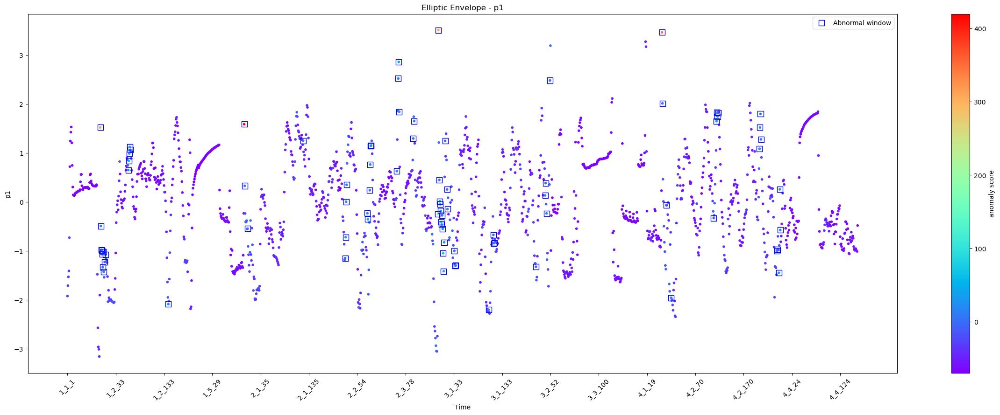

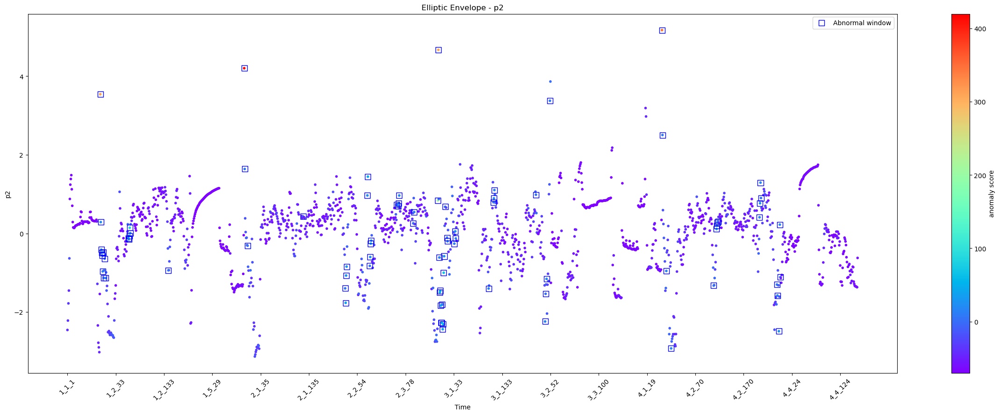

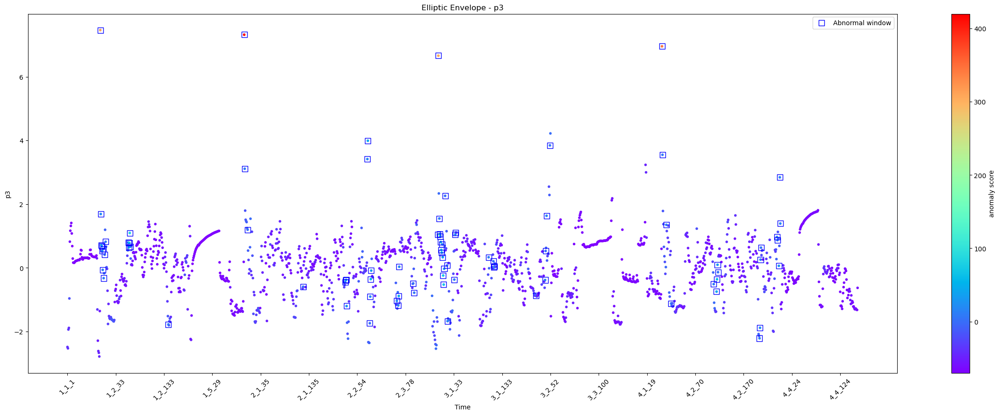

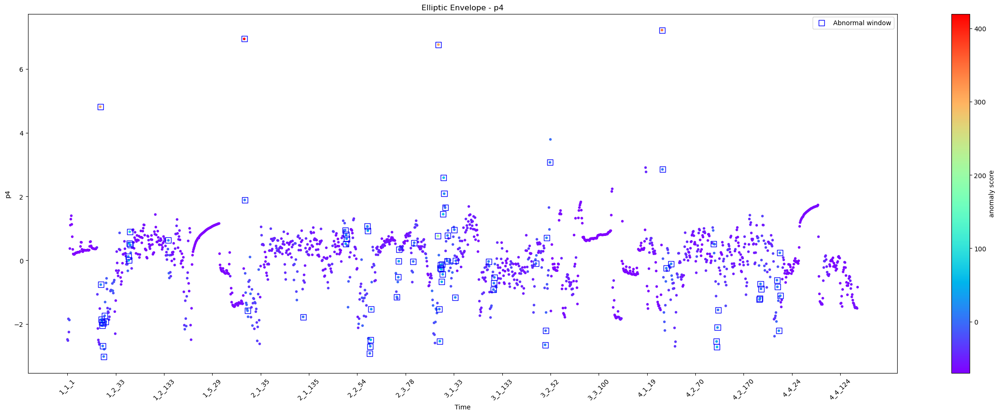

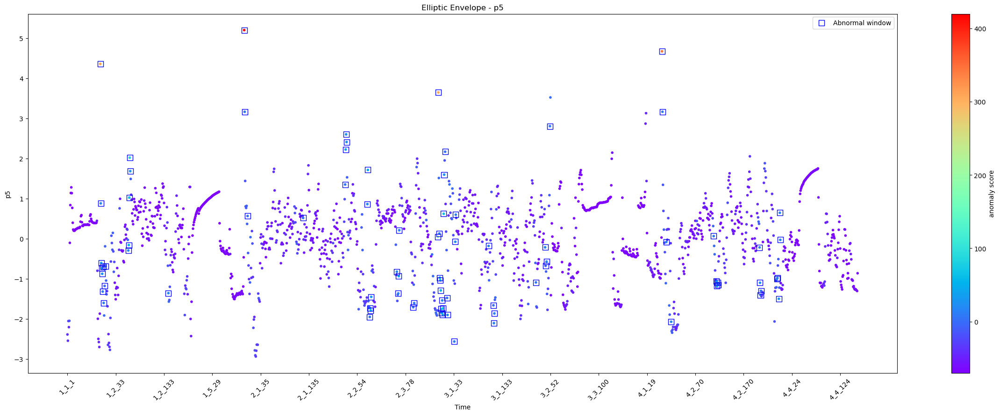

...

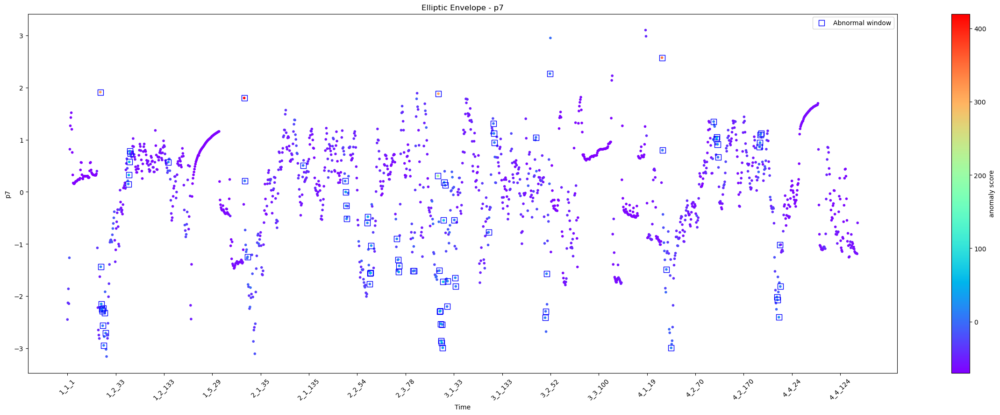

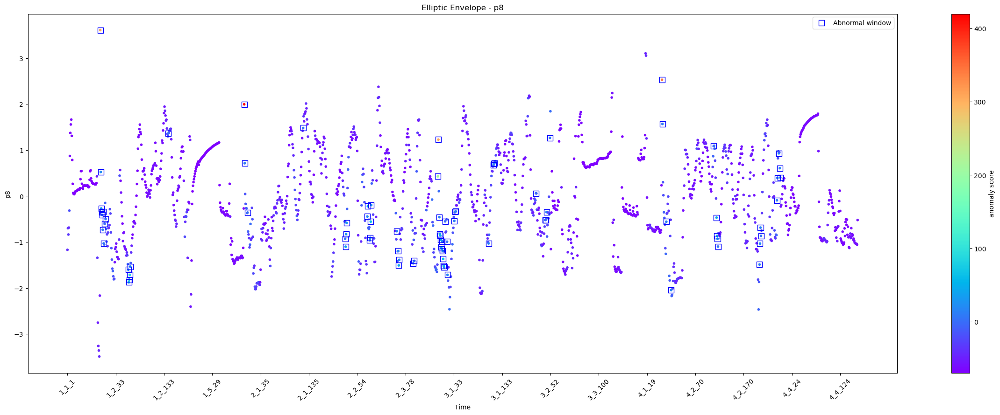

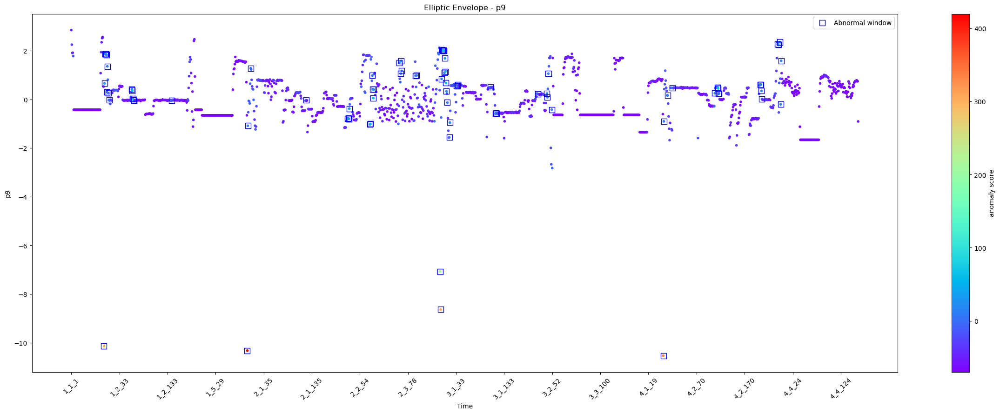

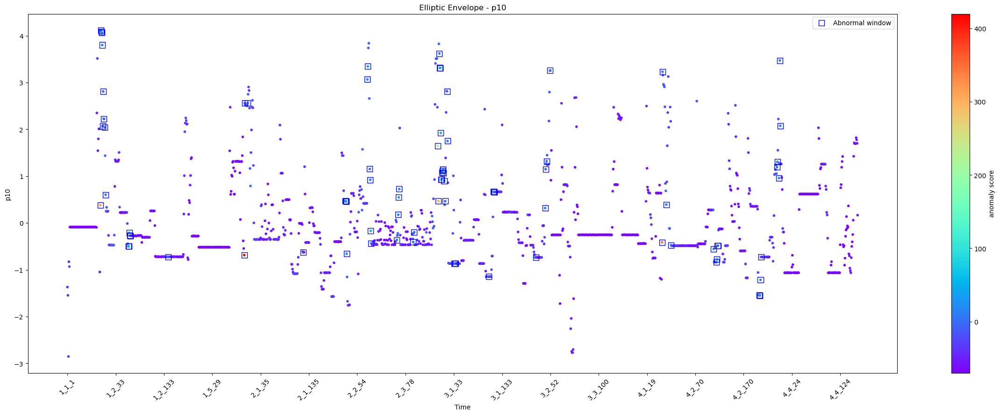

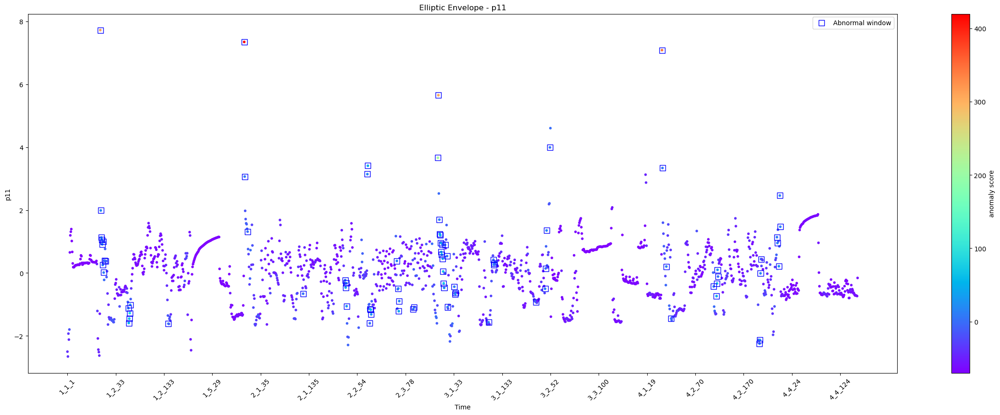

Detected abnormal windows: 82 / 1636

['1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_10'
 '1_2_12' '1_2_59' '1_2_60' '1_2_61' '1_2_62' '1_2_63' '1_2_142' '2_1_1'
 '2_1_2' '2_1_8' '2_1_123' '2_2_29' '2_2_30' '2_2_31' '2_2_32' '2_2_75'
 '2_2_76' '2_3_4' '2_3_5' '2_3_6' '2_3_7' '2_3_60' '2_3_63' '2_3_64'
 '2_3_65' '2_3_94' '2_3_96' '2_3_145' '3_1_1' '3_1_3' '3_1_4' '3_1_5'
 '3_1_6' '3_1_7' '3_1_8' '3_1_9' '3_1_10' '3_1_11' '3_1_12' '3_1_13'
 '3_1_15' '3_1_19' '3_1_20' '3_1_34' '3_1_36' '3_1_37' '3_1_105' '3_1_115'
 '3_1_116' '3_1_117' '3_2_22' '3_2_41' '3_2_42' '3_2_44' '3_2_51' '4_2_1'
 '4_2_2' '4_2_10' '4_2_20' '4_2_108' '4_2_114' '4_2_115' '4_2_116'
 '4_2_117' '4_3_22' '4_3_23' '4_3_24' '4_3_25' '4_3_58' '4_3_59' '4_3_62'
 '4_3_64' '4_3_65']


DETECTING ANOMALIES WITH PCA...



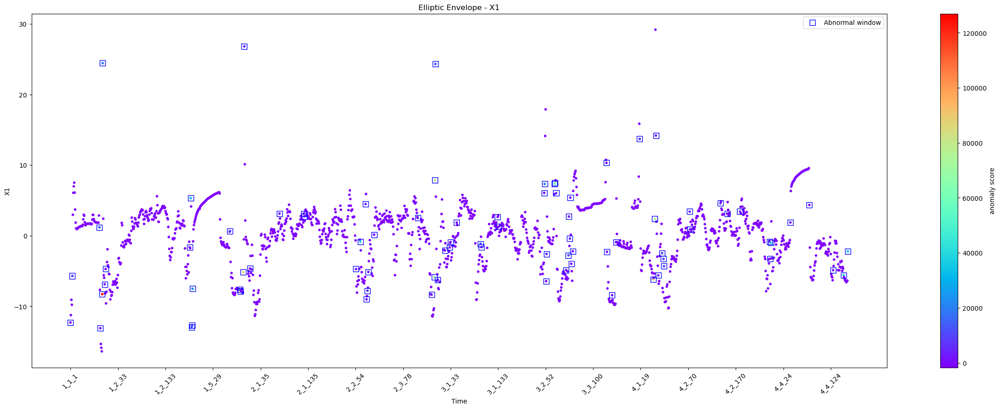

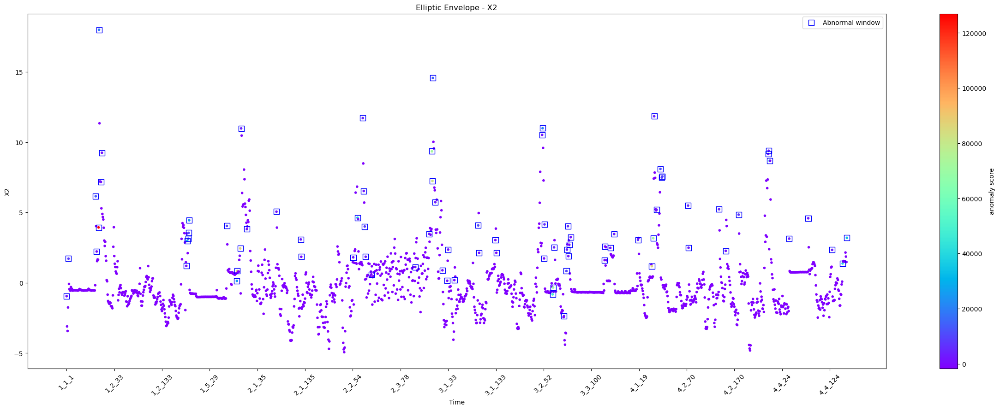

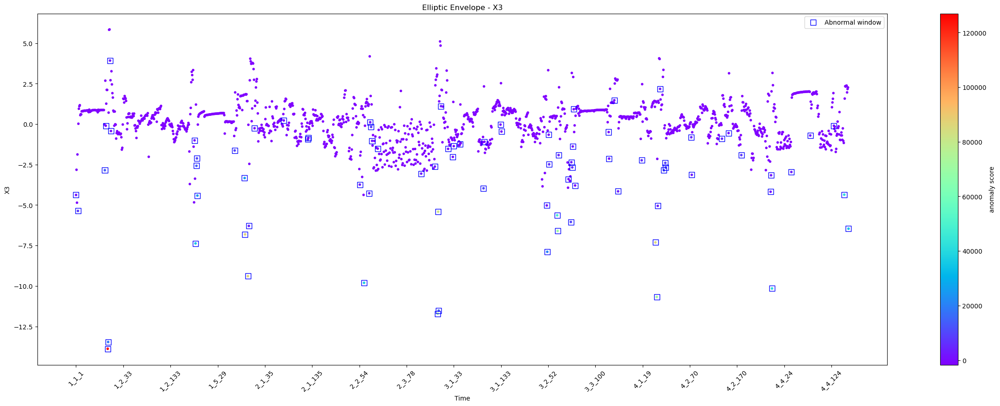

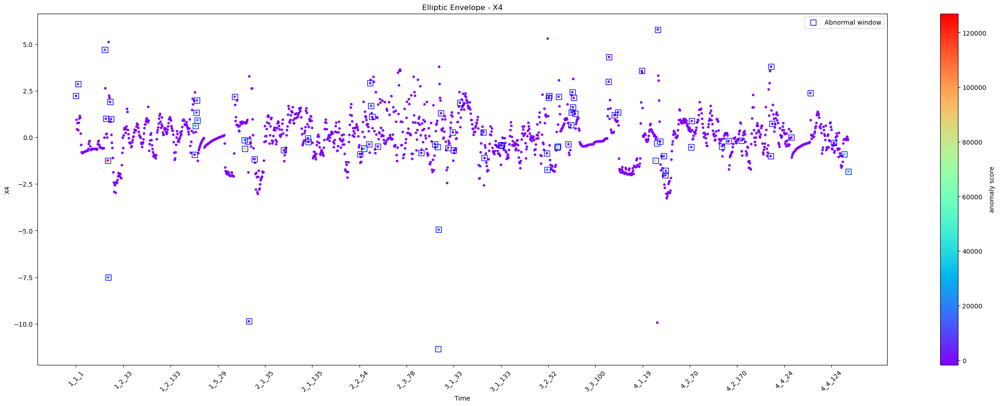

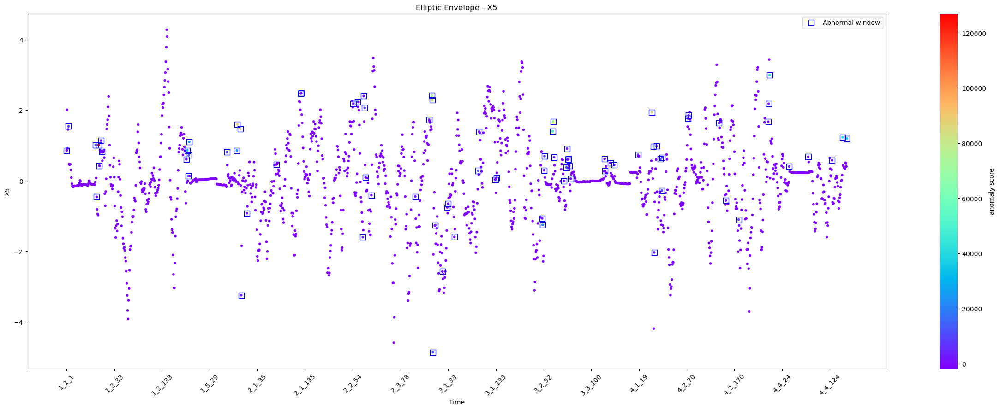

...

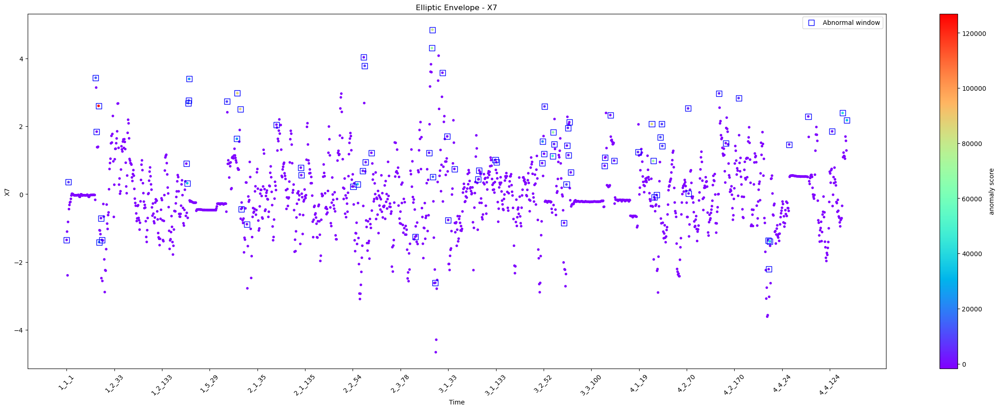

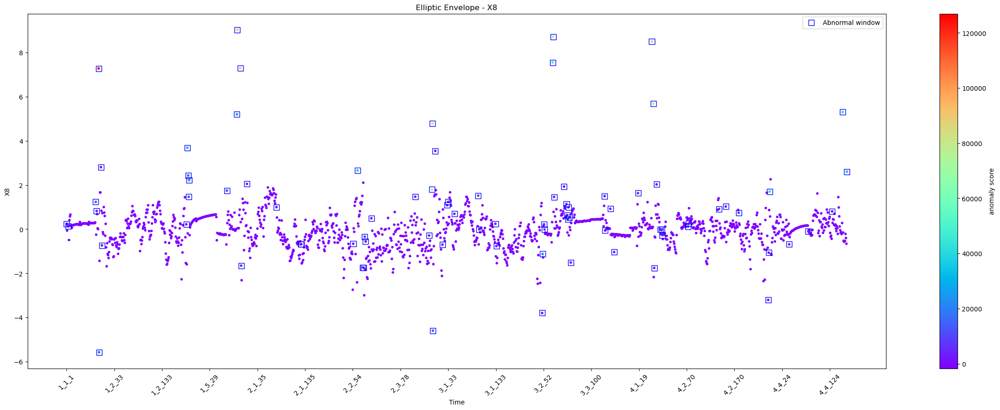

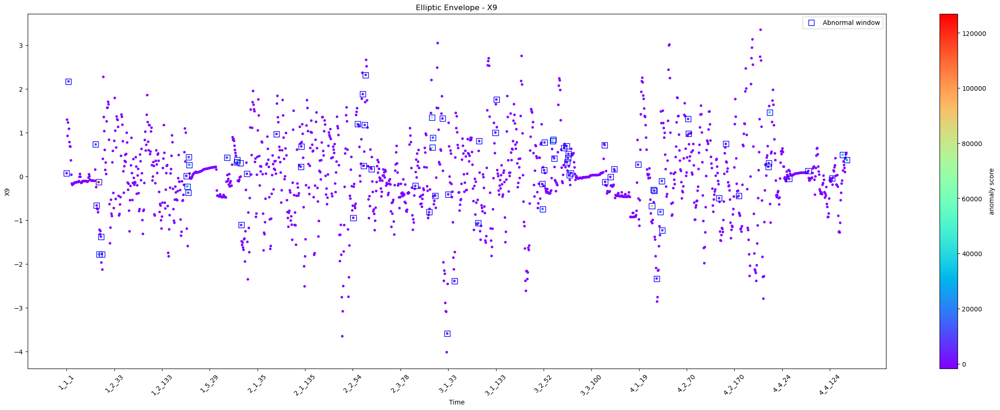

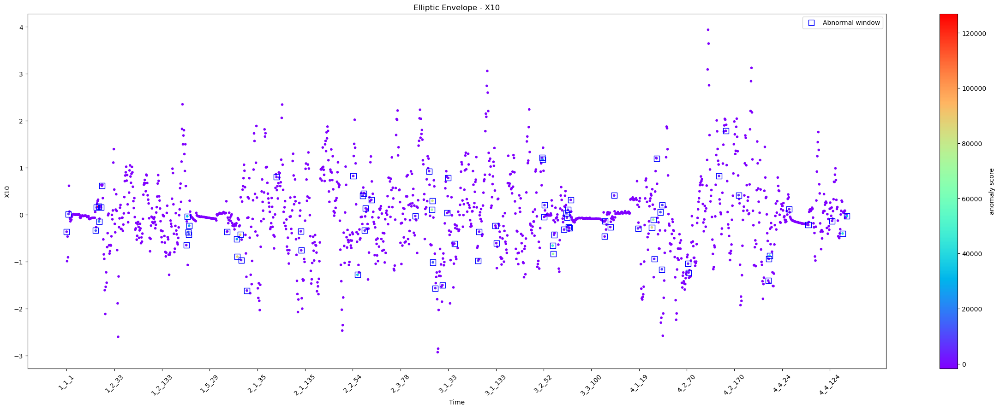

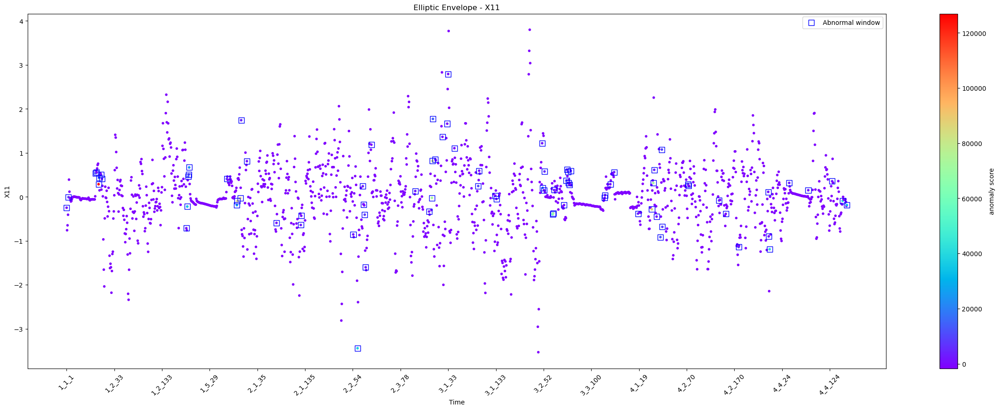

Detected abnormal windows: 82 / 1636

['1_1_1' '1_1_5' '1_1_62' '1_1_64' '1_1_68' '1_2_1' '1_2_5' '1_2_7'
 '1_3_3' '1_3_5' '1_4_1' '1_4_2' '1_4_3' '1_5_65' '1_5_86' '1_5_87'
 '1_5_93' '2_1_1' '2_1_13' '2_1_75' '2_1_126' '2_1_127' '2_2_55' '2_2_64'
 '2_2_75' '2_3_1' '2_3_3' '2_3_5' '2_3_17' '2_3_109' '2_3_138' '2_3_144'
 '2_3_145' '3_1_1' '3_1_6' '3_1_21' '3_1_31' '3_1_33' '3_1_46' '3_1_96'
 '3_1_98' '3_1_132' '3_1_134' '3_2_49' '3_2_50' '3_3_1' '3_3_2' '3_3_19'
 '3_3_20' '3_3_22' '3_3_43' '3_3_48' '3_3_49' '3_3_51' '3_3_52' '3_3_54'
 '3_3_57' '3_3_128' '3_3_129' '3_3_140' '3_3_148' '4_1_17' '4_1_46'
 '4_1_49' '4_2_2' '4_2_7' '4_2_15' '4_2_18' '4_2_19' '4_2_73' '4_2_74'
 '4_2_138' '4_2_152' '4_2_179' '4_3_60' '4_3_61' '4_3_63' '4_4_39'
 '4_4_79' '4_4_129' '4_4_151' '4_4_160']


COMPARING THE METHODS...



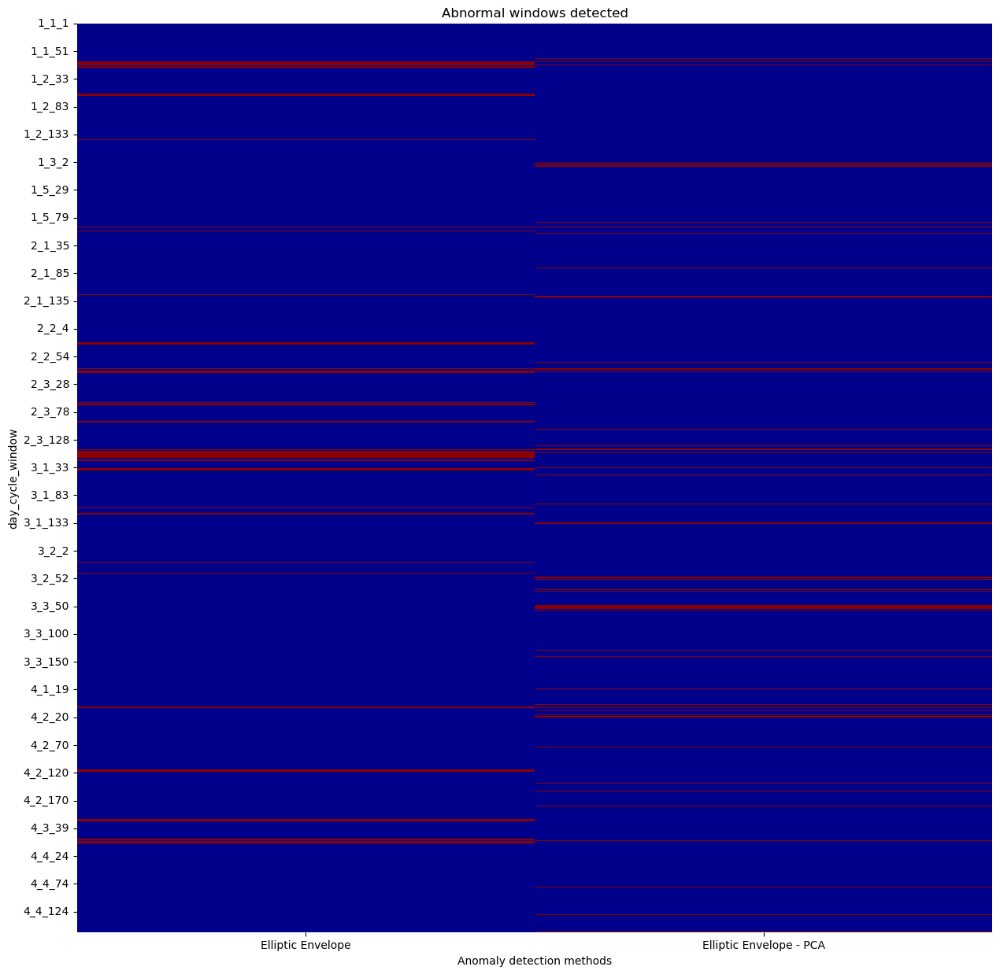

In [12]:
clf_name = 'Elliptic Envelope'
clf = EllipticEnvelope(contamination=0.05,random_state=42)
is_anomaly_elliptic, is_anomaly_elliptic_pca = pca_comparaison(clf_name,clf,df_means,parameters,df_pca,pca_components_kept)

In [12]:
# This code will give you the day_cycle_window values that are common to the anomalies detected by both approaches.
common_anomalies_elliptic = np.intersect1d(df_means['day_cycle_window'][is_anomaly_elliptic == -1],df_pca['day_cycle_window'][is_anomaly_elliptic_pca == -1])
print(f"{len(common_anomalies_elliptic)} windows are detected as anomalies by both approaches, when {clf_name} method is used. Here there are :\n{common_anomalies_elliptic}")

10 windows are detected as anomalies by both approaches, when Elliptic Envelope method is used. Here there are :
['1_2_1' '1_2_5' '1_2_7' '2_1_1' '2_2_75' '2_3_145' '2_3_5' '3_1_1'
 '3_1_6' '4_2_2']


We observe that **only 12% of the abnormal windows with the "average windows approach", keep being considered as anomalies with the "extra statistical features approach"**. What could be interesting for the expert is to have a deeper look at the 72 windows abnormal in the "average windows approach" only and at the 72 others in the "extra statistical features approach" to determine which of these two approaches seems more relevant for the task.

Additionnaly, we observe that **the abnormal windows are more dispersed in the "extra statistical features approach"**. This could be a strength of this approach when it comes to take into account natural variability. For instance, if one of the parameters represents the humidity content of air (which is important to predict contrails formation, frost...), it is normal that it is higher when flights take place in tropical regions than in temperate ones.

### 2nd method : using the Isolation Forest method

In [22]:
# Hyperparameters tuning (values can be changed !)
n_estimators = [5,10,100]
max_samples = [0.5, 0.75, 1.0]
contamination = [0.01, 0.05, 0.1]
max_features = [5, 8, 11]

# Iterating on hyperparameters values
for n in n_estimators:
    for sample in max_samples:
        for contam in contamination:
            for features in max_features:
                # Initializing model with current values of tested hyperparameters
                model = IsolationForest(n_estimators=n, max_samples=sample,
                                        contamination=contam, max_features=features,random_state=42)
                # Model fitting
                model.fit(df_pca[pca_components_kept])
                
                # Anomaly detection
                predictions = model.predict(df_pca[pca_components_kept])
                
                # Displaying results
                print(f"n_estimators={n}, max_samples={sample}, contamination={contam}, max_features={features}")
                print(f"Detected anomalies: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

n_estimators=5, max_samples=0.5, contamination=0.01, max_features=5
Detected anomalies: 17 / 1636

n_estimators=5, max_samples=0.5, contamination=0.01, max_features=8
Detected anomalies: 16 / 1636

n_estimators=5, max_samples=0.5, contamination=0.01, max_features=11
Detected anomalies: 17 / 1636

n_estimators=5, max_samples=0.5, contamination=0.05, max_features=5
Detected anomalies: 82 / 1636

n_estimators=5, max_samples=0.5, contamination=0.05, max_features=8
Detected anomalies: 82 / 1636

n_estimators=5, max_samples=0.5, contamination=0.05, max_features=11
Detected anomalies: 82 / 1636

n_estimators=5, max_samples=0.5, contamination=0.1, max_features=5
Detected anomalies: 164 / 1636

n_estimators=5, max_samples=0.5, contamination=0.1, max_features=8
Detected anomalies: 164 / 1636

n_estimators=5, max_samples=0.5, contamination=0.1, max_features=11
Detected anomalies: 164 / 1636

n_estimators=5, max_samples=0.75, contamination=0.01, max_features=5
Detected anomalies: 17 / 1636

n_esti

Thus, the same hyperparameters are kept for the "extra statistical features approach". Hence, `clf_pca = clf`

DETECTING ANOMALIES WITHOUT PCA...



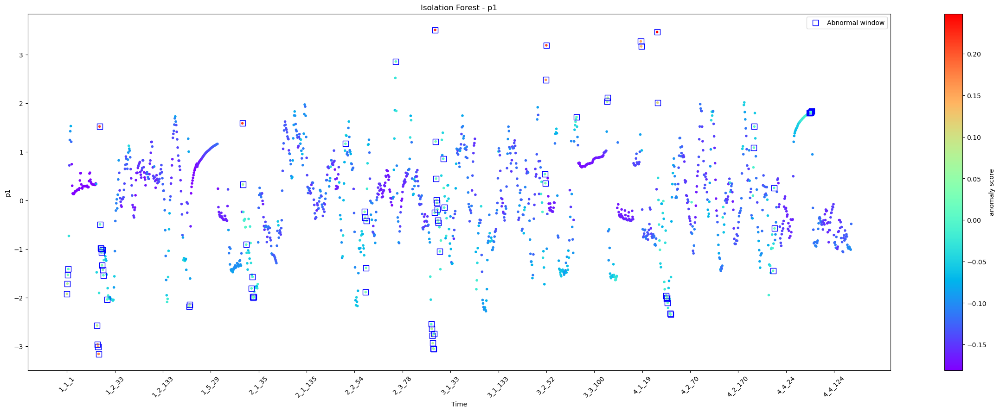

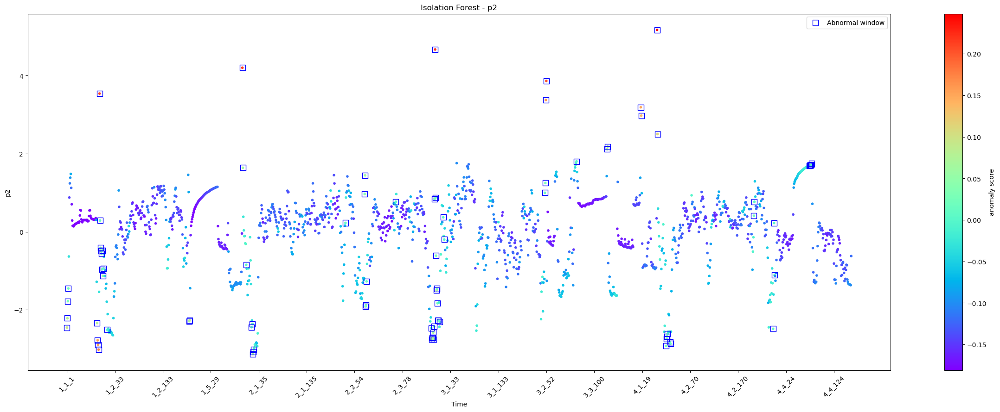

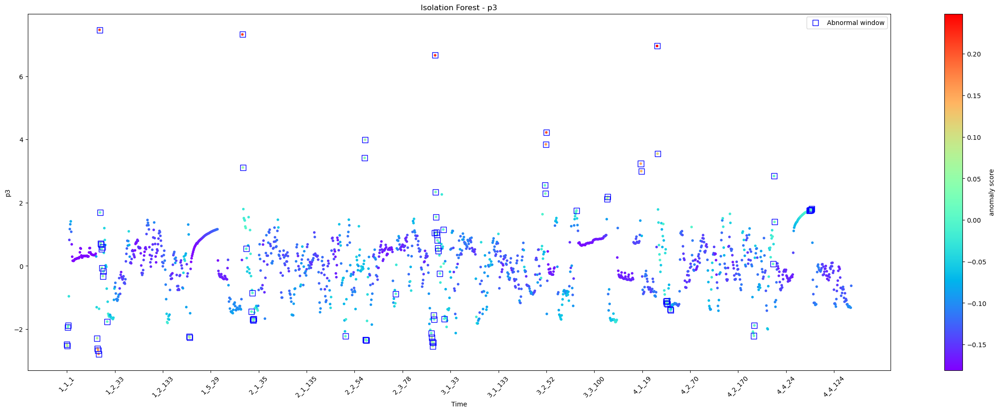

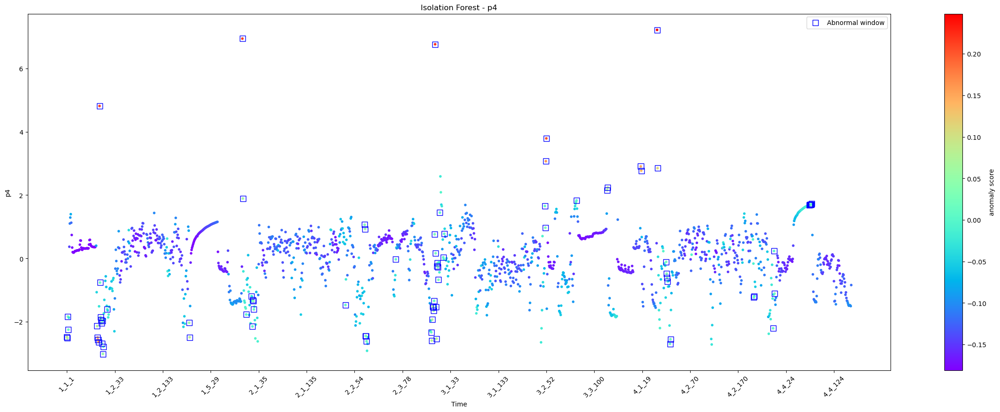

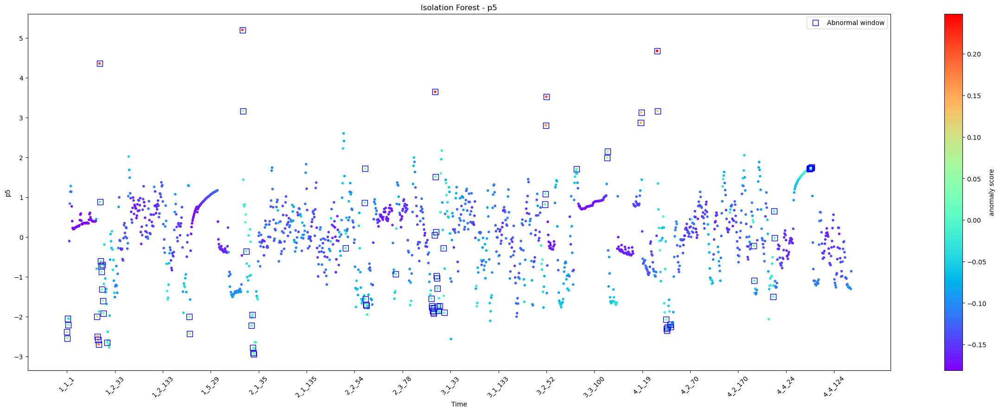

...

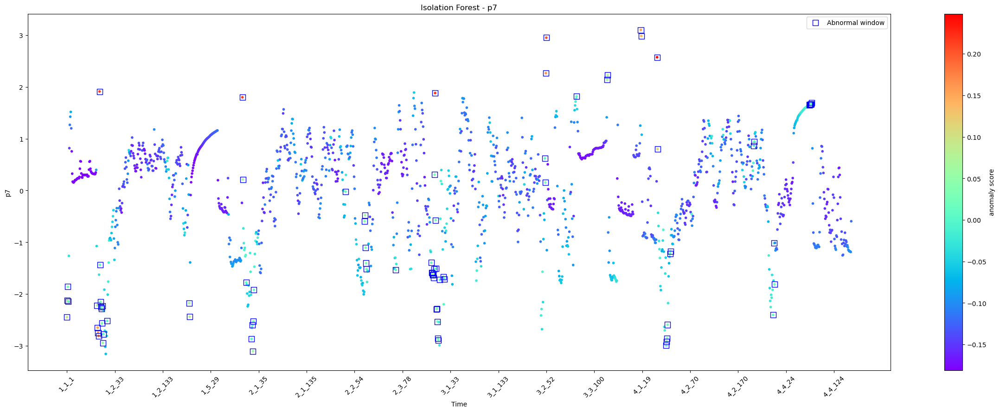

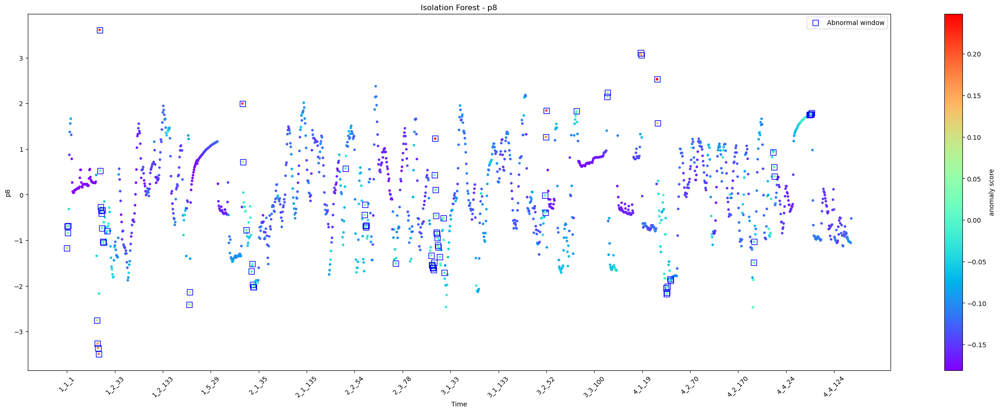

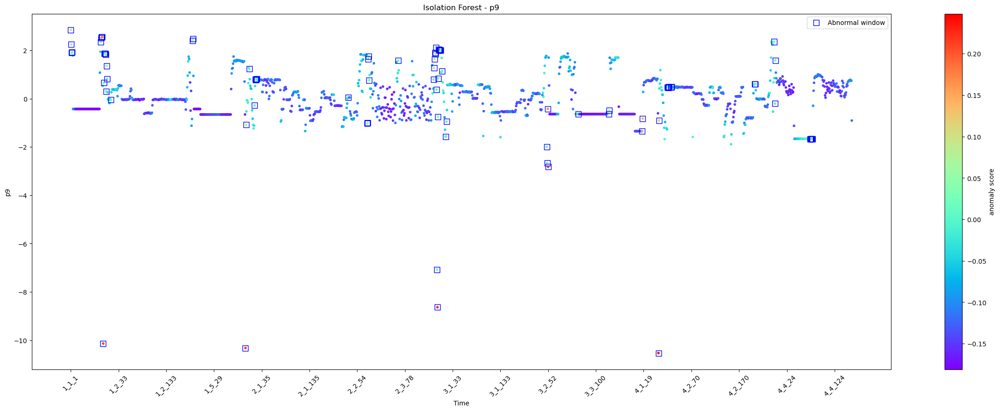

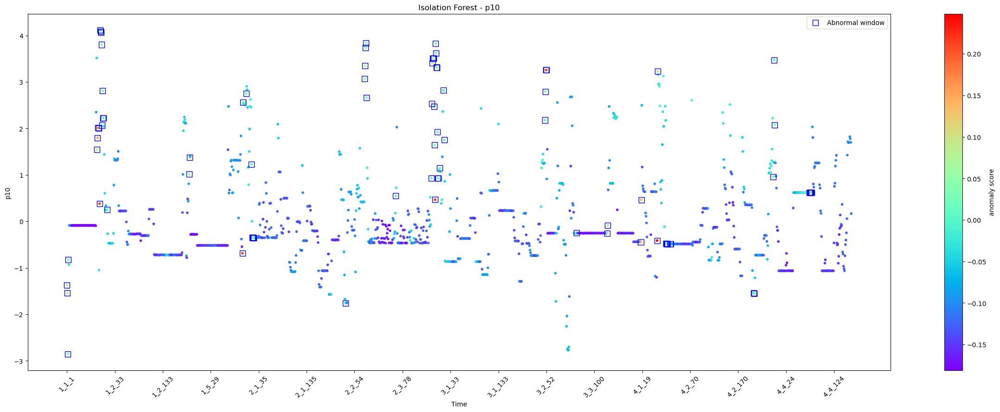

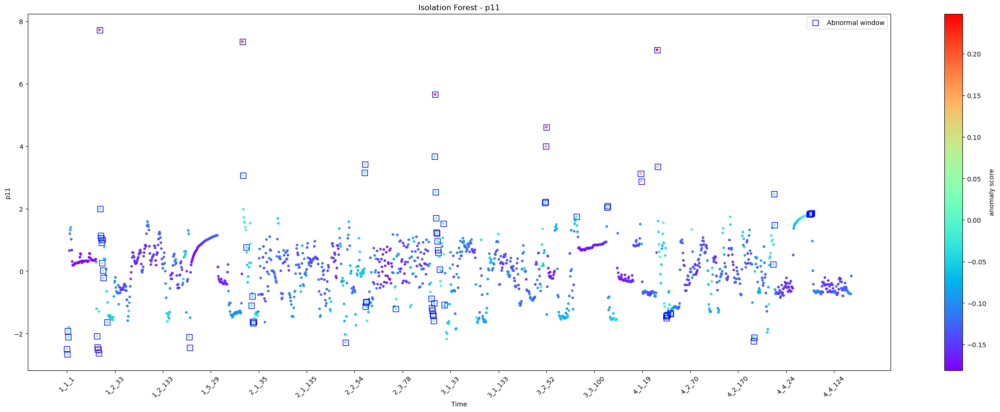

Detected abnormal windows: 82 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_4' '1_1_64' '1_1_65' '1_1_66' '1_1_67'
 '1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_9'
 '1_2_17' '1_4_1' '1_4_2' '2_1_1' '2_1_2' '2_1_9' '2_1_20' '2_1_22'
 '2_1_23' '2_1_24' '2_1_25' '2_2_35' '2_2_75' '2_2_76' '2_3_1' '2_3_2'
 '2_3_3' '2_3_64' '2_3_138' '2_3_139' '2_3_140' '2_3_141' '2_3_142'
 '2_3_143' '2_3_144' '2_3_145' '3_1_1' '3_1_2' '3_1_3' '3_1_4' '3_1_5'
 '3_1_6' '3_1_7' '3_1_8' '3_1_11' '3_1_18' '3_1_20' '3_2_49' '3_2_50'
 '3_2_51' '3_2_52' '3_3_63' '3_3_127' '3_3_128' '4_1_16' '4_1_17' '4_2_1'
 '4_2_2' '4_2_20' '4_2_21' '4_2_22' '4_2_23' '4_2_28' '4_2_29' '4_3_22'
 '4_3_23' '4_3_62' '4_3_64' '4_3_65' '4_4_73' '4_4_74' '4_4_75' '4_4_76'
 '4_4_77' '4_4_78']


DETECTING ANOMALIES WITH PCA...



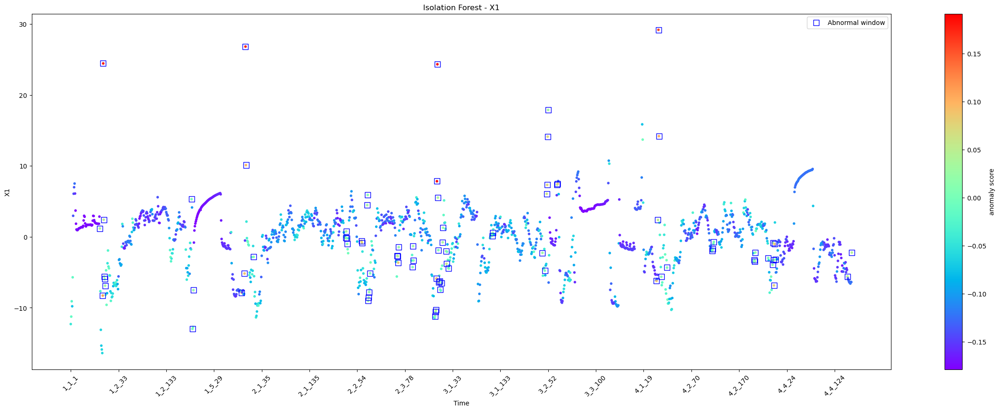

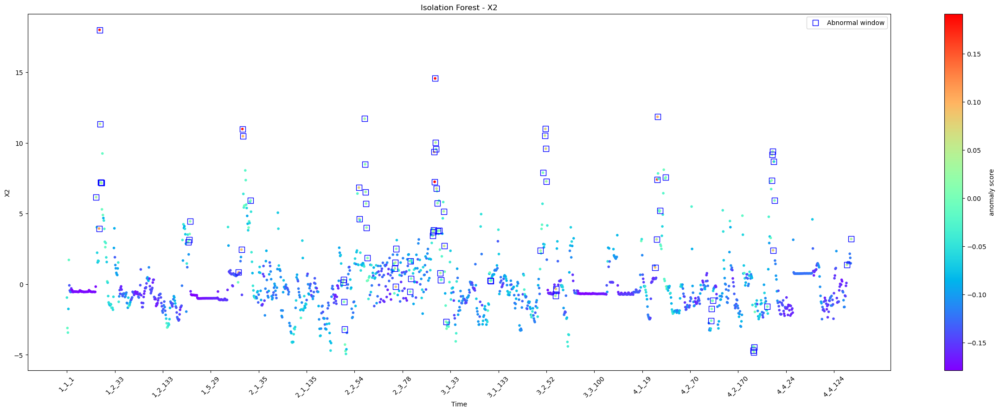

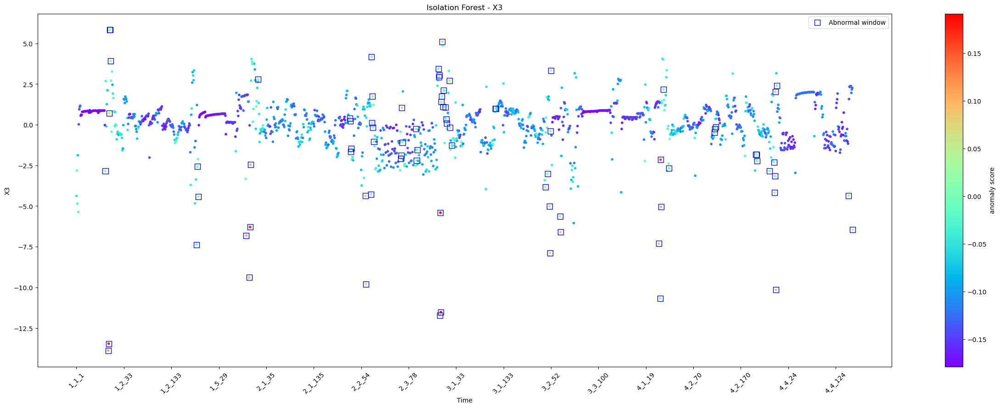

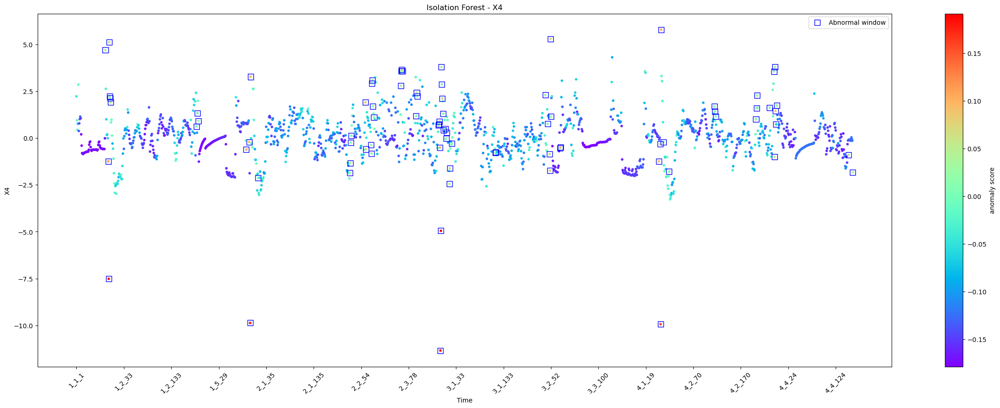

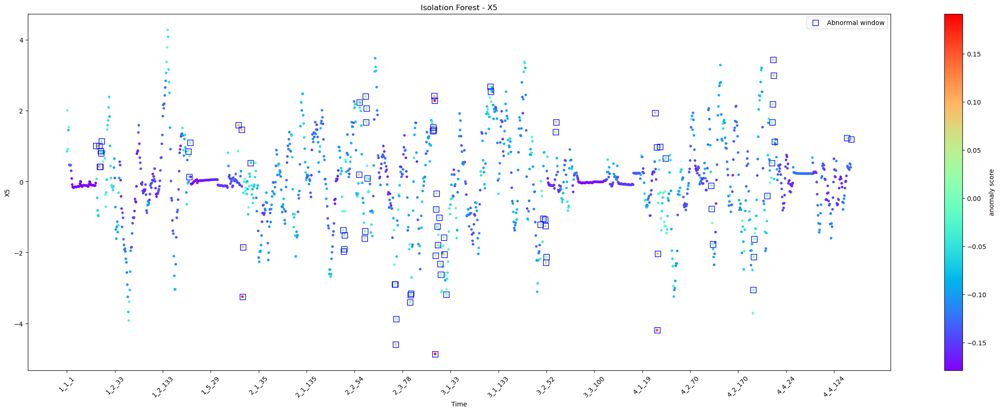

...

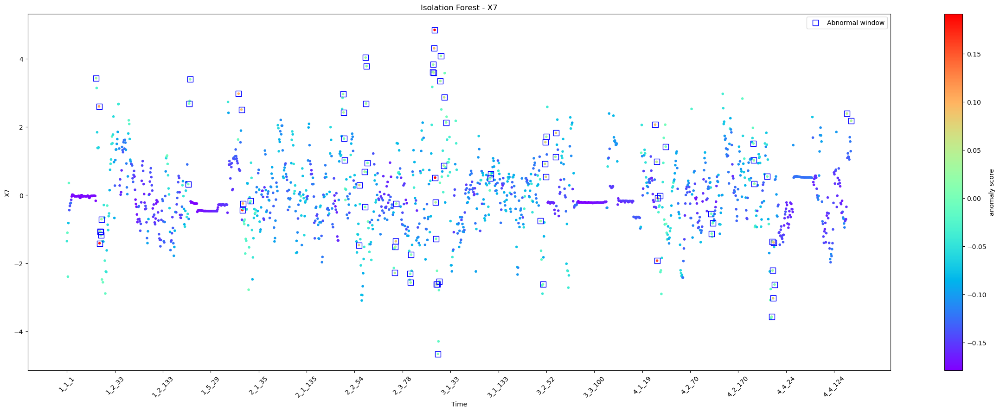

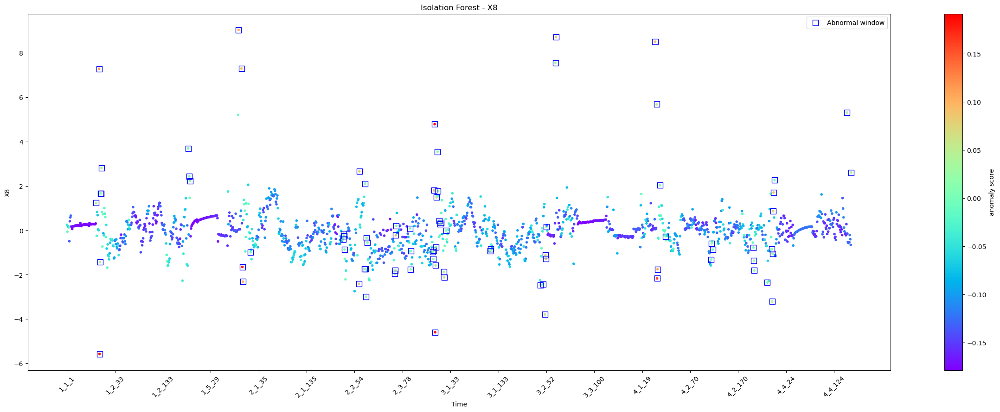

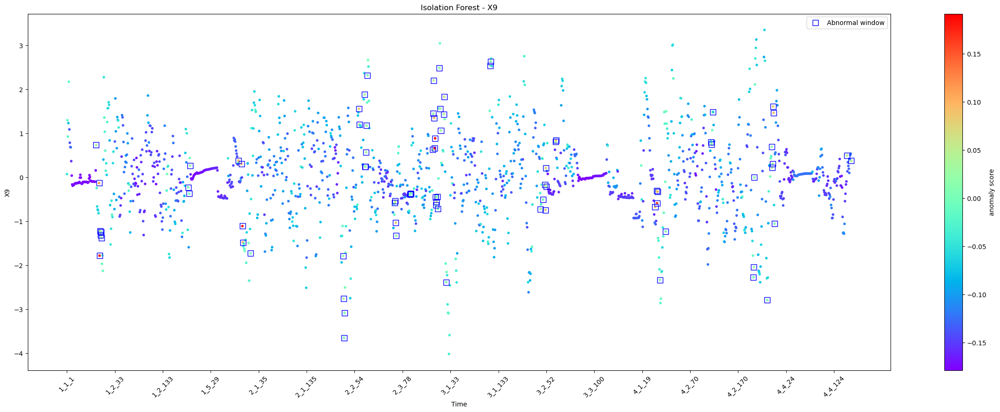

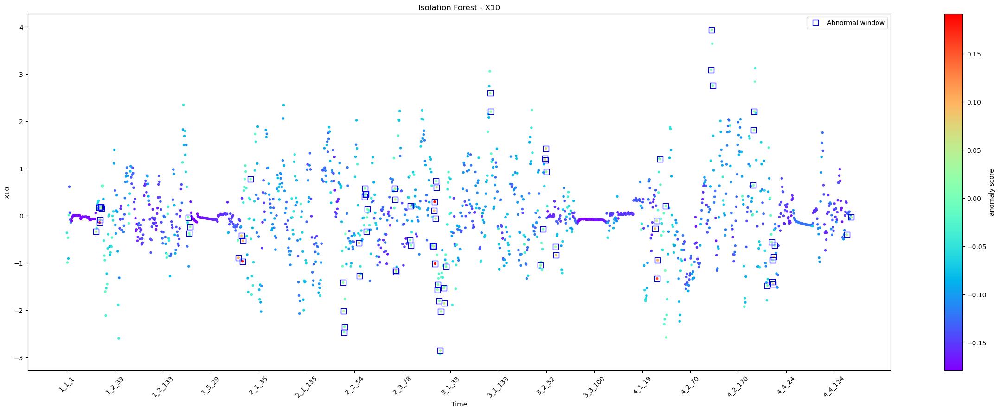

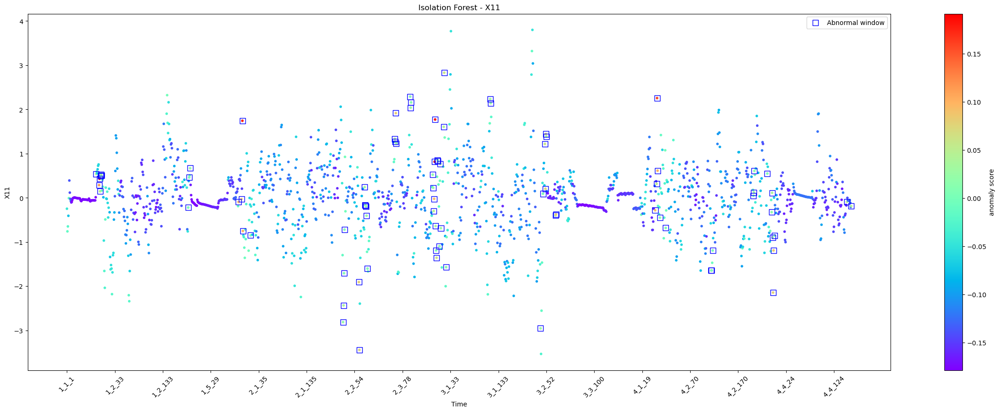

Detected abnormal windows: 82 / 1636

['1_1_62' '1_1_68' '1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_3_5' '1_4_1'
 '1_4_3' '1_5_87' '1_5_93' '2_1_1' '2_1_2' '2_1_18' '2_2_30' '2_2_31'
 '2_2_32' '2_2_33' '2_2_63' '2_2_64' '2_2_75' '2_2_76' '2_3_1' '2_3_2'
 '2_3_3' '2_3_5' '2_3_62' '2_3_63' '2_3_64' '2_3_65' '2_3_94' '2_3_95'
 '2_3_96' '2_3_141' '2_3_142' '2_3_143' '2_3_144' '2_3_145' '3_1_1'
 '3_1_2' '3_1_3' '3_1_4' '3_1_6' '3_1_7' '3_1_10' '3_1_12' '3_1_13'
 '3_1_19' '3_1_20' '3_1_24' '3_1_116' '3_1_117' '3_2_40' '3_2_45' '3_2_49'
 '3_2_50' '3_2_51' '3_2_52' '3_3_19' '3_3_20' '4_1_46' '4_1_49' '4_2_1'
 '4_2_2' '4_2_7' '4_2_19' '4_2_114' '4_2_115' '4_2_117' '4_3_21' '4_3_22'
 '4_3_23' '4_3_50' '4_3_59' '4_3_60' '4_3_61' '4_3_62' '4_3_63' '4_3_65'
 '4_4_151' '4_4_160']


COMPARING THE METHODS...



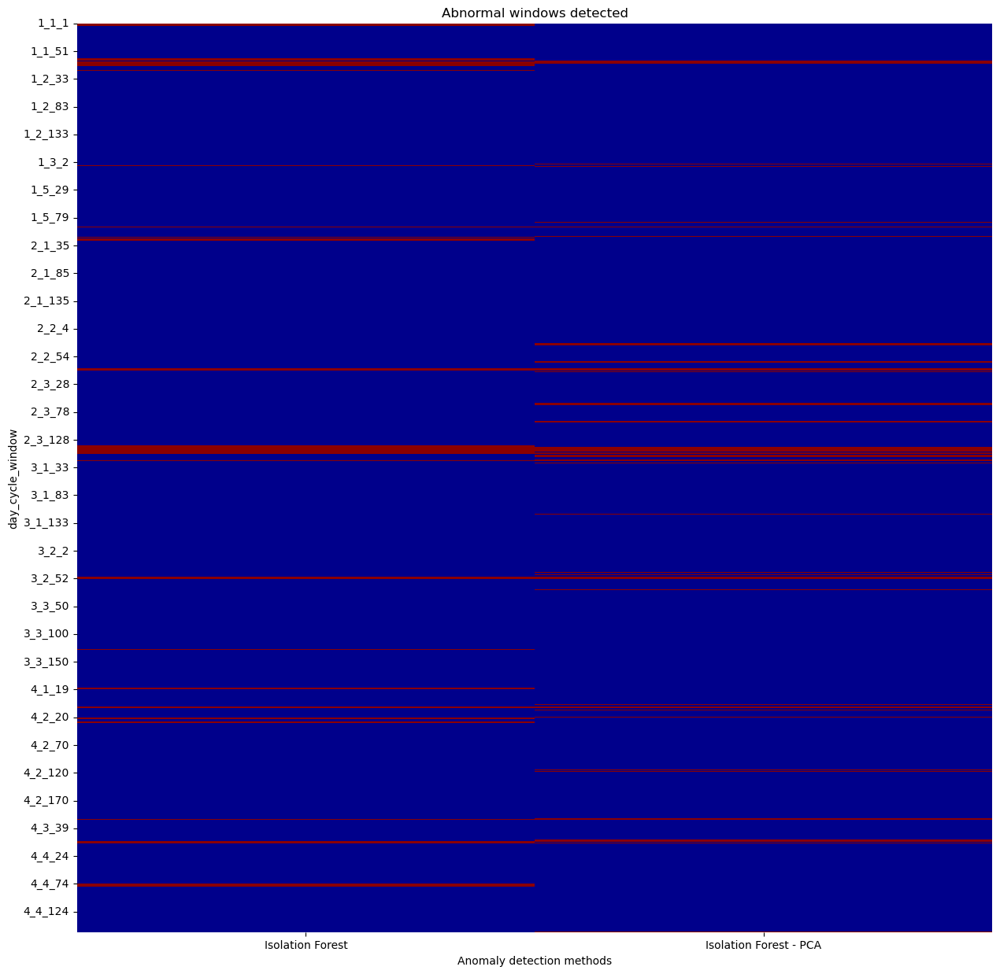

In [13]:
clf_name = 'Isolation Forest'
clf = IsolationForest(n_estimators=100, contamination=0.05,random_state=42)
is_anomaly_isoforest, is_anomaly_isoforest_pca = pca_comparaison(clf_name,clf,df_means,parameters,df_pca,pca_components_kept)

In [14]:
# This code will give you the day_cycle_window values that are common to the anomalies detected by both approaches.
common_anomalies_isoforest = np.intersect1d(df_means['day_cycle_window'][is_anomaly_isoforest == -1],df_pca['day_cycle_window'][is_anomaly_isoforest_pca == -1])
print(f"{len(common_anomalies_isoforest)} windows are detected as anomalies by both approaches, when {clf_name} method is used. Here there are :\n{common_anomalies_isoforest}")

36 windows are detected as anomalies by both approaches, when Isolation Forest method is used. Here there are :
['1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_4_1' '2_1_1' '2_1_2' '2_2_75'
 '2_2_76' '2_3_1' '2_3_141' '2_3_142' '2_3_143' '2_3_144' '2_3_145'
 '2_3_2' '2_3_3' '2_3_64' '3_1_1' '3_1_2' '3_1_20' '3_1_3' '3_1_4' '3_1_6'
 '3_1_7' '3_2_49' '3_2_50' '3_2_51' '3_2_52' '4_2_1' '4_2_2' '4_3_22'
 '4_3_23' '4_3_62' '4_3_65']


We observe that **44% of the abnormal windows with the "average windows approach", keep being considered as anomalies with the "extra statistical features approach"**. Moreover, abnormal windows with this method are less dispersed than with the Elliptic Enveloppe one.

What could be interesting for the expert would be to analyze the feature importance with this method in order to determine wether the criteria to assess some window abnormality remain the same with the "average windows approach" and with the "extra statistical features approach".

### 3rd method : using the Local Outlier Factor (LOF) method

In [15]:
# Hyperparameters tuning
contamination = [0.01, 0.05, 0.1]
n_neighbors = [5,10,15,30,50,100]

# Iterating on hyperparameters values
for n in n_neighbors:
    for c in contamination:
        # Initializing model with current tested hyperparameters values
        model = LocalOutlierFactor(n_neighbors=n, contamination=c, novelty=False)

        # Model fitting and anomaly detection
        predictions = model.fit_predict(df_pca[pca_components_kept])

        # Displaying results
        print(f"n_neighbors={n}, contamination={c}")
        print(f"Anomalies détectées: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

n_neighbors=5, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=5, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=5, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=10, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=10, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=10, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=15, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=15, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=15, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=30, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=30, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=30, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=50, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=50, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=50, contamination=0.1
Anomalies détectées: 164 / 1636

Thus, the same hyperparameters are kept for the "extra statistical features approach". Hence, `clf_pca = clf`

DETECTING ANOMALIES WITHOUT PCA...



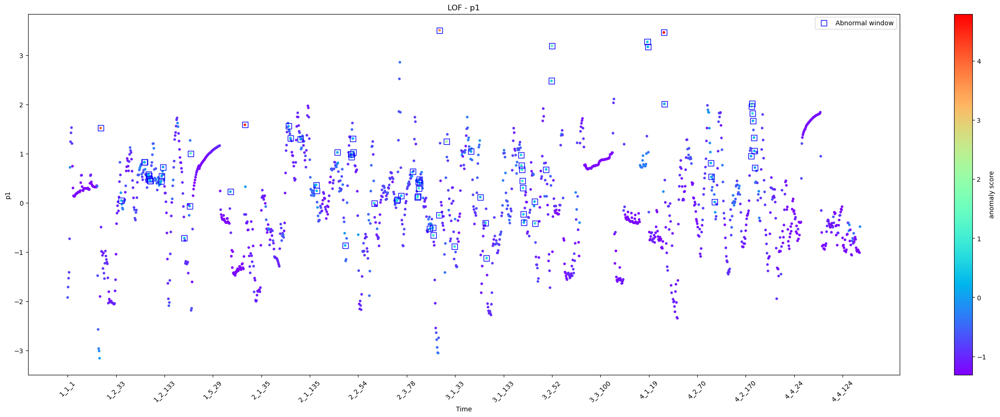

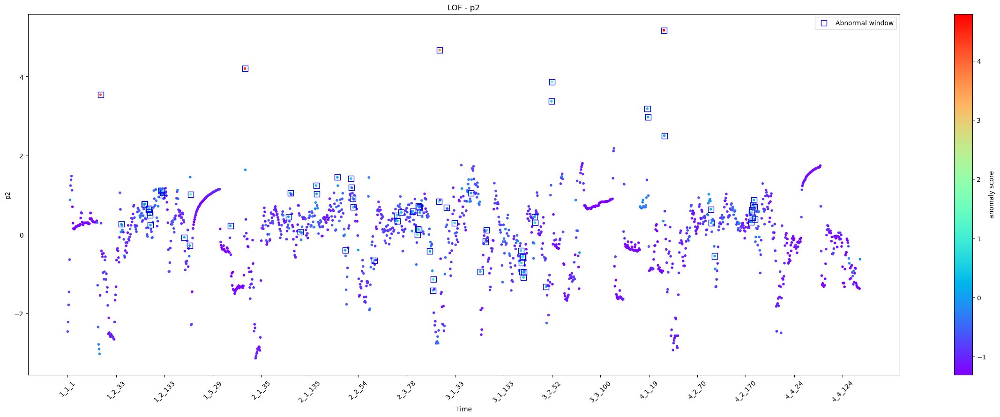

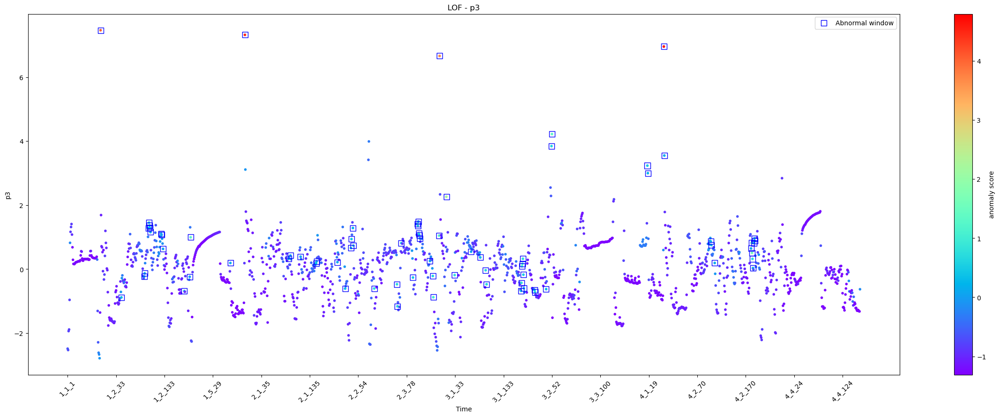

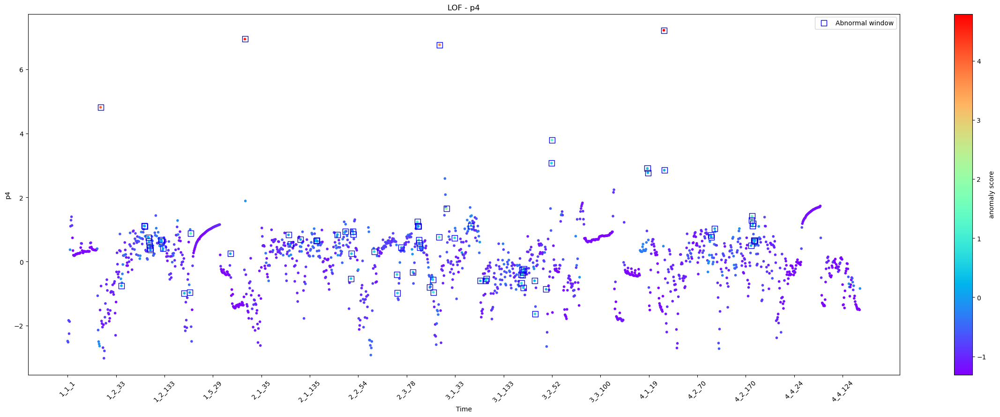

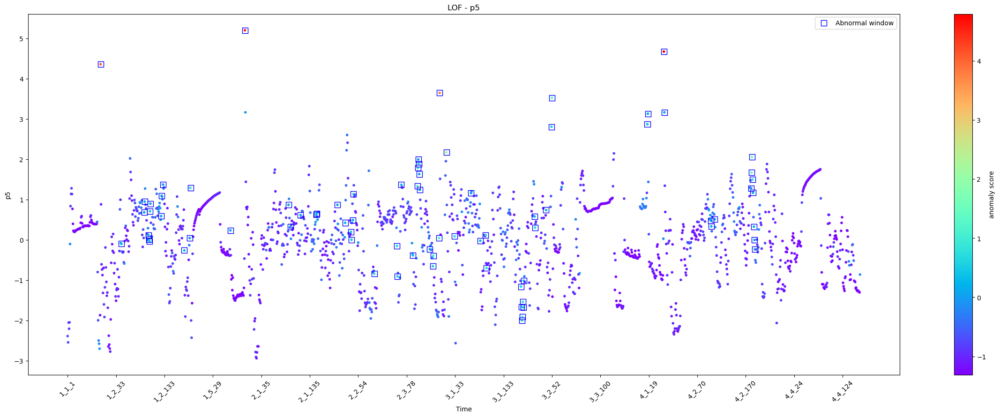

...

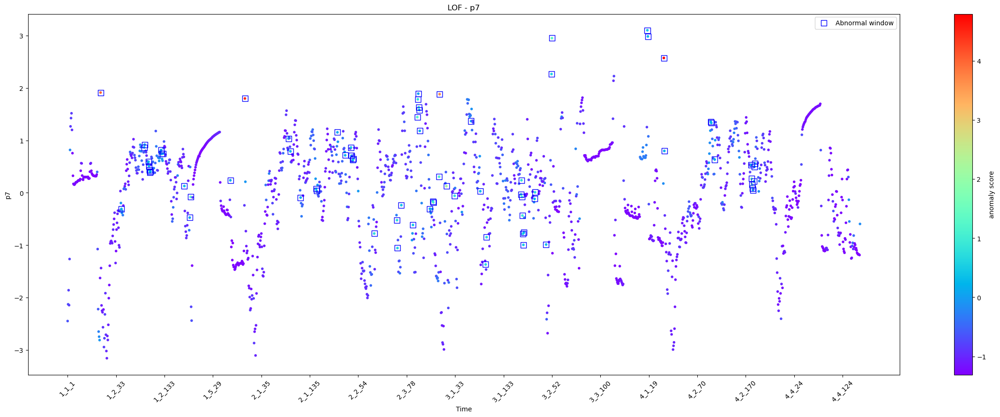

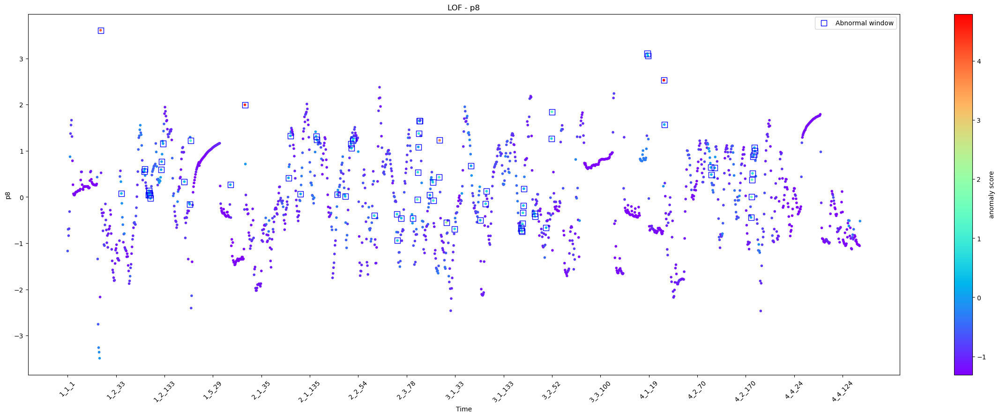

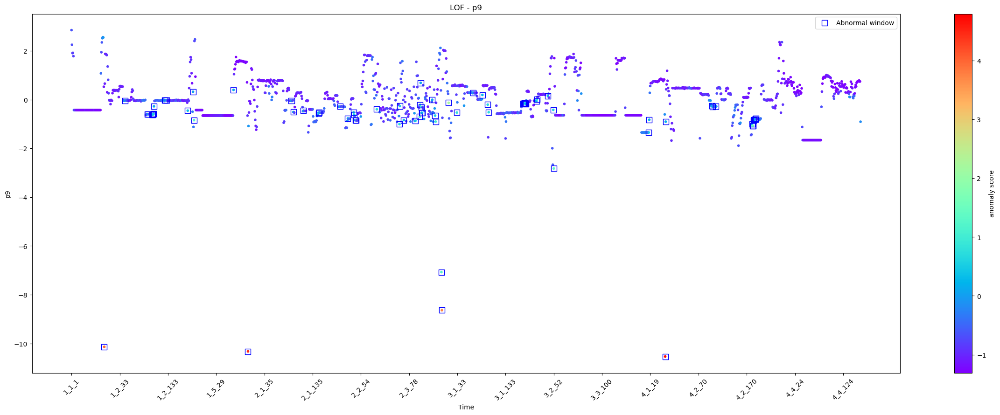

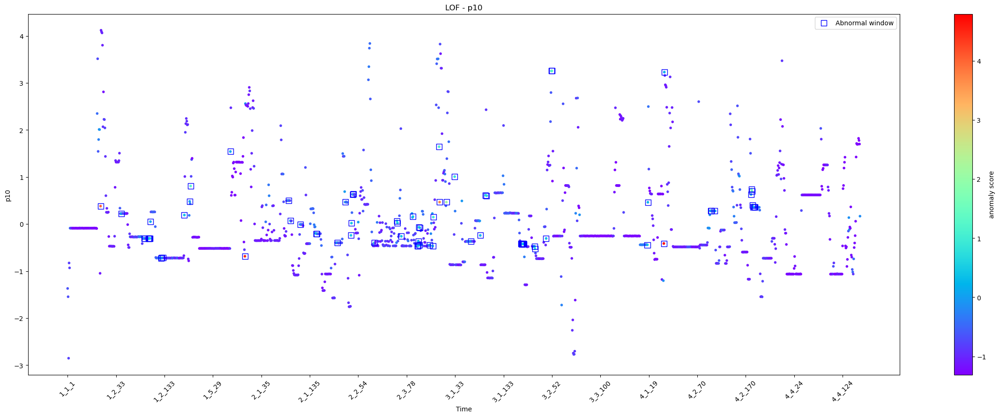

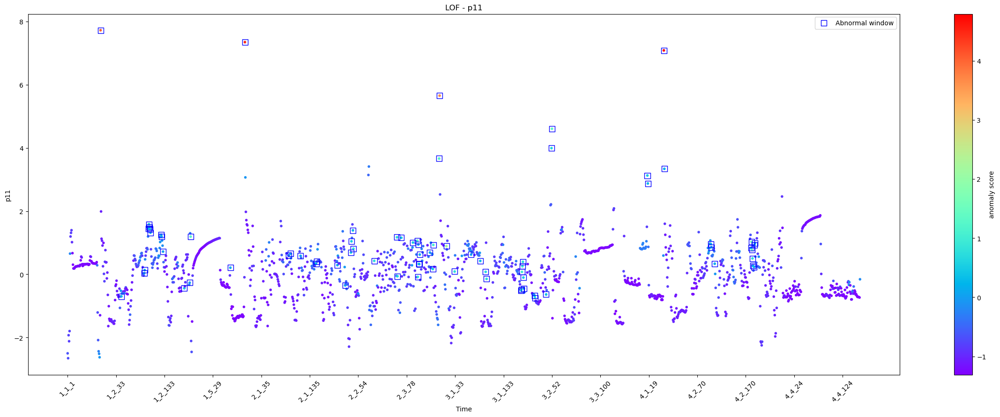

Detected abnormal windows: 77 / 1636

['1_2_1' '1_2_44' '1_2_91' '1_2_92' '1_2_100' '1_2_101' '1_2_102'
 '1_2_103' '1_2_104' '1_2_126' '1_2_127' '1_2_130' '1_2_174' '1_3_4'
 '1_3_6' '1_5_65' '2_1_1' '2_1_91' '2_1_95' '2_1_116' '2_1_148' '2_1_149'
 '2_2_11' '2_2_27' '2_2_39' '2_2_40' '2_2_43' '2_2_44' '2_3_11' '2_3_58'
 '2_3_59' '2_3_67' '2_3_91' '2_3_100' '2_3_101' '2_3_102' '2_3_103'
 '2_3_104' '2_3_105' '2_3_126' '2_3_132' '2_3_133' '2_3_145' '3_1_1'
 '3_1_15' '3_1_32' '3_1_66' '3_1_85' '3_1_96' '3_1_98' '3_1_169' '3_1_170'
 '3_1_171' '3_1_172' '3_1_173' '3_1_174' '3_1_175' '3_2_16' '3_2_17'
 '3_2_40' '3_2_51' '3_2_52' '4_1_16' '4_1_17' '4_2_1' '4_2_2' '4_2_98'
 '4_2_99' '4_2_106' '4_2_181' '4_3_1' '4_3_2' '4_3_3' '4_3_4' '4_3_6'
 '4_3_7' '4_3_8']


DETECTING ANOMALIES WITH PCA...



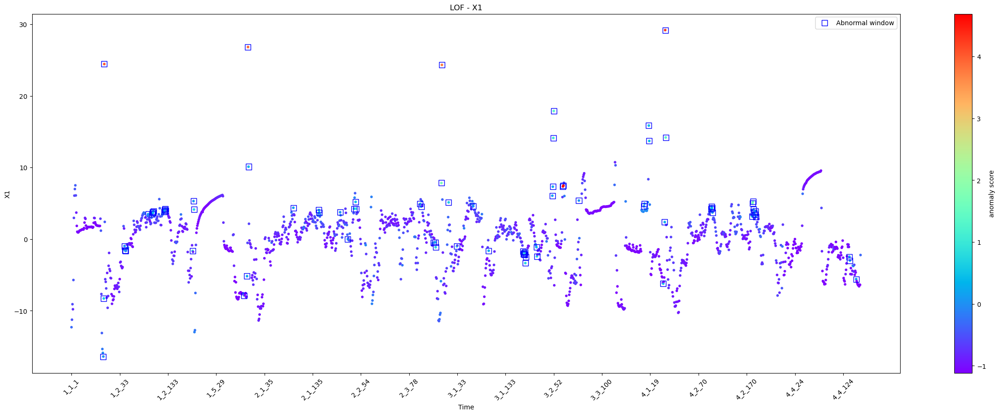

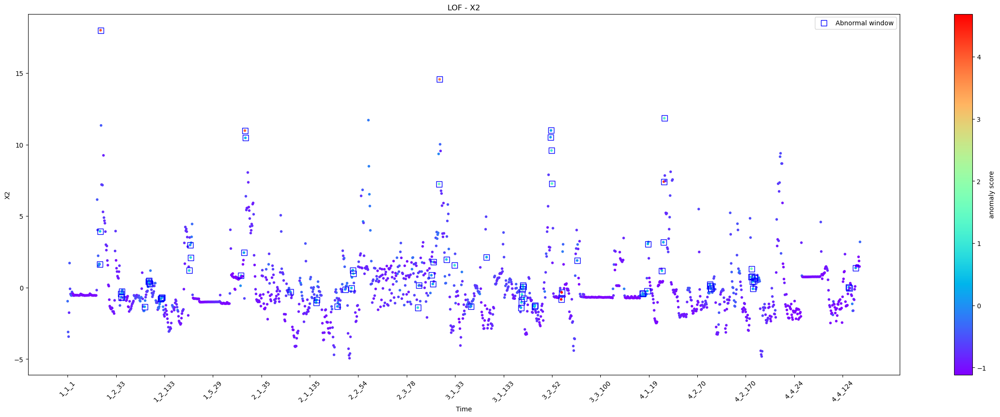

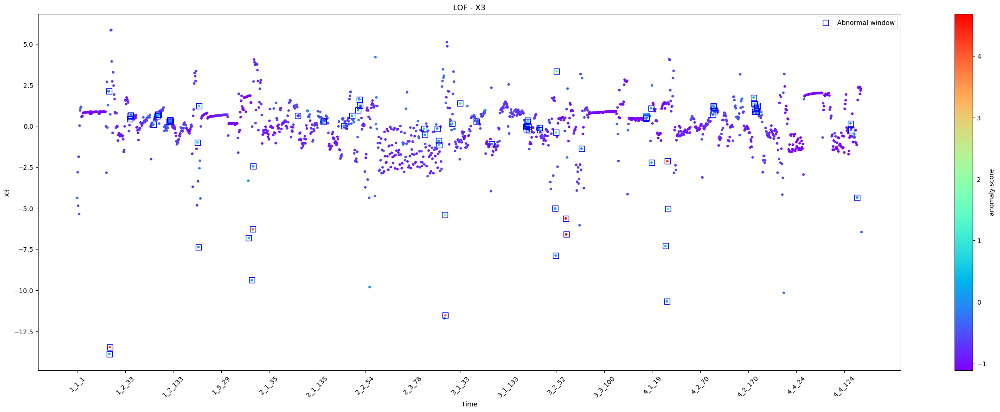

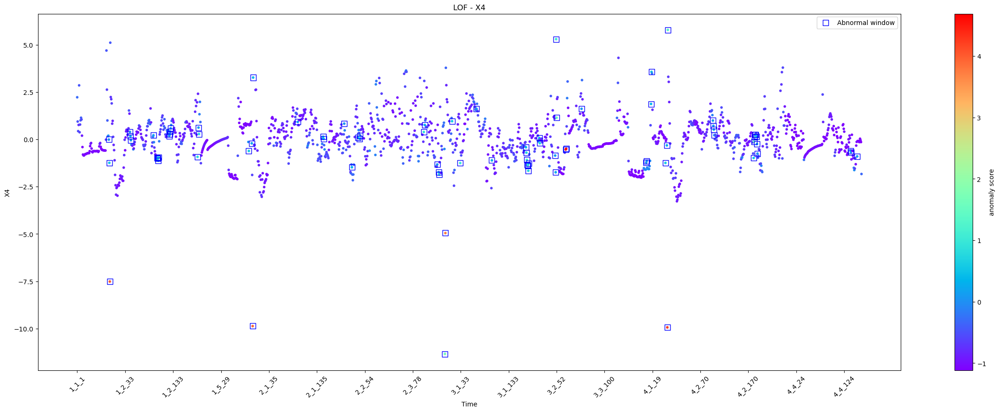

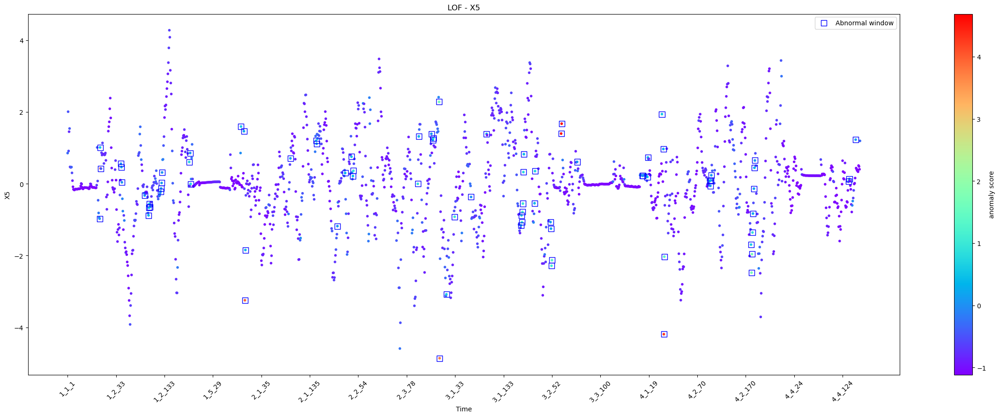

...

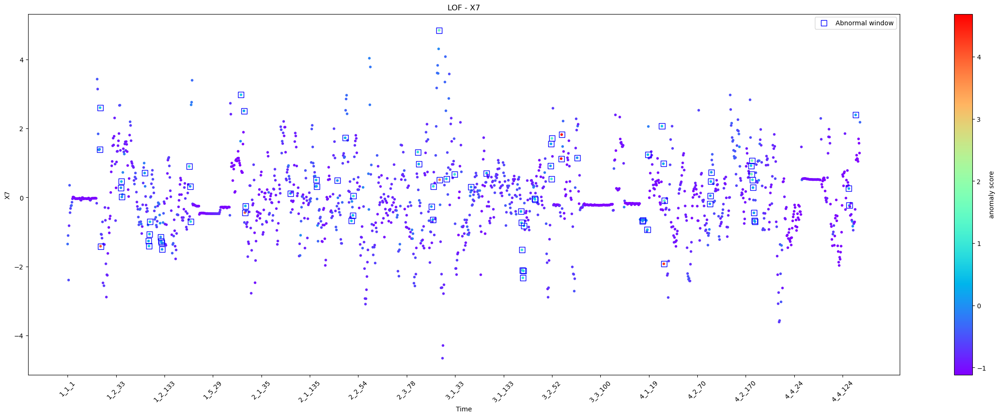

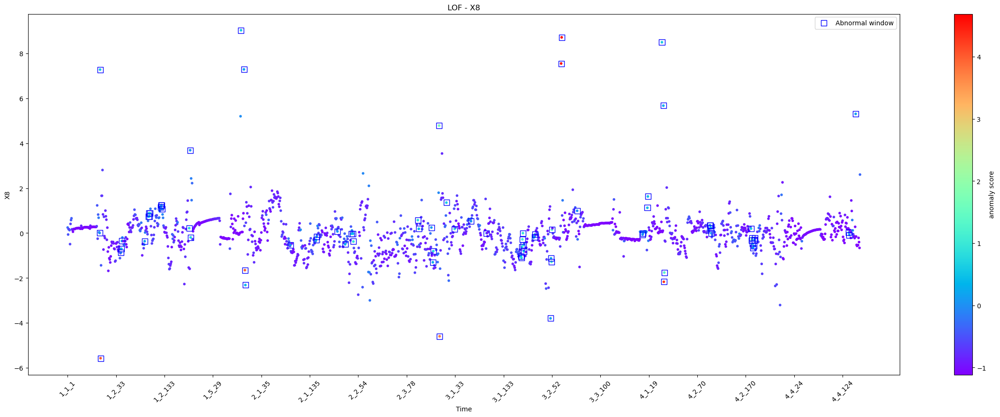

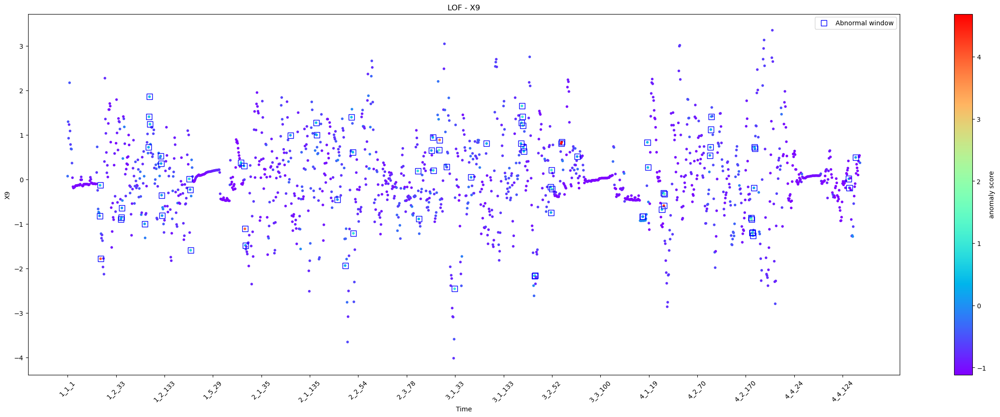

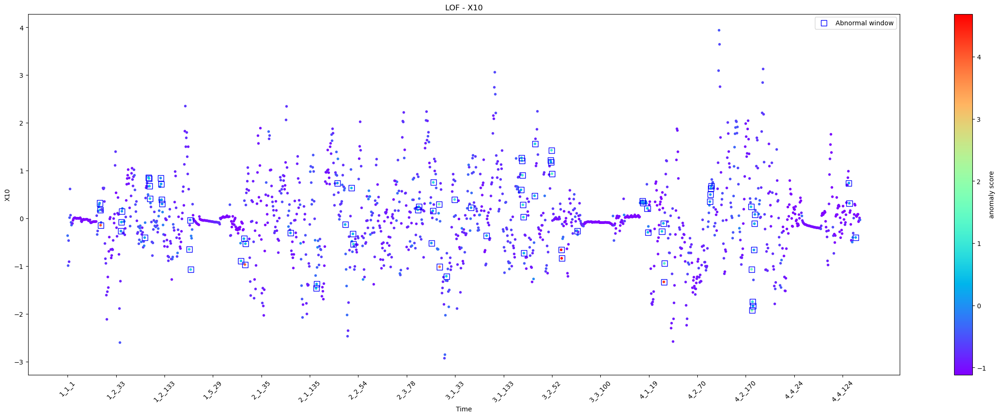

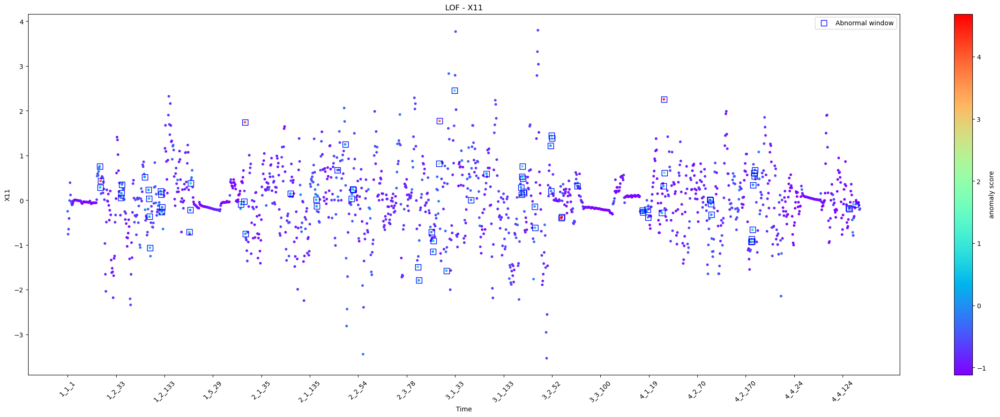

Detected abnormal windows: 80 / 1636

['1_1_67' '1_1_68' '1_2_1' '1_2_43' '1_2_44' '1_2_45' '1_2_92' '1_2_100'
 '1_2_101' '1_2_102' '1_2_103' '1_2_125' '1_2_126' '1_2_127' '1_2_128'
 '1_3_3' '1_3_5' '1_3_6' '1_5_87' '1_5_93' '2_1_1' '2_1_2' '2_1_95'
 '2_1_148' '2_1_149' '2_2_11' '2_2_27' '2_2_40' '2_2_43' '2_2_44'
 '2_3_101' '2_3_103' '2_3_129' '2_3_132' '2_3_133' '2_3_145' '3_1_1'
 '3_1_15' '3_1_32' '3_1_66' '3_1_98' '3_1_169' '3_1_170' '3_1_171'
 '3_1_172' '3_1_173' '3_1_174' '3_1_175' '3_2_16' '3_2_17' '3_2_49'
 '3_2_50' '3_2_51' '3_2_52' '3_3_19' '3_3_20' '3_3_52' '4_1_6' '4_1_7'
 '4_1_16' '4_1_17' '4_1_46' '4_1_49' '4_2_1' '4_2_2' '4_2_96' '4_2_97'
 '4_2_98' '4_2_99' '4_2_181' '4_3_1' '4_3_2' '4_3_3' '4_3_4' '4_3_6'
 '4_3_7' '4_3_8' '4_4_137' '4_4_138' '4_4_151']


COMPARING THE METHODS...



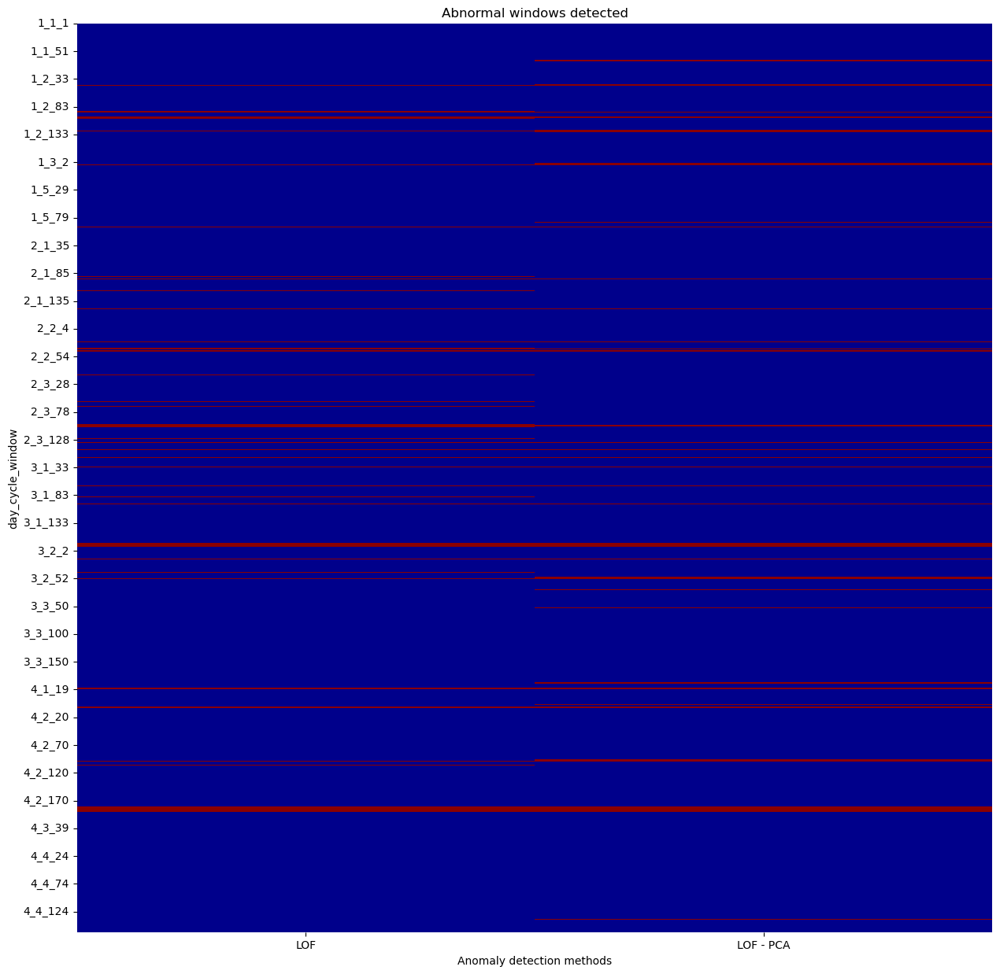

In [15]:
clf_name = 'LOF'
clf = LocalOutlierFactor(n_neighbors=50, contamination=0.05, novelty=True)
is_anomaly_lof, is_anomaly_lof_pca = pca_comparaison(clf_name,clf,df_means,parameters,df_pca,pca_components_kept)

In [16]:
# This code will give you the day_cycle_window values that are common to the anomalies detected by both approaches.
common_anomalies_lof = np.intersect1d(df_means['day_cycle_window'][is_anomaly_lof == -1],df_pca['day_cycle_window'][is_anomaly_lof_pca == -1])
print(f"{len(common_anomalies_lof)} windows are detected as anomalies by both approaches, when {clf_name} method is used. Here there are :\n{common_anomalies_lof}")

54 windows are detected as anomalies by both approaches, when LOF method is used. Here there are :
['1_2_1' '1_2_100' '1_2_101' '1_2_102' '1_2_103' '1_2_126' '1_2_127'
 '1_2_44' '1_2_92' '1_3_6' '2_1_1' '2_1_148' '2_1_149' '2_1_95' '2_2_11'
 '2_2_27' '2_2_40' '2_2_43' '2_2_44' '2_3_101' '2_3_103' '2_3_132'
 '2_3_133' '2_3_145' '3_1_1' '3_1_15' '3_1_169' '3_1_170' '3_1_171'
 '3_1_172' '3_1_173' '3_1_174' '3_1_175' '3_1_32' '3_1_66' '3_1_98'
 '3_2_16' '3_2_17' '3_2_51' '3_2_52' '4_1_16' '4_1_17' '4_2_1' '4_2_181'
 '4_2_2' '4_2_98' '4_2_99' '4_3_1' '4_3_2' '4_3_3' '4_3_4' '4_3_6' '4_3_7'
 '4_3_8']


We observe that **66% of the abnormal windows with the "average windows approach", keep being considered as anomalies with the "extra statistical features approach"**. Is this an indication that averaging the parameters on each windows allows the detection of most anomalies ? An in-depth analysis of the results from the expert is needed to answer properly.

### 4th method : using the One Class Support Vector Machine (SVM) method

In [20]:
# Hyperparameters tuning
nu = [0.01, 0.05, 0.1]
gamma = ['auto',0.01,0.05,0.1]

# Iterating on hyperparameters values
for n in nu:
    for g in gamma:
        # Initializing model with current values of hyperparameters
        model = OneClassSVM(nu=n, kernel="rbf", gamma=g)
        
        # Training model
        model.fit(df_pca[pca_components_kept])

        # Anomaly prediction
        predictions = model.predict(df_pca[pca_components_kept])

        # Displaying results
        print(f"nu={n}, gamma={g}")
        print(f"Detected anomalies: {np.sum(predictions == -1)} / {df_pca.shape[0]-1}\n")

nu=0.01, gamma=auto
Detected anomalies: 136 / 1636

nu=0.01, gamma=0.01
Detected anomalies: 20 / 1636

nu=0.01, gamma=0.05
Detected anomalies: 81 / 1636

nu=0.01, gamma=0.1
Detected anomalies: 157 / 1636

nu=0.05, gamma=auto
Detected anomalies: 142 / 1636

nu=0.05, gamma=0.01
Detected anomalies: 79 / 1636

nu=0.05, gamma=0.05
Detected anomalies: 93 / 1636

nu=0.05, gamma=0.1
Detected anomalies: 151 / 1636

nu=0.1, gamma=auto
Detected anomalies: 176 / 1636

nu=0.1, gamma=0.01
Detected anomalies: 162 / 1636

nu=0.1, gamma=0.05
Detected anomalies: 169 / 1636

nu=0.1, gamma=0.1
Detected anomalies: 181 / 1636



Thus, we need to modify the hyperparameters to keep the same proportion of anomalies detected as in the "average window approach". Hence, we set `gamma = 0.01` (versus `gamma = 'auto'` in the "average window approach").

DETECTING ANOMALIES WITHOUT PCA...



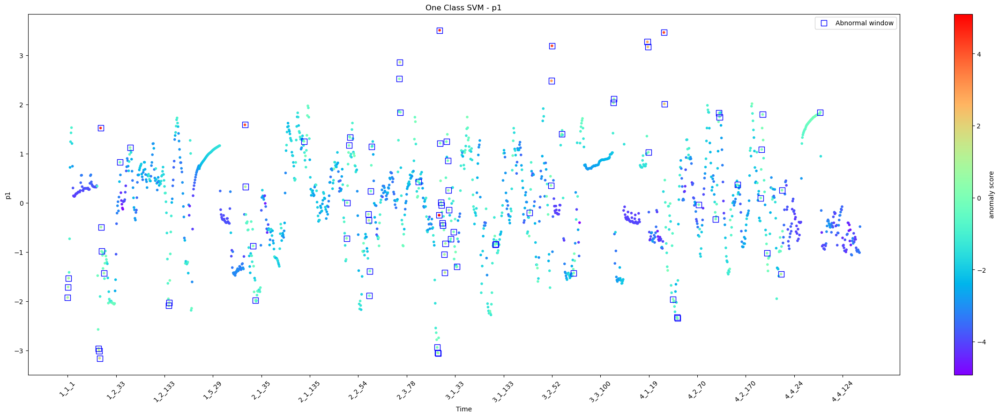

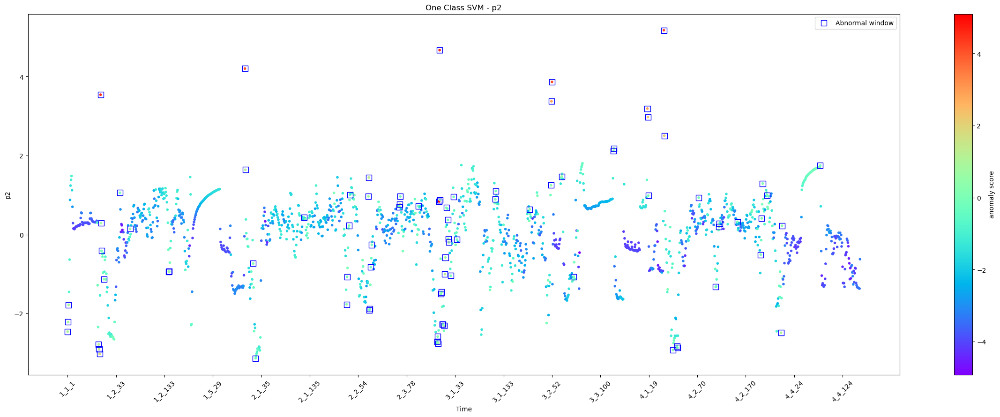

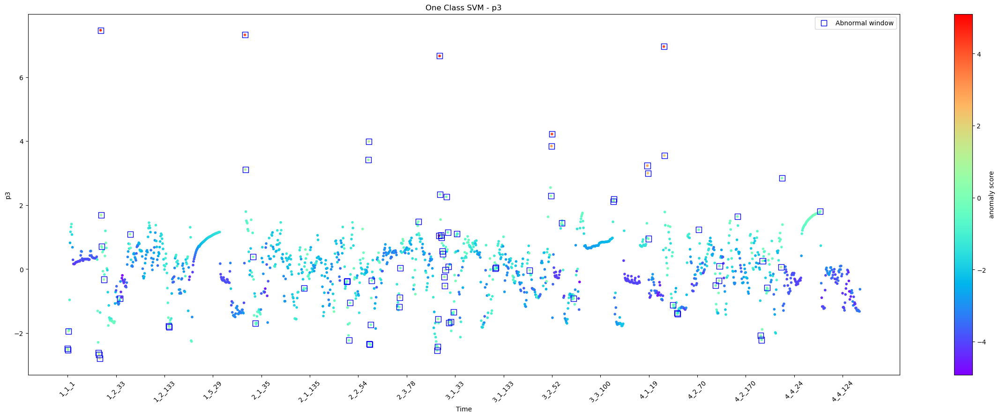

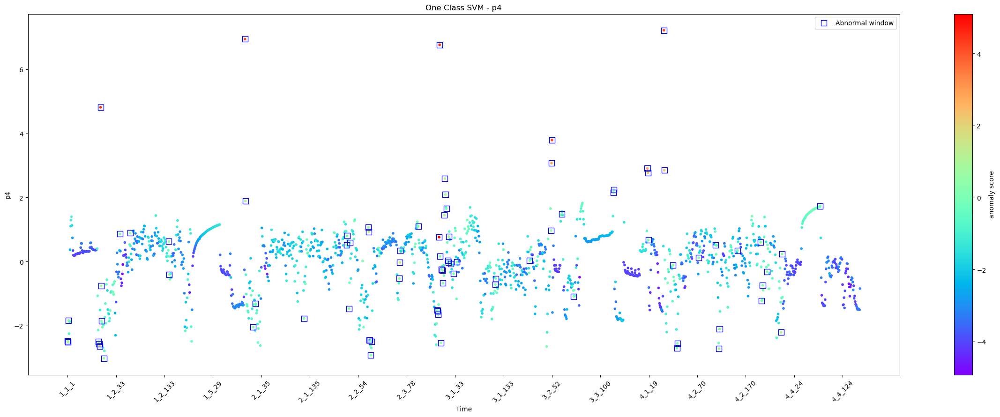

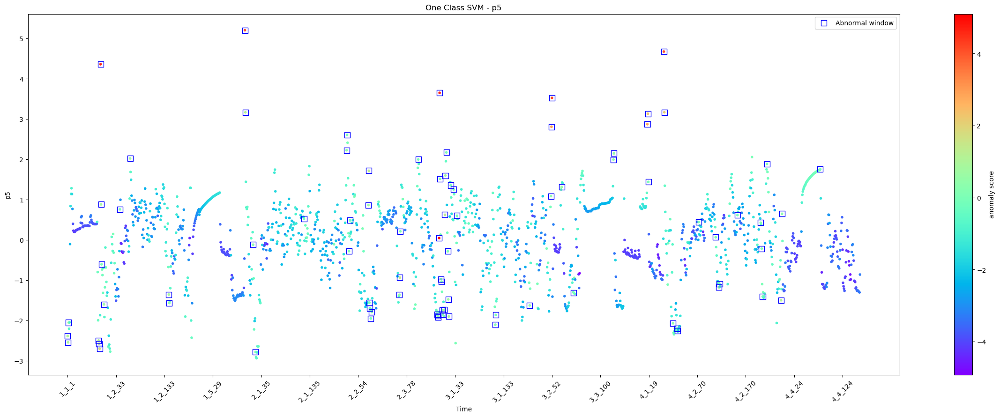

...

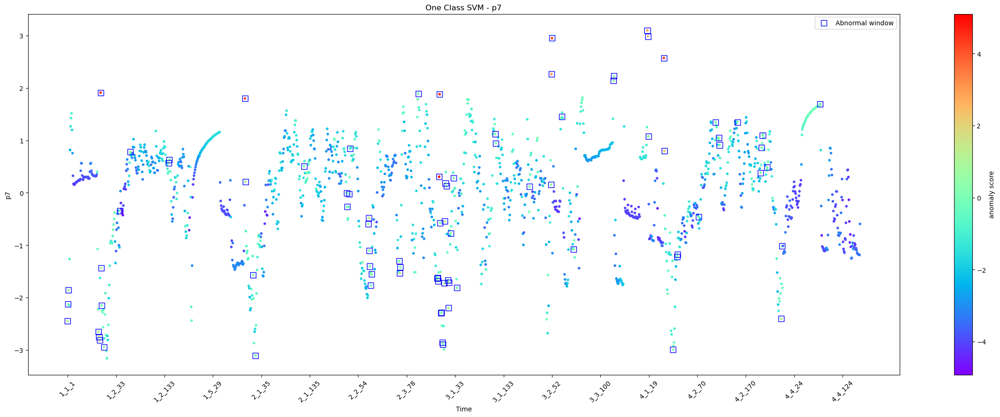

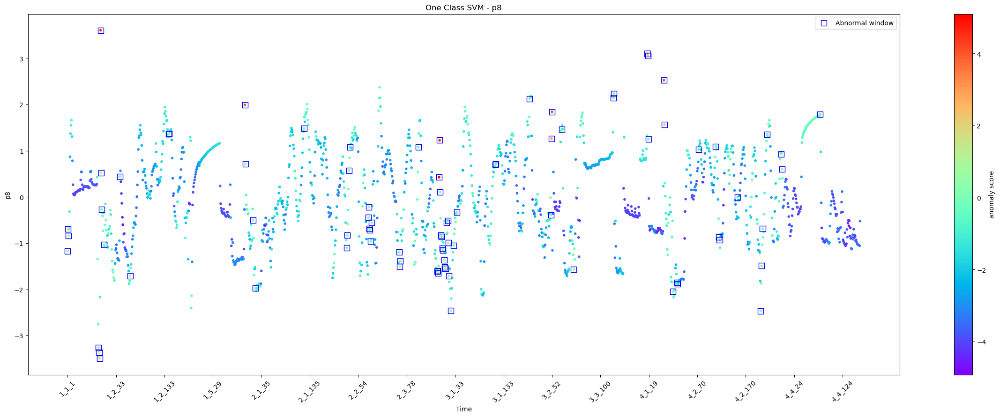

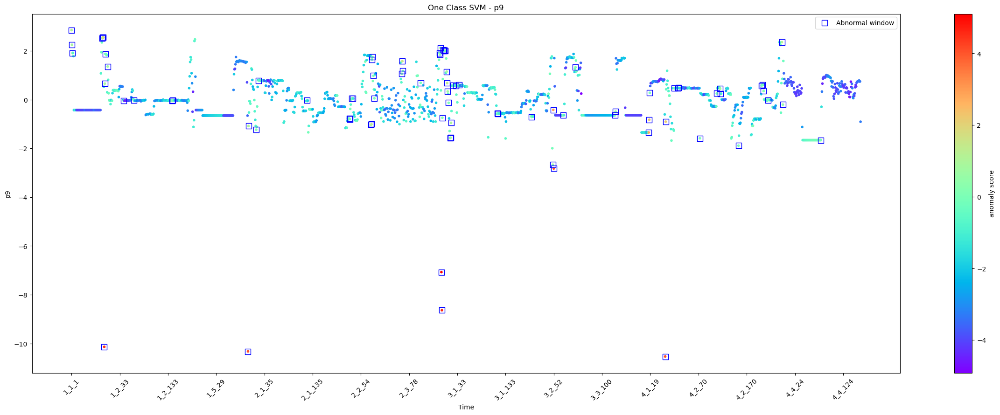

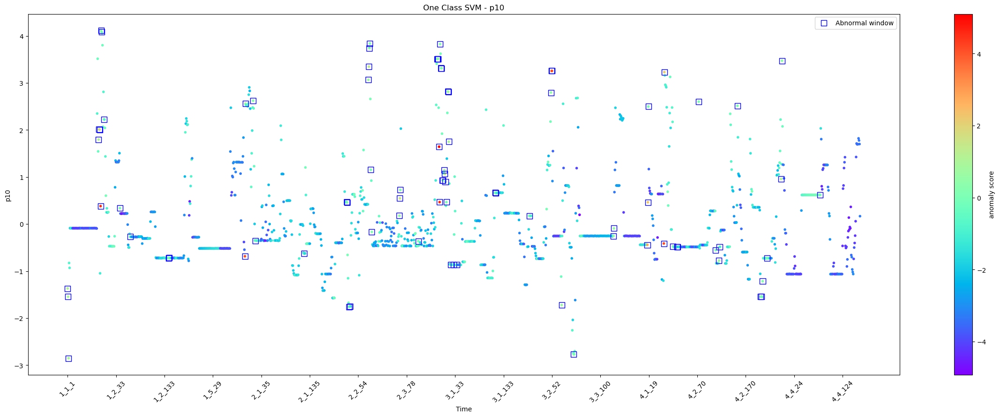

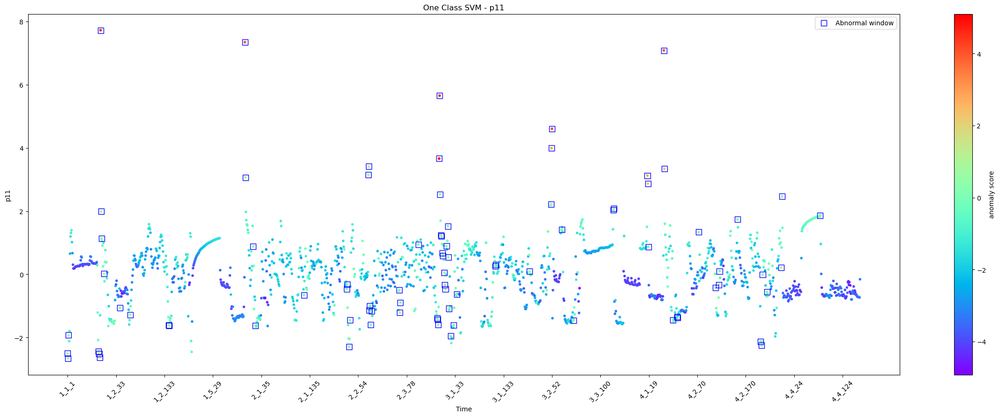

Detected abnormal windows: 83 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_65' '1_1_66' '1_1_67' '1_2_1' '1_2_2'
 '1_2_3' '1_2_8' '1_2_41' '1_2_62' '1_2_142' '1_2_143' '2_1_1' '2_1_2'
 '2_1_18' '2_1_23' '2_1_123' '2_2_30' '2_2_31' '2_2_35' '2_2_37' '2_2_75'
 '2_2_76' '2_3_1' '2_3_2' '2_3_4' '2_3_6' '2_3_63' '2_3_64' '2_3_65'
 '2_3_102' '2_3_141' '2_3_142' '2_3_143' '2_3_145' '3_1_1' '3_1_2' '3_1_4'
 '3_1_5' '3_1_7' '3_1_8' '3_1_11' '3_1_12' '3_1_13' '3_1_15' '3_1_18'
 '3_1_19' '3_1_20' '3_1_24' '3_1_30' '3_1_37' '3_1_116' '3_1_117' '3_2_6'
 '3_2_50' '3_2_51' '3_2_52' '3_3_20' '3_3_45' '3_3_127' '3_3_128' '4_1_16'
 '4_1_17' '4_1_18' '4_2_1' '4_2_2' '4_2_20' '4_2_28' '4_2_29' '4_2_73'
 '4_2_108' '4_2_115' '4_2_116' '4_2_153' '4_3_20' '4_3_22' '4_3_24'
 '4_3_33' '4_3_62' '4_3_64' '4_4_78']


DETECTING ANOMALIES WITH PCA...



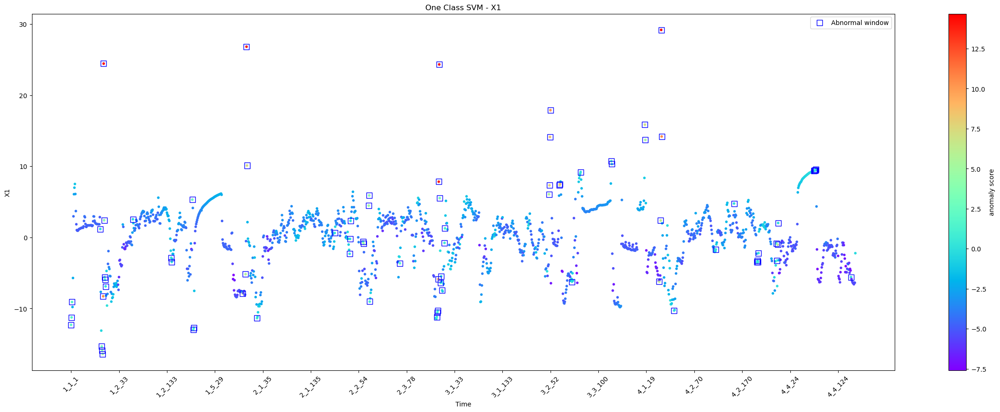

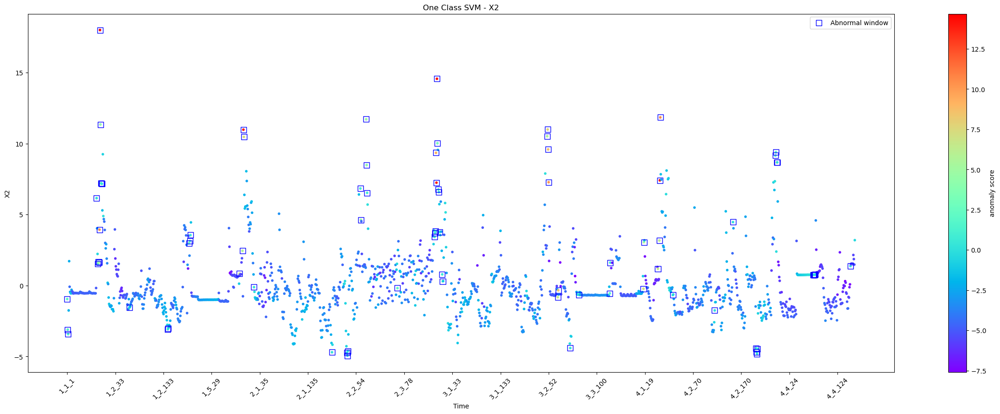

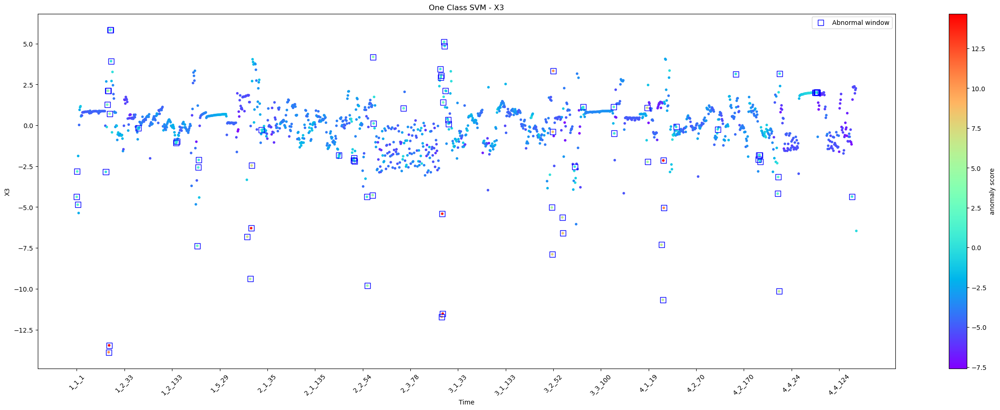

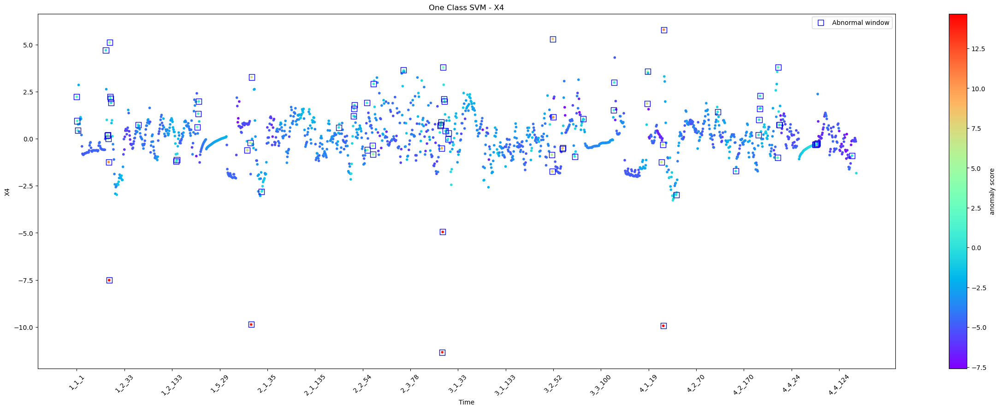

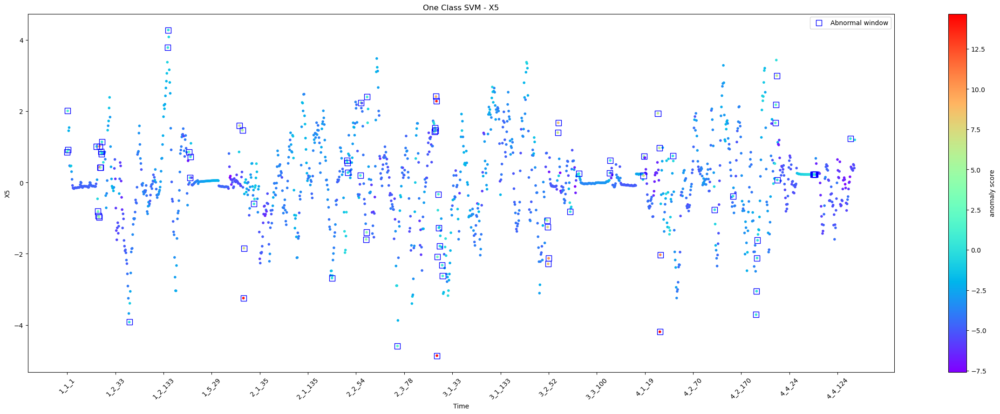

...

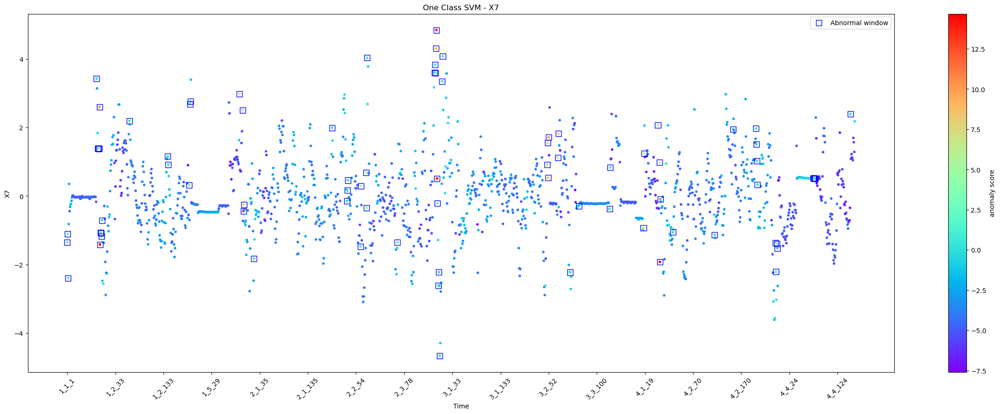

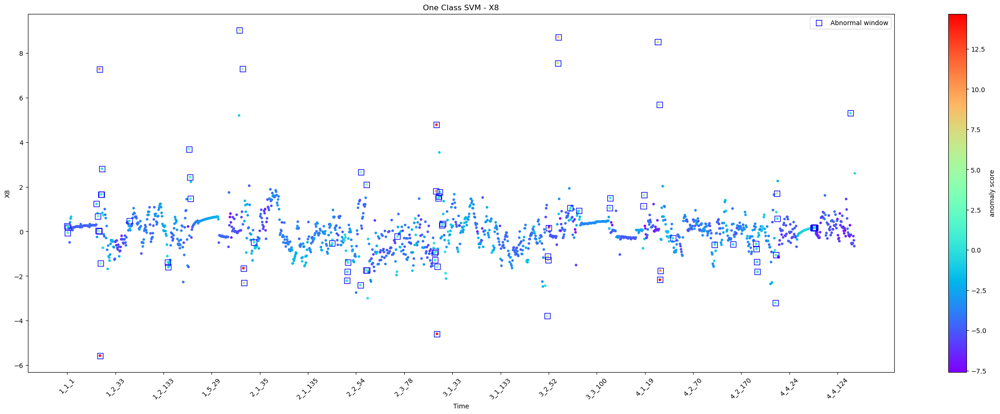

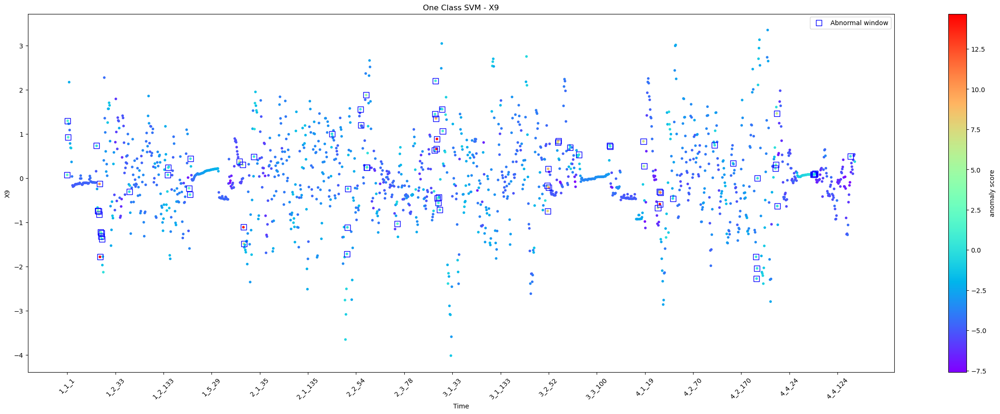

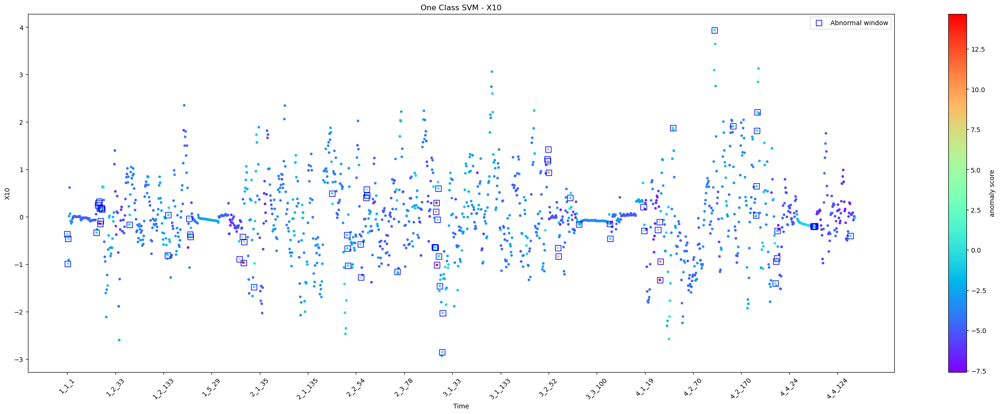

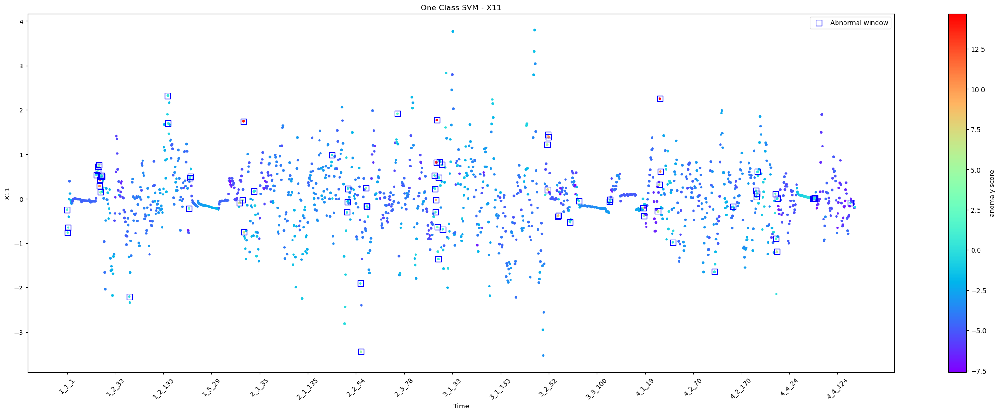

Detected abnormal windows: 79 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_62' '1_1_65' '1_1_66' '1_1_67' '1_1_68'
 '1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_62' '1_2_142' '1_2_143'
 '1_3_5' '1_4_1' '1_4_2' '1_5_87' '1_5_93' '2_1_1' '2_1_2' '2_1_23'
 '2_2_4' '2_2_35' '2_2_36' '2_2_37' '2_2_63' '2_2_64' '2_2_75' '2_2_76'
 '2_3_1' '2_3_64' '2_3_141' '2_3_142' '2_3_143' '2_3_144' '2_3_145'
 '3_1_1' '3_1_2' '3_1_4' '3_1_5' '3_1_7' '3_1_12' '3_1_13' '3_2_49'
 '3_2_50' '3_2_51' '3_2_52' '3_3_19' '3_3_20' '3_3_45' '3_3_63' '3_3_127'
 '3_3_128' '4_1_16' '4_1_17' '4_1_46' '4_1_49' '4_2_1' '4_2_2' '4_2_28'
 '4_2_115' '4_2_153' '4_3_20' '4_3_21' '4_3_22' '4_3_23' '4_3_60' '4_3_61'
 '4_3_63' '4_3_64' '4_4_74' '4_4_75' '4_4_76' '4_4_77' '4_4_78' '4_4_151']


COMPARING THE METHODS...



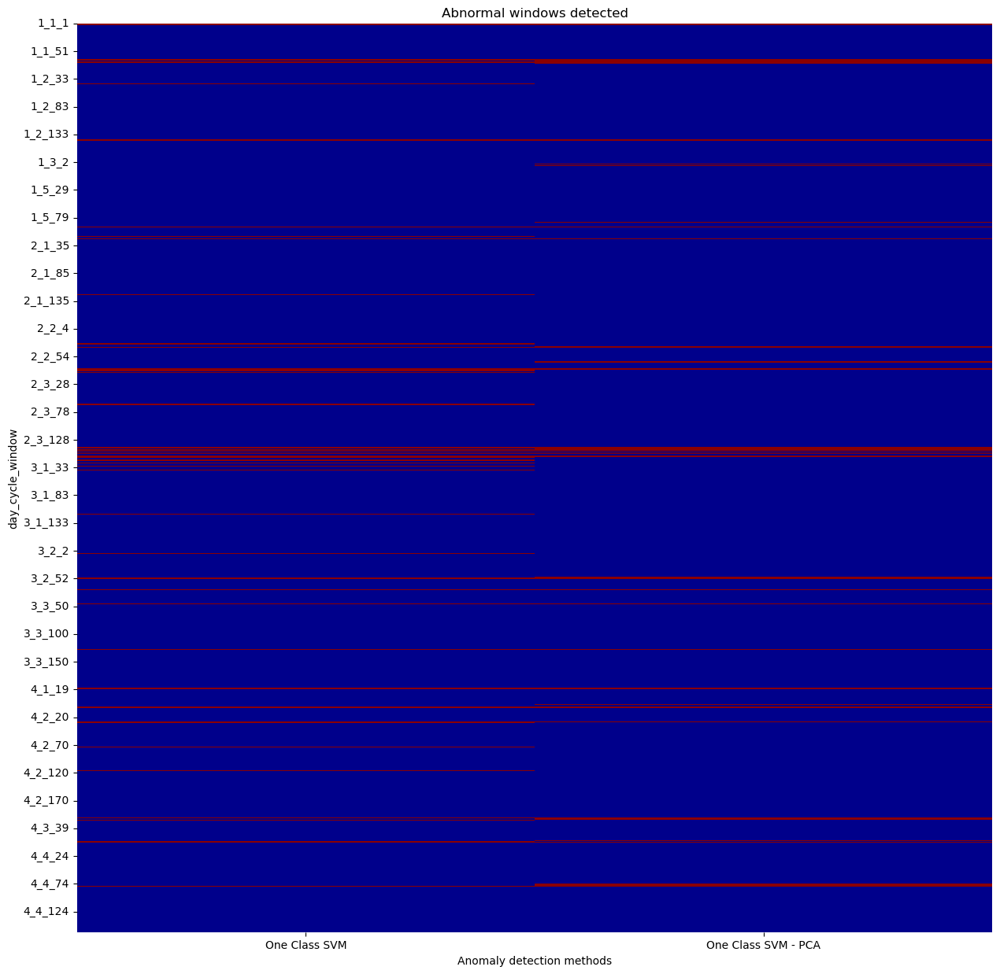

In [17]:
clf_name = 'One Class SVM'
clf = OneClassSVM(nu=0.05, kernel="rbf", gamma='auto')
clf_pca = OneClassSVM(nu=0.05, kernel="rbf", gamma=0.01)
is_anomaly_oneclasssvm, is_anomaly_oneclasssvm_pca = pca_comparaison(clf_name,clf,df_means,parameters,df_pca,pca_components_kept,clf_pca)

In [18]:
# This code will give you the day_cycle_window values that are common to the anomalies detected by both approaches.
common_anomalies_oneclasssvm = np.intersect1d(df_means['day_cycle_window'][is_anomaly_oneclasssvm == -1],df_pca['day_cycle_window'][is_anomaly_oneclasssvm_pca == -1])
print(f"{len(common_anomalies_oneclasssvm)} windows are detected as anomalies by both approaches, when {clf_name} method is used. Here there are :\n{common_anomalies_oneclasssvm}")

50 windows are detected as anomalies by both approaches, when One Class SVM method is used. Here there are :
['1_1_1' '1_1_2' '1_1_3' '1_1_65' '1_1_66' '1_1_67' '1_2_1' '1_2_142'
 '1_2_143' '1_2_2' '1_2_3' '1_2_62' '2_1_1' '2_1_2' '2_1_23' '2_2_35'
 '2_2_37' '2_2_75' '2_2_76' '2_3_1' '2_3_141' '2_3_142' '2_3_143'
 '2_3_145' '2_3_64' '3_1_1' '3_1_12' '3_1_13' '3_1_2' '3_1_4' '3_1_5'
 '3_1_7' '3_2_50' '3_2_51' '3_2_52' '3_3_127' '3_3_128' '3_3_20' '3_3_45'
 '4_1_16' '4_1_17' '4_2_1' '4_2_115' '4_2_153' '4_2_2' '4_2_28' '4_3_20'
 '4_3_22' '4_3_64' '4_4_78']


We observe that **61% of the abnormal windows with the "average windows approach", keep being considered as anomalies with the "extra statistical features approach"**. Moreover, the anomalies seem less dispersed compared to the "average windows approach". Is this an indication that averaging the parameters on each windows allows the detection of most anomalies ? An in-depth analysis of the results from the expert is needed to answer properly.

### Comparing the methods

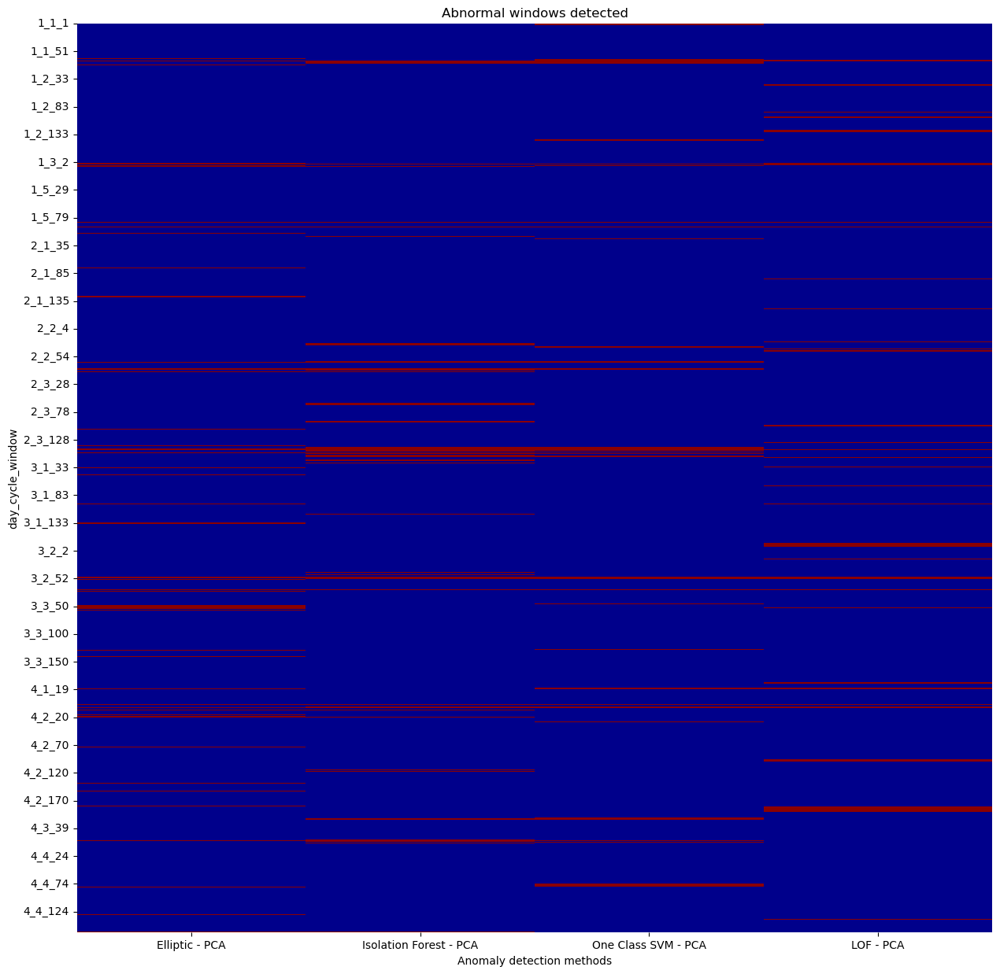

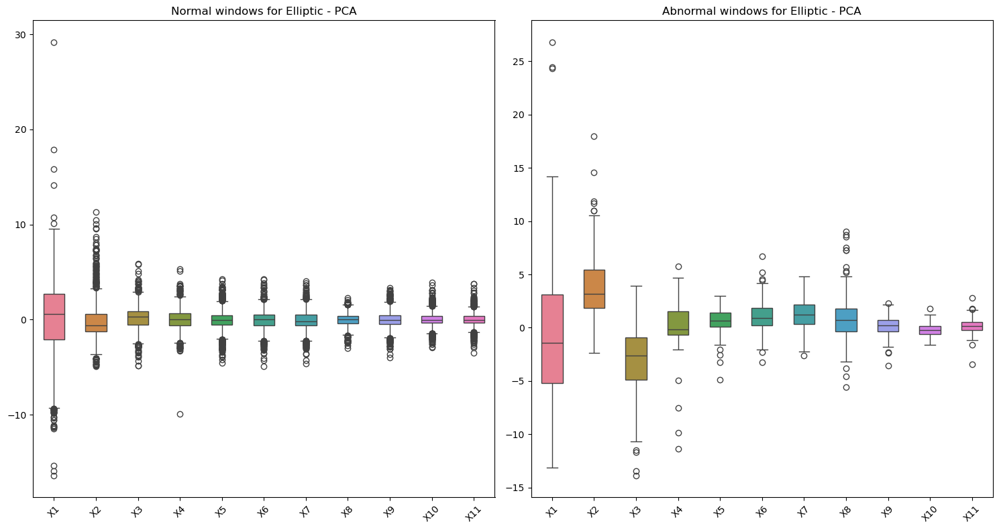

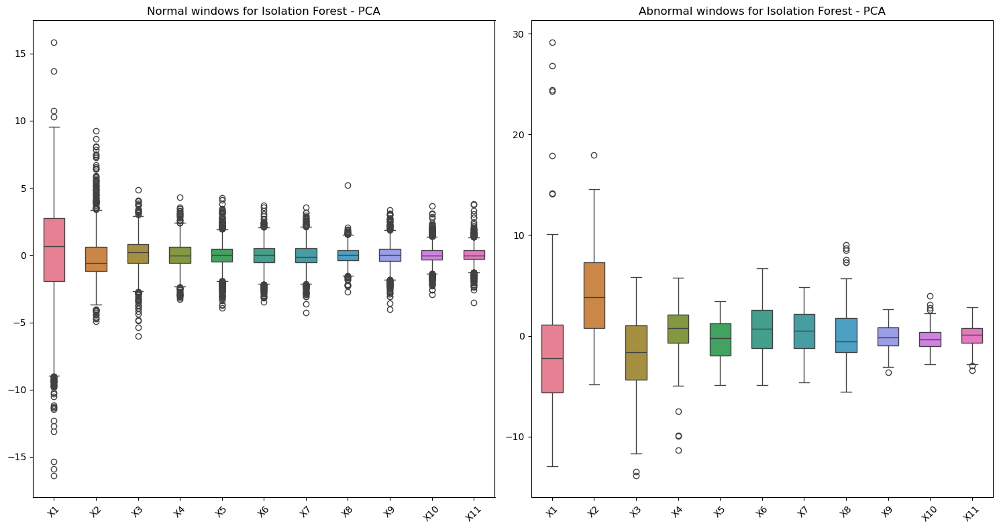

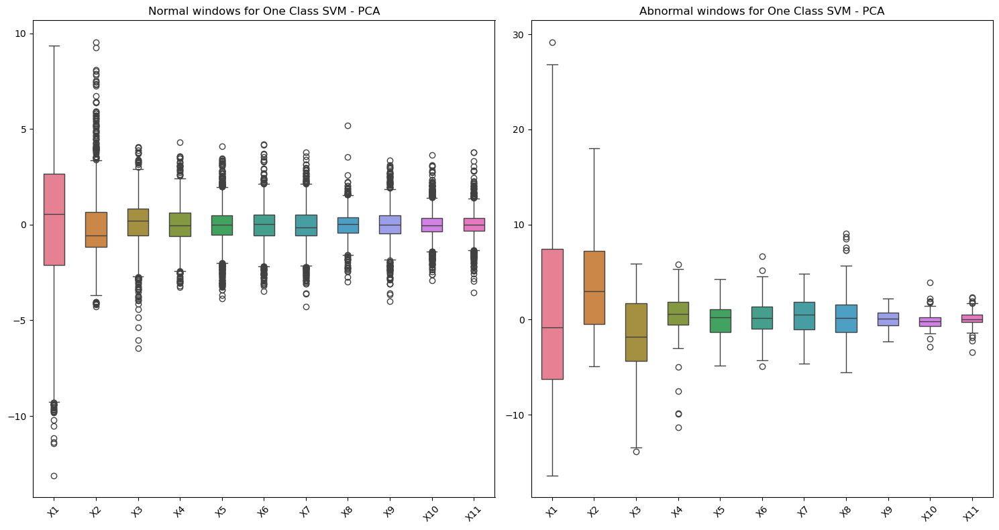

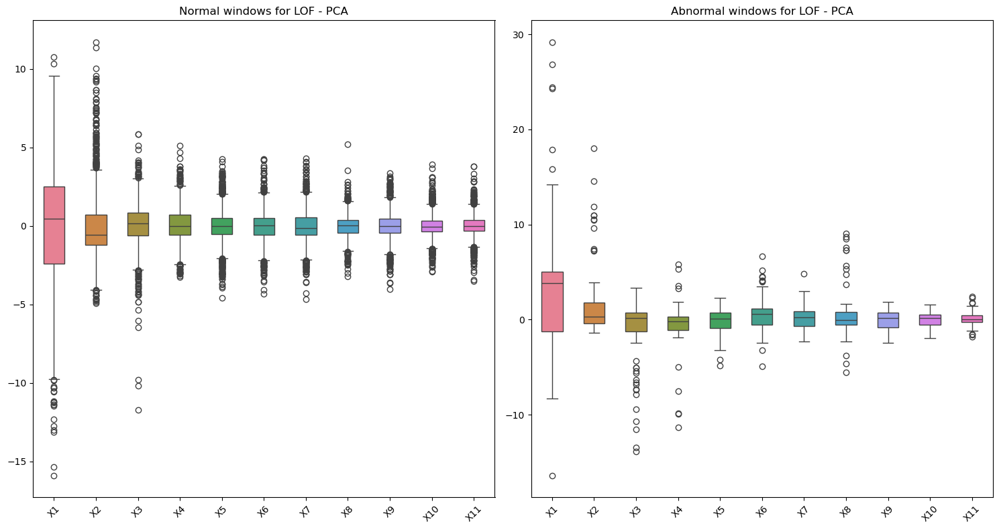

In [24]:
# Tested methods
detected_anomalies_by_method = {
    'Elliptic - PCA': is_anomaly_elliptic_pca,
    'Isolation Forest - PCA': is_anomaly_isoforest_pca,
    'One Class SVM - PCA': is_anomaly_oneclasssvm_pca,
    'LOF - PCA': is_anomaly_lof_pca
}

# Creating dataframe with the results
df_anomalies_pca = pd.DataFrame(detected_anomalies_by_method)

# Displaying method comparaison with a heat map (red line = outlier detected)
plt.figure(figsize=(15, 15))
cmap = ListedColormap(['darkred', 'darkblue'])
sns.heatmap(df_anomalies, cmap=cmap, cbar=False)
plt.title("Abnormal windows detected")
step = 50
ticks_to_display = range(0, len(df_anomalies), step)
labels_to_display = df_means['day_cycle_window'][ticks_to_display]
plt.yticks(ticks=ticks_to_display, labels=labels_to_display, rotation=0)
plt.xlabel("Anomaly detection methods")
plt.ylabel("day_cycle_window")
plt.show()

# Loop through each tested method
for method in detected_anomalies_by_method.keys():
    # Get the anomaly detection results for the current method
    anomalies = df_anomalies_pca[method]
    
    # Create masks for normal and abnormal windows
    normal_windows = df_pca[anomalies == 1]  # Windows classified as normal
    abnormal_windows = df_pca[anomalies == -1]  # Windows classified as anomalous
    
    # Plotting boxplots for each method
    plt.figure(figsize=(15, 8))
    
    # Plot boxplot for normal windows
    plt.subplot(1, 2, 1)  # 1 row, 2 columns, 1st plot
    sns.boxplot(data=normal_windows[pca_components_kept], width=0.5)
    plt.title(f'Normal windows for {method}')
    plt.xticks(rotation=45)
    
    # Plot boxplot for abnormal windows
    plt.subplot(1, 2, 2)  # 1 row, 2 columns, 2nd plot
    sns.boxplot(data=abnormal_windows[pca_components_kept], width=0.5)
    plt.title(f'Abnormal windows for {method}')
    plt.xticks(rotation=45)
    
    plt.tight_layout()
    plt.show()

In [20]:
common_anomalies_pca = np.intersect1d(df_pca['day_cycle_window'][is_anomaly_elliptic_pca == -1],np.intersect1d(df_pca['day_cycle_window'][is_anomaly_isoforest_pca == -1],np.intersect1d(df_pca['day_cycle_window'][is_anomaly_lof_pca == -1],df_pca['day_cycle_window'][is_anomaly_oneclasssvm_pca == -1])))
print(f"""{len(common_anomalies_pca)} windows are detected as anomalies by both methods, when "Extra Statistical Features" approach is used. Here there are :\n{common_anomalies_pca}""")

16 windows are detected as anomalies by both methods, when "Extra Statistical Features" approach is used. Here there are :
['1_1_68' '1_2_1' '1_3_5' '1_5_87' '1_5_93' '2_1_1' '2_3_145' '3_1_1'
 '3_2_49' '3_2_50' '3_3_19' '3_3_20' '4_1_46' '4_1_49' '4_2_2' '4_4_151']


# Analysis of Anomaly Detection Results Using PCA with Extended Features

#### Observations

1. **Elliptic Envelope with PCA**: The use of PCA helps align the data closer to the assumption of multivariate Gaussian distributions. However, its results are quite different from the "average window approach".

2. **Isolation Forest with PCA**: The tree-based structure leverages PCA-transformed features to isolate sparse, distinct data points, especially across distributed and isolated windows effectively. Additionnaly, it keeps some consistency with the "average window approach".

3. **One-Class SVM with PCA**: It shows broader anomaly detection, with significant detection clusters for certain blocks. The RBF kernel, combined with the extended feature set, likely captures nuanced deviations more effectively. Additionnaly, it keeps higher consistency with the "average window approach".

4. **Local Outlier Factor (LOF) with PCA**: LOF exhibits its strength in detecting localized anomalies. The PCA-transformed features amplify its ability to identify anomalies in specific high-dimensional neighborhoods. Paradoxically, it keeps again higher consistency with the "average window approach". This questions either the relevance of using all these features or the importance of the average features by window within this approach.

#### Comments on the results

- **Feature-Rich Input**: Unlike the initial approach, this analysis considers not only the mean values but also other statistical parameters (e.g., standard deviation, median, min, max) for each window. By preprocessing the data (removing low-variance and highly correlated features) and applying PCA, the dataset is reduced to principal components that capture the most variance.

- **Diversity in Anomaly Detection**: The results reveal noticeable differences in the detected anomalies across the four methods (Elliptic Envelope, Isolation Forest, One-Class SVM, and LOF). Incorporating more statistical features likely highlights subtler variations in the data, which may not have been evident in the earlier, simpler feature set.

- **Impact of PCA**: PCA reduces dimensionality while retaining most of the variance, which can enhance the performance of certain models (e.g., LOF and One-Class SVM) by simplifying their search for anomalies. However, models like Elliptic Envelope remain sensitive to how well the PCA-reduced data aligns with their distributional assumptions.

- **Increased Anomaly Sensitivity**: The inclusion of additional statistical features provides more context for identifying outliers. This likely explains the increase in detected anomalies compared to the mean-only approach.

#### Recommendations

- **Combine Results**: Leverage the outputs of multiple methods to identify consistently detected anomalies. This ensures robustness and reduces the impact of method-specific biases.
  
- **Refine Preprocessing**: Experiment with PCA parameters (e.g., number of components) and feature selection thresholds to assess their impact on anomaly detection.

- **Evaluate Context**: Investigate detected anomalies in the context of the extended feature set to ensure their meaningfulness and relevance.

#### Conclusion
The use of extended features and PCA enhances the detection of anomalies by providing more information to the algorithms. However, the variability in results across methods underscores the importance of combining techniques to achieve a comprehensive analysis.
